## **EXP1 Predicting Missing Cell-Types from Bulks using Non-Negative Least Squares Regression Residual**

*This file includes EXP1 analysis and results. Files used were created in preprocessing/EXP1_pseudos notebook.*

**Summary:**
Increasing the number of missing celltypes, using random proportions pseudobulks. Then attempting to extract missing cell type information from residual. 

The residual is calculated in three different ways named: Residual (comparing NNLS calculated proportions to pseudobulks), Residual_diffbase (using different baseline being comapred to), and Residual_realref (using a "real" reference profile for cell lines).

This specific notebook uses only 5 cell types, with NO noise added in pseudobulks. 

**Hypothesis:**
Deleting cell types from NNLS reference will create a residual from which we can extract missing cell type information. 

**Deconv. Method:**
NNLS

**Factorization Methods:**
SVD, PCA, ICA, NMF

In [1]:
# import the dependencies
import sys
sys.path.insert(1, '../../')
sys.path.insert(1, '../')
sys.path.insert(1, '../../../../../')

from functions import sn_sc_preprocess
from functions import validation_processing as vp
from importlib import reload
reload(sn_sc_preprocess)
reload(vp)
# general imports
import warnings
import numpy as np
from numpy import random
from numpy import array
from numpy import diag
from numpy import dot
from numpy import zeros
import pandas as pd
import scanpy as sc
from anndata import AnnData as ad
from tabulate import tabulate

import tensorflow as tf
import sklearn as sk
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import FunctionTransformer
import scipy as sp
from scipy.stats import spearmanr, pearsonr
from scipy.sparse import coo_matrix
from scipy.sparse import csr_matrix
import scipy.stats as stats
from collections import Counter
import scipy as sp
from scipy.optimize import nnls
from scipy.stats import ttest_ind
# Images, plots, display, and visualization
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
import seaborn as sns
from openTSNE import TSNE
from openTSNE import TSNEEmbedding
from openTSNE import affinity
from openTSNE import initialization
#sklearns
from sklearn.decomposition import FastICA
from sklearn.decomposition import NMF
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
#from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import scale
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import adjusted_rand_score
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.decomposition import TruncatedSVD
from sklearn.ensemble import RandomForestClassifier

# programming stuff
import time
import os, sys
import pickle
from pathlib import Path

In [2]:
#####################
### set the study ###
#####################
#paths:
res_name = "MCT_snadp_EXP1"
pseudo_name = "MCT_snadp_EXP1_5CTallnoise"
actual_path = os.getcwd()
path = f"{actual_path}/../data/EXP1/"
aug_data_path = f"{actual_path}/../data/EXP1/"
cibersort_path = f"{actual_path}/../data/EXP1/cibersort/CIBERSORTx_Job1_EXP1_randomprop_pt0_cibersort_signatmat_inferred_phenoclasses.CIBERSORTx_Job1_EXP1_randomprop_pt0_cibersort_signatmat_inferred_refsample.bm.K999.txt"

###### set your random seed, num missing cells, and num_samples for reference for reproducibility
random_seed = 42
num_missing_cells = [0, 1, 2, 3]
num_samples = 10000

Import the previously processed datasets. 

*See preprocessing/EXP1_pseudos.ipynb notebook for details.*

In [3]:
#and as anndata object
adata_path = os.path.join(aug_data_path, f"{res_name}_adata_notlog.h5ad")
adata_path = Path(adata_path)
sn_adata = sc.read_h5ad(adata_path)
sn_adata

AnnData object with n_obs × n_vars = 122808 × 28518
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'cell_types'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_var_genes'

In [4]:
#excluding all cell types except 5 of interest
exclude = ['preadipocyte',
    'mesothelial cell',
    'pericyte cell',
    'fat cell',
    'endothelial cell',
    'endothelial cell of lymphatic vessel',
    'smooth muscle cell',
    'mast cell',
    'immature NK T cell',
    'stromal cell of endometrium',
    'neutrophil']
sn_adata = sn_adata[~sn_adata.obs["cell_types"].isin(exclude), :]
#Tilde is “not”, so this reads like “var names that are not in exclude”
print(Counter(sn_adata.obs["cell_types"]))

# define the number of cells and the list of missing cell counts
num_cells = len(sn_adata.obs.cell_types.unique())
cell_order = sn_adata.obs.cell_types.unique()

Counter({'macrophage': 14543, 'T cell': 3629, 'monocyte': 820, 'dendritic cell': 764, 'B cell': 272})


Randomly selecting cells to delete:

In [5]:
cells_to_miss = sn_sc_preprocess.select_cells_missing(sn_adata, num_missing_cells, random_seed)
cells_to_miss

{1: [1], 2: [1, 2], 3: [0, 1, 2]}

## Creating reference profiles and Importing Bulks:


1. ref_raw is the sum of each gene expression per num_samples of each cell type. This is not scaled (raw). Once it is clipped and scaled with MinMax(), it becomes:
2. ref_df, which is used in NNLS. 
3. ref_av is the reference for each cell type as the average expression per gene. This is then MinMax() scaled. It is calculated to see if the average expression per cell type can be correlated to residual, instead of the "sum" expression like the others.

In [6]:
# Making cell type reference without scaling
cell_types = sn_adata.obs["cell_types"].unique()
gene_ids = sn_adata.var["gene_ids"]
ref_raw = pd.DataFrame(index = gene_ids, columns = cell_types)
for cell_type in cell_types:
    cell_df = sn_adata[sn_adata.obs["cell_types"].isin([cell_type])]
    cell_sample = sk.utils.resample(cell_df, n_samples = num_samples, replace=True)
    x = cell_sample.X.sum(axis=0)
    sum_over_genes = pd.DataFrame(x).T
    #and save to df dict
    ref_raw[cell_type] = sum_over_genes.values
ref_raw

,macrophage,T cell,dendritic cell,B cell,monocyte
gene_ids,,,,,
A1BG,121.0,125.0,227.0,73.0,104.0
A1BG-AS1,401.0,322.0,635.0,338.0,362.0
A1CF,10.0,18.0,25.0,0.0,0.0
A2M,10535.0,11338.0,9105.0,2252.0,2109.0
A2M-AS1,97.0,1368.0,104.0,253.0,63.0
...,...,...,...,...,...
PLA2G1B,0.0,0.0,0.0,0.0,0.0
SERPINB13,2.0,0.0,0.0,0.0,0.0
SLC17A2,0.0,0.0,0.0,0.0,0.0


In [7]:
# Making cell type reference with just average
cell_types = sn_adata.obs["cell_types"].unique()
gene_ids = sn_adata.var["gene_ids"]
ref_av = pd.DataFrame(index = gene_ids, columns = cell_types)
for cell_type in cell_types:
    
    cell_sample = sn_adata[sn_adata.obs["cell_types"].isin([cell_type])]
    x = cell_sample.X.mean(axis=0)
    sum_over_genes = pd.DataFrame(x).T

    #and save to df dict
    ref_av[cell_type] = sum_over_genes.values
ref_av

,macrophage,T cell,dendritic cell,B cell,monocyte
gene_ids,,,,,
A1BG,0.011277,0.013227,0.019634,0.007353,0.009756
A1BG-AS1,0.038231,0.031414,0.061518,0.033088,0.040244
A1CF,0.000894,0.001653,0.002618,0.000000,0.000000
A2M,1.049828,1.163954,0.908377,0.220588,0.207317
A2M-AS1,0.010452,0.144117,0.011780,0.025735,0.006098
...,...,...,...,...,...
PLA2G1B,0.000000,0.000000,0.000000,0.000000,0.000000
SERPINB13,0.000069,0.000000,0.000000,0.000000,0.000000
SLC17A2,0.000000,0.000000,0.000000,0.000000,0.000000


In [8]:
#clippign before scaling to 95th pecentile
ref_av_val = ref_av.values
clip_upper = np.quantile(ref_av_val, 0.95)
ref_av_val = np.clip(ref_av_val, 0, clip_upper)
ref_av = pd.DataFrame(ref_av_val,index = gene_ids, columns = cell_types)
#and scaling to be between values 0 and 1 to use for NNLS
scaler = MinMaxScaler()
scaler.fit(ref_av_val)
ref_av = scaler.transform(ref_av_val)
ref_av = pd.DataFrame(ref_av_val, index = gene_ids, columns = cell_types)
ref_av

,macrophage,T cell,dendritic cell,B cell,monocyte
gene_ids,,,,,
A1BG,0.011277,0.013227,0.019634,0.007353,0.009756
A1BG-AS1,0.038231,0.031414,0.061518,0.033088,0.040244
A1CF,0.000894,0.001653,0.002618,0.000000,0.000000
A2M,0.443851,0.443851,0.443851,0.220588,0.207317
A2M-AS1,0.010452,0.144117,0.011780,0.025735,0.006098
...,...,...,...,...,...
PLA2G1B,0.000000,0.000000,0.000000,0.000000,0.000000
SERPINB13,0.000069,0.000000,0.000000,0.000000,0.000000
SLC17A2,0.000000,0.000000,0.000000,0.000000,0.000000


In [9]:
#clippign before scaling to 95th pecentile
ref_raw_val = ref_raw.values
clip_upper = np.quantile(ref_raw_val, 0.95)
ref_raw_val = np.clip(ref_raw_val, 0, clip_upper)
#and scaling to be between values 0 and 1 to use for NNLS
scaler = MinMaxScaler()
scaler.fit(ref_raw_val)
ref_df = scaler.transform(ref_raw_val)
ref_df = pd.DataFrame(ref_df, index = gene_ids, columns = cell_types)
ref_raw = pd.DataFrame(ref_raw_val, index = gene_ids, columns = cell_types)
ref_df

,macrophage,T cell,dendritic cell,B cell,monocyte
gene_ids,,,,,
A1BG,0.027139,0.028036,0.050913,0.016373,0.023326
A1BG-AS1,0.089940,0.072221,0.142423,0.075809,0.081192
A1CF,0.002243,0.004037,0.005607,0.000000,0.000000
A2M,1.000000,1.000000,1.000000,0.505097,0.473024
A2M-AS1,0.021756,0.306826,0.023326,0.056745,0.014130
...,...,...,...,...,...
PLA2G1B,0.000000,0.000000,0.000000,0.000000,0.000000
SERPINB13,0.000449,0.000000,0.000000,0.000000,0.000000
SLC17A2,0.000000,0.000000,0.000000,0.000000,0.000000


Importing Bulks:

In [10]:
#each pseudo file has:
## realisitc*200, cell_type_specific*1000*, random*200, equal*200
#so here we're defining the ranges to extract the bulks of choice.
bulk_range = dict()
bulk_range["realistic"] = range(0,200)
bulk_range["cell_type_specific"] = range(200,(50*num_cells)+200) #1000
bulk_range["random"] = range((50*num_cells)+200,(50*num_cells)+400) #1200
bulk_range["equal"] = range((50*num_cells)+400,(50*num_cells)+600) #1400

In [11]:
#importing bulks to deconvolve
##select_bulks(bulk_type, num_bulks_touse, num_idx_total, res_name, path)
prop_df, pseudo_df = vp.select_bulks('random', 100, 10, pseudo_name, aug_data_path, bulk_range)
pseudo_df

gene_ids,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2ML1-AS1,A3GALT2,A4GALT,A4GNT,...,HIST1H3I,LINC01972,LINC02393,NCCRP1,PAEP,PLA2G1B,SERPINB13,SLC17A2,TBC1D3B,Z82186.1
0,106,284,1,2626,81,95,117,15,155,0,...,0,0,0,0,1,0,0,0,0,0
1,89,271,2,3543,127,76,71,15,164,0,...,0,0,0,0,0,0,0,0,0,0
2,70,270,1,1849,162,77,65,8,287,0,...,0,0,0,0,0,0,0,0,0,0
3,69,313,1,3017,143,69,72,9,159,0,...,0,0,0,0,0,0,0,0,0,0
4,84,258,1,4559,514,41,67,5,125,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,37,262,17,4490,400,38,362,40,27,4,...,0,0,0,0,0,0,0,0,0,0
996,41,252,3,2825,136,80,392,78,30,0,...,0,0,0,0,0,0,0,0,0,0
997,51,199,12,2606,130,36,454,65,25,1,...,0,0,0,0,0,0,0,0,0,0
998,35,222,8,3024,263,39,335,20,20,0,...,0,0,0,0,0,0,0,0,0,0


In [12]:
#clippign before scaling to 95th pecentile
pseudo_copy = pseudo_df.copy() #keeping genes
pseudo_df = pseudo_df.values #np array
clip_upper = np.quantile(pseudo_df, 0.95)
pseudo_df = np.clip(pseudo_df, 0, clip_upper)
#and normalize to values between 0 and 1
scaler = MinMaxScaler()
scaler.fit(pseudo_df)
normalized_pseudo_df = scaler.transform(pseudo_df)
normalized_pseudo_df = pd.DataFrame(normalized_pseudo_df, 
                            columns = pseudo_copy.columns, index= pseudo_copy.index)
normalized_pseudo_df      

gene_ids,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2ML1-AS1,A3GALT2,A4GALT,A4GNT,...,HIST1H3I,LINC01972,LINC02393,NCCRP1,PAEP,PLA2G1B,SERPINB13,SLC17A2,TBC1D3B,Z82186.1
0,0.334448,0.401493,0.013158,0.738473,0.030315,0.313531,0.036111,0.105634,0.204703,0.000000,...,0.0,0.0,0.0,0.0,0.027778,0.0,0.0,0.0,0.0,0.0
1,0.277592,0.382090,0.026316,1.000000,0.048664,0.250825,0.014815,0.105634,0.217151,0.000000,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
2,0.214047,0.380597,0.013158,0.458573,0.062625,0.254125,0.012037,0.056338,0.387275,0.000000,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
3,0.210702,0.444776,0.013158,0.879323,0.055046,0.227723,0.015278,0.063380,0.210235,0.000000,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
4,0.260870,0.362687,0.013158,1.000000,0.203032,0.135314,0.012963,0.035211,0.163209,0.000000,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.103679,0.368657,0.223684,1.000000,0.157559,0.125413,0.149537,0.281690,0.027663,0.307692,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
996,0.117057,0.353731,0.039474,0.810159,0.052254,0.264026,0.163426,0.549296,0.031812,0.000000,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
997,0.150502,0.274627,0.157895,0.731268,0.049860,0.118812,0.192130,0.457746,0.024896,0.076923,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
998,0.096990,0.308955,0.105263,0.881844,0.102912,0.128713,0.137037,0.140845,0.017981,0.000000,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0


In [13]:
# read in cibersort genes 
cibersort_df = pd.read_csv(cibersort_path, sep="\t")
cibersort_genes = cibersort_df["NAME"].values.tolist()
#and set intersection of gene_ids and cibersort:
gene_notin = np.setdiff1d(gene_ids, cibersort_genes)
#keep genes in both and check number
gene_ids = [ele for ele in gene_ids if ele not in gene_notin]
len(gene_ids)     

3307

In [14]:
#cutting to cibersort genes 
pseudo_copy  = pseudo_copy[gene_ids]
ref_raw = ref_raw.loc[gene_ids,:]
ref_df = ref_df.loc[gene_ids,:]
ref_av = ref_av.loc[gene_ids,:]
normalized_pseudo_df = normalized_pseudo_df[gene_ids]
normalized_pseudo_df

gene_ids,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8,CD79A,AC092746.1,XIST
0,0.111111,0.823715,0.636880,0.206844,1.000000,0.265398,0.135292,0.108254,0.085714,0.040603,...,0.048880,0.174370,0.083514,0.086486,0.662531,0.052442,0.130488,0.018507,0.004425,0.0
1,0.123543,0.693787,0.781181,0.129921,1.000000,0.493841,0.142546,0.179426,0.073684,0.035681,...,0.042573,0.225375,0.046638,0.085405,0.455749,0.077914,0.109756,0.024776,0.088496,0.0
2,0.165890,1.000000,0.707925,0.170503,1.000000,0.332027,0.175553,0.124103,0.096541,0.019379,...,0.059603,0.233025,0.050434,0.082162,0.483871,0.053042,0.105183,0.018806,0.247788,0.0
3,0.100622,0.721224,0.641617,0.150212,1.000000,0.336506,0.144723,0.102572,0.120902,0.034759,...,0.039735,0.261396,0.078633,0.031712,0.552523,0.063230,0.110671,0.013433,0.053097,0.0
4,0.134033,0.426679,0.520051,0.130527,1.000000,0.875700,0.159231,0.023923,0.042406,0.013534,...,0.008199,0.162257,0.044469,0.020541,0.559967,0.216062,0.078659,0.000896,0.061947,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.109169,0.642384,0.130092,0.214113,1.000000,0.531915,0.121509,0.078050,0.418647,0.189173,...,0.007884,0.256615,0.169197,0.038919,0.014061,0.009290,0.033232,0.013433,0.079646,0.0
996,0.127040,1.000000,0.163562,0.273773,0.954323,0.232923,0.163221,0.095096,1.000000,0.175946,...,0.005992,0.399426,0.195228,0.051171,0.014061,0.003296,0.060061,0.019104,0.230088,0.0
997,0.061772,0.889309,0.083675,0.231072,1.000000,0.282755,0.107363,0.080443,0.513985,0.156567,...,0.016399,0.281160,0.131236,0.040360,0.011580,0.006593,0.028659,0.020896,0.070796,0.0
998,0.113831,0.641123,0.161351,0.172017,0.744942,0.507839,0.116794,0.164175,0.487820,0.144263,...,0.036897,0.252789,0.116594,0.030270,0.007444,0.010189,0.031098,0.030448,0.039823,0.0


TSNEs of Pseuboulks and References:

===> Finding 180 nearest neighbors using Annoy approximate search using euclidean distance...
   --> Time elapsed: 0.84 seconds
===> Calculating affinity matrix...
   --> Time elapsed: 0.01 seconds
===> Running optimization with exaggeration=1.00, lr=1000.00 for 500 iterations...
Iteration   50, KL divergence 0.2368, 50 iterations in 0.2445 sec
Iteration  100, KL divergence 0.1859, 50 iterations in 0.2184 sec
Iteration  150, KL divergence 0.1711, 50 iterations in 0.3132 sec
Iteration  200, KL divergence 0.1616, 50 iterations in 0.3946 sec
Iteration  250, KL divergence 0.1557, 50 iterations in 0.3810 sec
Iteration  300, KL divergence 0.1512, 50 iterations in 0.4857 sec
Iteration  350, KL divergence 0.1471, 50 iterations in 0.4806 sec
Iteration  400, KL divergence 0.1446, 50 iterations in 0.4790 sec
Iteration  450, KL divergence 0.1425, 50 iterations in 0.5335 sec
Iteration  500, KL divergence 0.1415, 50 iterations in 0.5990 sec
   --> Time elapsed: 4.13 seconds
===> Finding 15 nearest n

Perplexity value 60 is too high. Using perplexity 1.33 instead


Iteration  100, KL divergence 32.1598, 50 iterations in 0.0157 sec
Iteration  150, KL divergence 31.9987, 50 iterations in 0.0139 sec
Iteration  200, KL divergence 31.9158, 50 iterations in 0.0142 sec
Iteration  250, KL divergence 31.8513, 50 iterations in 0.0141 sec
   --> Time elapsed: 0.07 seconds
===> Finding 4 nearest neighbors using exact search using euclidean distance...
   --> Time elapsed: 0.00 seconds
===> Calculating affinity matrix...
   --> Time elapsed: 0.00 seconds
===> Running optimization with exaggeration=1.00, lr=5.00 for 500 iterations...
Iteration   50, KL divergence 0.0274, 50 iterations in 0.1985 sec
Iteration  100, KL divergence 0.0288, 50 iterations in 0.1948 sec
Iteration  150, KL divergence 0.0328, 50 iterations in 0.1983 sec
Iteration  200, KL divergence 0.0314, 50 iterations in 0.1921 sec
Iteration  250, KL divergence 0.0306, 50 iterations in 0.1931 sec
Iteration  300, KL divergence 0.0313, 50 iterations in 0.1932 sec
Iteration  350, KL divergence 0.0270, 

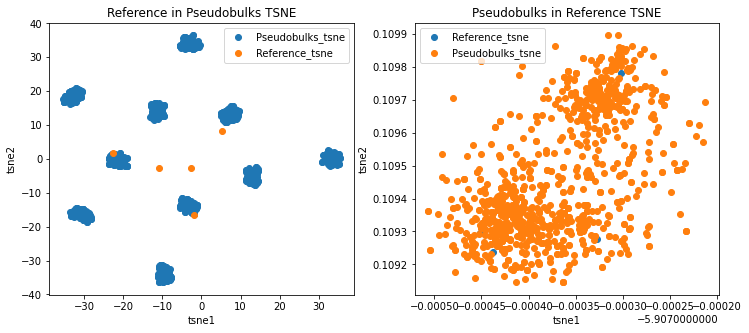

In [15]:
#tsne plots of reference dataframes projected in normalized pseudobulks TSNE 
#figures
plt.figure(figsize=(12, 5))
#data used
x_train = normalized_pseudo_df.values
x_test = ref_df.T.values
#compute the affinities between data points
affinities_train = affinity.PerplexityBasedNN(
    x_train,
    perplexity=60,
    metric="euclidean",
    n_jobs=8,
    random_state=42,
    verbose=True,
)
#initialize coordinates for embedd.
init_train = initialization.pca(x_train, random_state=42)
embedding_train = TSNEEmbedding(
    init_train,
    affinities_train,
    negative_gradient_method="fft",
    n_jobs=8,
    verbose=True,
)
#optimize embedding
embedding_train = embedding_train.optimize(n_iter=500)
#transform both in train embedd.
tsne_train = embedding_train.transform(x_train)
tsne_test = embedding_train.transform(x_test)
plt.subplot(1, 2, 1)
plt.scatter(tsne_train[:,0], tsne_train[:,1], label = "Pseudobulks_tsne" )
plt.scatter(tsne_test[:,0], tsne_test[:,1], label = "Reference_tsne" )
plt.title(f"Reference in Pseudobulks TSNE")
plt.xlabel("tsne1")
plt.ylabel("tsne2")
plt.legend()
#data used (switching)
x_train = ref_df.T.values
x_test = normalized_pseudo_df.values
#compute the affinities between data points
affinities_train = affinity.PerplexityBasedNN(
    x_train,
    perplexity=60,
    metric="euclidean",
    n_jobs=8,
    random_state=42,
    verbose=True,
)
#initialize coordinates for embedd.
init_train = initialization.pca(x_train, random_state=42)
embedding_train = TSNEEmbedding(
    init_train,
    affinities_train,
    negative_gradient_method="fft",
    n_jobs=8,
    verbose=True,
)
#optimize embedding
embedding_train = embedding_train.optimize(n_iter=500)
#transform both in train embedd.
tsne_train = embedding_train.transform(x_train)
tsne_test = embedding_train.transform(x_test)
plt.subplot(1, 2, 2)
plt.scatter(tsne_train[:,0], tsne_train[:,1], label = "Reference_tsne" )
plt.scatter(tsne_test[:,0], tsne_test[:,1], label = "Pseudobulks_tsne" )
plt.title(f"Pseudobulks in Reference TSNE")
plt.xlabel("tsne1")
plt.ylabel("tsne2")
plt.legend()
plt.show()

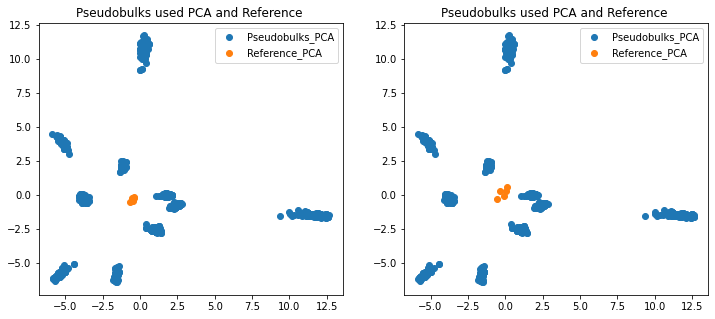

In [16]:
#PCA plots of reference dataframes with the normalized pseudobulks
plt.figure(figsize=(12, 5)) 
pca = PCA(n_components = 2)
pseudos_pca = pca.fit_transform(normalized_pseudo_df)
ref_pca = pca.transform(ref_av.T)
plt.subplot(1, 2, 1) 
plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Pseudobulks_PCA" )
plt.scatter(ref_pca[:,0], ref_pca[:,1], label = "Reference_PCA" )
plt.title("Pseudobulks used PCA and Reference ")
plt.xlabel
plt.legend()
pca = PCA(n_components = 2)
pseudos_pca = pca.fit_transform(normalized_pseudo_df)
ref_pca = pca.transform(ref_df.T)
plt.subplot(1, 2, 2)
plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Pseudobulks_PCA" )
plt.scatter(ref_pca[:,0], ref_pca[:,1], label = "Reference_PCA" )
plt.title("Pseudobulks used PCA and Reference ")
plt.xlabel
plt.legend()
plt.show()

In [17]:
#making a "real" pseudobulk by multp. prop and unscaled reference
pseudo_df_realref = prop_df @ ref_av.T 
pseudo_df_realref = pd.DataFrame(pseudo_df_realref)
#making a "real" pseudobulk by multp. prop and scaled ref
pseudo_df_real = prop_df @ ref_df.T 
pseudo_df_real = pd.DataFrame(pseudo_df_real)

In [18]:
# Putting together all reference expression, scaled and unscaled, and props.
all_refs = dict()
all_prop_refs = dict()
all_prop_refs_rebalanced = dict()
all_refs_raw = dict()
all_refs_av = dict()
#with no cell missing is just ref_df
all_refs[0] = ref_df
all_refs_av[0] = ref_av
all_refs_raw[0] = ref_raw
all_prop_refs[0] = prop_df
all_prop_refs_rebalanced[0] = prop_df
#assigning the rest in a loop
for num in num_missing_cells[1:]:
    #dropping cell types missing from references
    all_refs[num] = ref_df.drop(ref_df.columns[cells_to_miss[num]], axis=1)
    all_refs_av[num] = ref_av.drop(ref_av.columns[cells_to_miss[num]], axis=1)
    all_refs_raw[num] = ref_raw.drop(ref_raw.columns[cells_to_miss[num]], axis=1)
    all_prop_refs[num] = prop_df.drop(prop_df.columns[cells_to_miss[num]], axis=1) 
    all_prop_refs_rebalanced[num] = all_prop_refs[num]
    for idx,sample in all_prop_refs_rebalanced[num].iterrows():
        tot = np.sum(sample) #making them equal 1
        sample = sample / tot

## NNLS Deconvolution:

In [19]:
calc_prop_tot, calc_res_tot, custom_res_tot, comparison_prop_tot, missing_cell_tot  = vp.calc_nnls(all_refs, prop_df, normalized_pseudo_df, num_missing_cells, cells_to_miss)

Exp 0
Exp 1
Exp 2
Exp 3


Evalutating NNLS Performance:

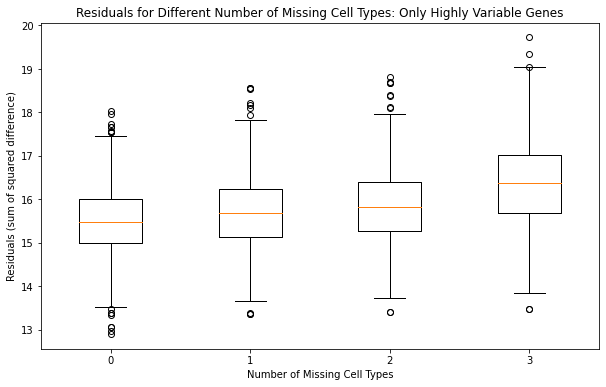

In [20]:
#Distribution of residuals as the sum of squared difference from NNLS
residuals = [calc_res_tot[exp] for exp in num_missing_cells]

plt.figure(figsize=(10, 6))
plt.boxplot(residuals, labels=num_missing_cells)
plt.xlabel('Number of Missing Cell Types')
plt.ylabel('Residuals (sum of squared difference)')
plt.title('Residuals for Different Number of Missing Cell Types: Only Highly Variable Genes')
## nnls(A, b)
## /Ax -b/^2
plt.show()

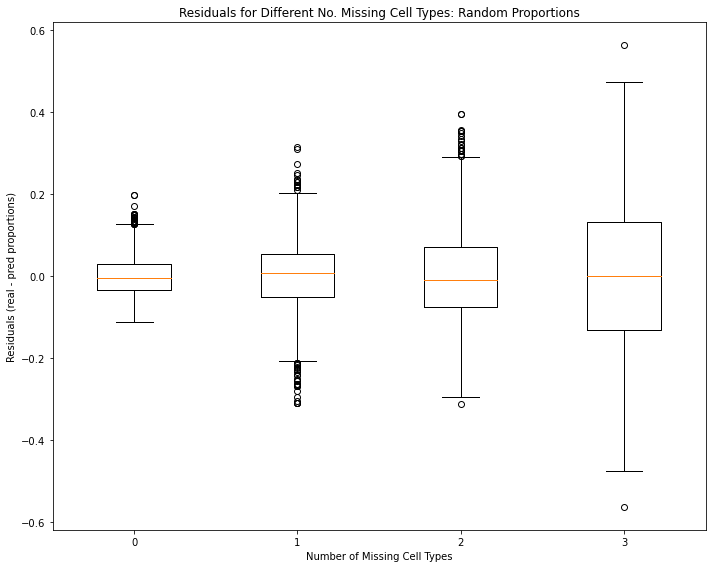

In [21]:
#Distribution of residuals as the difference between calculated and real proportions.
fig, ax = plt.subplots(figsize=(10, 8))

# List to store all the residual values
residual_values = []

# Iterate over the dataframes and extract the residual values
for num_cells in num_missing_cells:
    df = custom_res_tot[num_cells]
    residuals = df.values.flatten()  # Flatten the dataframe to a 1D array
    residual_values.append(residuals)

# Plot the box and whisker plot for all the residuals
ax.boxplot(residual_values, labels=num_missing_cells)
ax.set_title("Residuals for Different No. Missing Cell Types: Random Proportions")
ax.set_xlabel("Number of Missing Cell Types")
ax.set_ylabel("Residuals (real - pred proportions)")

plt.tight_layout()
plt.show()

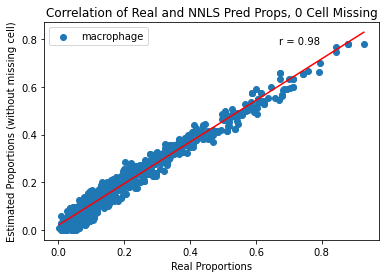

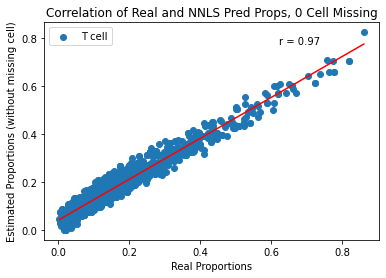

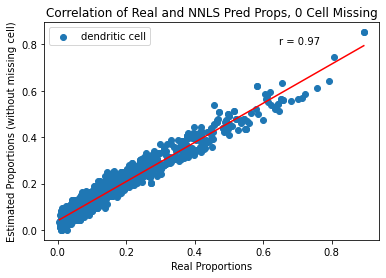

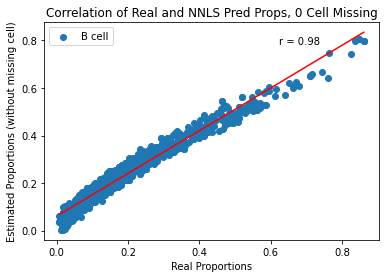

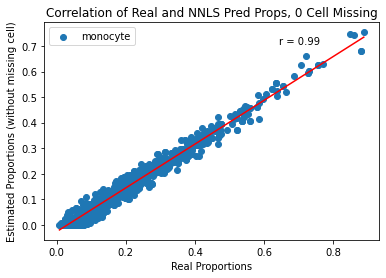

In [22]:
#Evaluation performance with no cell types missing, expect to be very close to 1.
num = 0 
for col_cell in all_prop_refs[num].columns:
    x = all_prop_refs[num][col_cell].values.astype(float)
    y = calc_prop_tot[num][col_cell].values.astype(float)
    correlation_coefficient = np.corrcoef(x, y)[0,1]
    plt.scatter(x, y, label= f"{col_cell}")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
    plt.xlabel('Real Proportions')
    plt.ylabel('Estimated Proportions (without missing cell)')
    plt.title(f'Correlation of Real and NNLS Pred Props, {num} Cell Missing')
    plt.legend()
    plt.show()

Real Proportions shape: (1000, 5)
Estimated Proportions shape: (1000, 5)


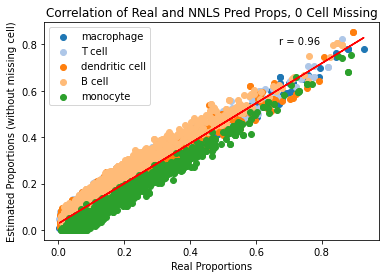

Real Proportions shape: (1000, 4)
Estimated Proportions shape: (1000, 4)


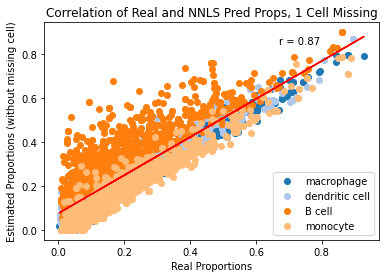

Real Proportions shape: (1000, 3)
Estimated Proportions shape: (1000, 3)


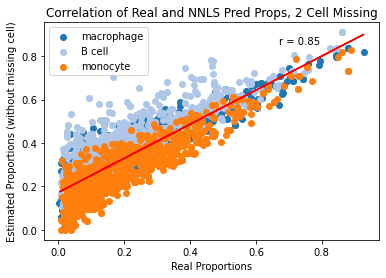

Real Proportions shape: (1000, 2)
Estimated Proportions shape: (1000, 2)


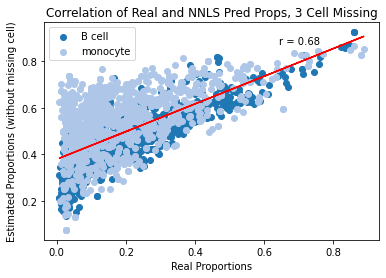

In [23]:
# define colormap for coloring cell types
cmap = get_cmap('tab20') 
for num in num_missing_cells:
    real_proportions = all_prop_refs[num].values.astype(float) #real proportions of present cells
    estimated_proportions = calc_prop_tot[num].values.astype(float) #estimated proportions of present cells.
    cell_types = all_prop_refs[num].columns.tolist() 
    # Print the shapes of the matrices
    print("Real Proportions shape:", real_proportions.shape)
    print("Estimated Proportions shape:", estimated_proportions.shape)
    correlation_coefficient = np.corrcoef(real_proportions, estimated_proportions)[0, 1]
    #scatter plot with colored points for each cell type
    fig, ax = plt.subplots()
    for i, cell_type in enumerate(cell_types):
        x = real_proportions[:, i]
        y = estimated_proportions[:, i]
        color = cmap(i)  #unique color for each cell type
        ax.scatter(x, y, label=cell_type, color=color)
    #fit a regression line
    m, b = np.polyfit(real_proportions.flatten(), estimated_proportions.flatten(), 1)
    plt.plot(real_proportions.flatten(), m * real_proportions.flatten() + b, color="red")
    r, p = stats.pearsonr(real_proportions.flatten(), estimated_proportions.flatten())
    plt.annotate(f'r = {r:.2f}', xy=(0.7, 0.9), xycoords='axes fraction')
    plt.xlabel('Real Proportions')
    plt.ylabel('Estimated Proportions (without missing cell)')
    plt.title(f'Correlation of Real and NNLS Pred Props, {num} Cell Missing')
    plt.legend(loc='best')  #show the cell type labels in the legend
    plt.show()

Recreate Matrices:

In [24]:
#recreate matrix with calculated proportion nnls and multiplying by the used reference
recreated_mat_all = dict()
for num in num_missing_cells:
        recreated_mat_all[num] = pd.DataFrame(all_refs[num] @ calc_prop_tot[num].T)
        recreated_mat_all[num] = recreated_mat_all[num].T
        recreated_mat_all[num].columns = gene_ids
recreated_mat_all[0]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8,CD79A,AC092746.1,XIST
0,0.600170,0.463103,0.364735,0.402523,0.748606,0.089378,0.298033,0.161801,0.465532,0.467697,...,0.141650,0.389573,0.264913,0.344470,0.051878,0.148582,0.364228,0.146993,0.004522,1.0
1,0.582392,0.380046,0.404903,0.336674,0.658220,0.128642,0.305037,0.199640,0.302782,0.559084,...,0.142496,0.380875,0.230637,0.321389,0.044795,0.199293,0.291235,0.150494,0.003048,1.0
2,0.643782,0.449927,0.422520,0.303455,0.531077,0.107831,0.323962,0.190747,0.417108,0.439053,...,0.162468,0.392607,0.227479,0.313268,0.041962,0.167157,0.299898,0.173139,0.018406,1.0
3,0.598904,0.416718,0.381870,0.353462,0.662396,0.118605,0.306742,0.157930,0.390564,0.501725,...,0.120197,0.386988,0.243045,0.321608,0.046487,0.190861,0.316263,0.126270,0.007113,1.0
4,0.558546,0.293929,0.360121,0.286235,0.447947,0.235763,0.274410,0.055806,0.205013,0.428090,...,0.030220,0.343213,0.193781,0.256610,0.038737,0.363916,0.218419,0.033582,0.006835,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.558424,0.332539,0.344643,0.336018,0.591058,0.193354,0.282172,0.068287,0.285499,0.480363,...,0.035263,0.360910,0.222607,0.284183,0.043815,0.307269,0.267310,0.036947,0.003120,1.0
996,0.661313,0.471073,0.361062,0.318071,0.545670,0.112956,0.339057,0.064136,0.551351,0.410888,...,0.047075,0.411648,0.247315,0.294717,0.042425,0.197661,0.319837,0.050531,0.025469,1.0
997,0.594059,0.422032,0.338810,0.378725,0.699035,0.126005,0.303413,0.085906,0.449629,0.480734,...,0.058879,0.390208,0.256697,0.315607,0.048539,0.213629,0.333704,0.060360,0.007167,1.0
998,0.580641,0.362301,0.392429,0.310551,0.487664,0.184466,0.273478,0.141593,0.259776,0.387860,...,0.130572,0.347015,0.205352,0.290470,0.042403,0.275843,0.260630,0.138843,0.007212,1.0


In [25]:
#recreate matrix with calculated proportion nnls and multiplying by the av. reference
recreated_mat_all_realref = dict()
for num in num_missing_cells:
        recreated_mat_all_realref[num] = pd.DataFrame(all_refs_av[num] @ calc_prop_tot[num].T)
        recreated_mat_all_realref[num] = recreated_mat_all_realref[num].T
        recreated_mat_all_realref[num].columns = gene_ids
recreated_mat_all_realref[0]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8,CD79A,AC092746.1,XIST
0,0.272249,0.209368,0.160263,0.184130,0.331838,0.038830,0.134956,0.071158,0.198844,0.205439,...,0.060900,0.172794,0.119461,0.153469,0.022848,0.065126,0.163344,0.065867,0.001592,0.443851
1,0.262577,0.170256,0.179648,0.150771,0.290451,0.056784,0.136187,0.087016,0.133016,0.244983,...,0.061328,0.167532,0.103526,0.142809,0.018470,0.088789,0.131634,0.067479,0.001302,0.443851
2,0.287206,0.200855,0.184398,0.136540,0.232259,0.046964,0.143328,0.083361,0.180078,0.189807,...,0.069797,0.175117,0.101367,0.138791,0.017620,0.073023,0.133441,0.077620,0.008056,0.443851
3,0.269873,0.187268,0.167417,0.159466,0.291724,0.052055,0.137558,0.069150,0.168601,0.219492,...,0.051711,0.171246,0.109277,0.143293,0.019802,0.084365,0.142337,0.056566,0.002960,0.443851
4,0.249530,0.130081,0.154064,0.125334,0.191201,0.104269,0.122419,0.024769,0.089316,0.186315,...,0.013026,0.151845,0.087862,0.114235,0.016342,0.161772,0.100343,0.014848,0.003085,0.443851
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.251447,0.148895,0.148563,0.149456,0.257040,0.085475,0.127098,0.030235,0.123379,0.210446,...,0.015238,0.159233,0.100952,0.127102,0.018746,0.136663,0.122181,0.016386,0.001284,0.443851
996,0.294271,0.211142,0.152409,0.142860,0.235975,0.049140,0.151165,0.028510,0.235218,0.176927,...,0.020241,0.184508,0.110689,0.132318,0.018396,0.086041,0.142655,0.022492,0.011052,0.443851
997,0.268249,0.190461,0.146170,0.171263,0.307031,0.055290,0.137282,0.038049,0.192212,0.210669,...,0.025377,0.172975,0.115970,0.141538,0.021222,0.094297,0.150607,0.026924,0.002859,0.443851
998,0.260373,0.161276,0.170737,0.139116,0.211843,0.081124,0.121897,0.062255,0.112031,0.168728,...,0.056074,0.154197,0.092667,0.128214,0.018258,0.121964,0.117658,0.062157,0.003113,0.443851


## **Extracting Missing Cell Information:**

In [26]:
# Get the corresponding missing_cell_tot dataframe
missing_cell_exp_usedref = dict()
missing_cell_exp_usedref[0] = []
for num in num_missing_cells[1:]:
    missing_cell_exp_usedref[num] = all_refs[0][missing_cell_tot[num].columns]  
# and using the other reference
missing_cell_exp_avref = dict()
missing_cell_exp_avref[0] = []
for num in num_missing_cells[1:]:
    missing_cell_exp_avref[num] = all_refs_av[0][missing_cell_tot[num].columns]  

In [27]:
# Get the corresponding missing_cell_proportions
missing_cell_prop = dict()
missing_cell_prop[0] = []
for num in num_missing_cells[1:]:
    missing_cell_prop[num] = prop_df[missing_cell_tot[num].columns]  

In [28]:
#multiplying missing cell proportions * the missing cell expression ref.
missing_cell_usedexp_x_prop = dict()
missing_cell_usedexp_x_prop[0] = []
for num in num_missing_cells[1:]:
    missing_cell_exp_matrix = missing_cell_exp_usedref[num]  
    missing_cell_prop_matrix = missing_cell_prop[num]  
    #multiplication
    result_matrix = np.dot(missing_cell_exp_matrix, missing_cell_prop_matrix.T)  
    #convert to dataframe
    missing_cell_usedexp_x_prop[num] = pd.DataFrame(result_matrix.T, columns = gene_ids)
missing_cell_usedexp_x_prop[1]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8,CD79A,AC092746.1,XIST
0,0.02693,0.010694,0.018166,0.013737,0.01652,0.017183,0.01202,0.000178,0.001788,0.017894,...,0.000036,0.015537,0.008313,0.011594,0.001895,0.025816,0.008278,0.000166,0.000047,0.0528
1,0.091908,0.036496,0.061999,0.046883,0.056381,0.058645,0.041023,0.000606,0.006103,0.06107,...,0.000121,0.053027,0.028373,0.039568,0.006467,0.088108,0.028251,0.000566,0.000162,0.1802
2,0.058348,0.02317,0.03936,0.029764,0.035794,0.037231,0.026043,0.000385,0.003874,0.03877,...,0.000077,0.033664,0.018012,0.02512,0.004105,0.055936,0.017935,0.000359,0.000103,0.1144
3,0.085481,0.033944,0.057664,0.043605,0.052439,0.054544,0.038155,0.000564,0.005676,0.0568,...,0.000113,0.049319,0.026389,0.036801,0.006015,0.081948,0.026276,0.000526,0.00015,0.1676
4,0.388644,0.15433,0.262172,0.198253,0.238416,0.247987,0.173471,0.002564,0.025807,0.258241,...,0.000513,0.224231,0.119977,0.167319,0.027345,0.372579,0.119464,0.002393,0.000684,0.762
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.256648,0.101914,0.17313,0.13092,0.157442,0.163762,0.114555,0.001693,0.017042,0.170534,...,0.000339,0.148075,0.079229,0.110492,0.018058,0.246039,0.07889,0.00158,0.000451,0.5032
996,0.073649,0.029246,0.049682,0.037569,0.04518,0.046994,0.032873,0.000486,0.00489,0.048937,...,0.000097,0.042492,0.022736,0.031707,0.005182,0.070604,0.022639,0.000453,0.00013,0.1444
997,0.10068,0.03998,0.067917,0.051358,0.061763,0.064242,0.044939,0.000664,0.006685,0.066899,...,0.000133,0.058088,0.031081,0.043345,0.007084,0.096518,0.030948,0.00062,0.000177,0.1974
998,0.196362,0.077975,0.132462,0.100167,0.12046,0.125295,0.087646,0.001295,0.013039,0.130476,...,0.000259,0.113292,0.060618,0.084538,0.013816,0.188245,0.060359,0.001209,0.000345,0.385


In [29]:
#multiplying missing cell proportions * the missing cell average expression.
missing_cell_avexp_x_prop = dict()
missing_cell_avexp_x_prop[0] = []
for num in num_missing_cells[1:]:
    missing_cell_exp_matrix = missing_cell_exp_avref[num]  
    missing_cell_prop_matrix = missing_cell_prop[num]  
    #multiplication
    result_matrix = np.dot(missing_cell_exp_matrix, missing_cell_prop_matrix.T)  
    #convert to dataframe
    missing_cell_avexp_x_prop[num] = pd.DataFrame(result_matrix.T, columns = gene_ids)
missing_cell_avexp_x_prop[1]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8,CD79A,AC092746.1,XIST
0,0.012018,0.004641,0.007682,0.005922,0.006795,0.007609,0.005369,0.000116,0.000815,0.007784,...,0.000015,0.006867,0.003827,0.005121,0.000815,0.011494,0.003914,0.000058,0.000029,0.023435
1,0.041015,0.01584,0.026218,0.02021,0.023189,0.02597,0.018323,0.000397,0.002781,0.026566,...,0.00005,0.023437,0.013059,0.017479,0.002781,0.039228,0.013357,0.000199,0.000099,0.079982
2,0.026039,0.010056,0.016645,0.01283,0.014722,0.016487,0.011632,0.000252,0.001765,0.016865,...,0.000032,0.014879,0.008291,0.011096,0.001765,0.024904,0.00848,0.000126,0.000063,0.050777
3,0.038147,0.014733,0.024385,0.018797,0.021568,0.024154,0.017042,0.000369,0.002586,0.024708,...,0.000046,0.021799,0.012146,0.016257,0.002586,0.036485,0.012423,0.000185,0.000092,0.07439
4,0.173439,0.066982,0.110867,0.08546,0.098059,0.109817,0.077481,0.00168,0.011759,0.112337,...,0.00021,0.099109,0.055224,0.073912,0.011759,0.16588,0.056483,0.00084,0.00042,0.338215
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.114533,0.044233,0.073213,0.056435,0.064755,0.07252,0.051166,0.001109,0.007765,0.074184,...,0.000139,0.065448,0.036468,0.048809,0.007765,0.109542,0.0373,0.000555,0.000277,0.223346
996,0.032867,0.012693,0.021009,0.016195,0.018582,0.020811,0.014683,0.000318,0.002228,0.021288,...,0.00004,0.018781,0.010465,0.014006,0.002228,0.031435,0.010704,0.000159,0.00008,0.064092
997,0.04493,0.017352,0.028721,0.022139,0.025403,0.028449,0.020072,0.000435,0.003046,0.029101,...,0.000054,0.025675,0.014306,0.019147,0.003046,0.042972,0.014632,0.000218,0.000109,0.087616
998,0.08763,0.033843,0.056016,0.043179,0.049544,0.055485,0.039147,0.000849,0.005941,0.056758,...,0.000106,0.050075,0.027902,0.037344,0.005941,0.083811,0.028538,0.000424,0.000212,0.170883


In [30]:
#seprating into the individual cell types exp * prop used ref.
usedex_prop_individual = dict() #initializing dict that has dictionaries of each CT missing.
usedex_prop_individual[0] = [] #no cells missing in 0, so empty.
for num in num_missing_cells[1:]: #for each experiment:
    usedex_prop_individual[num] = dict() #initialize dict with each cell type individually.
    x = missing_cell_exp_usedref[num].T #missing cell expression
    y = missing_cell_prop[num] #missing cell proportions
    for col_cell, row in x.iterrows(): #for each missing cell (col_cel) reference expression:
        exp = row.values[:,None] #expression is the column values
        prop = y[col_cell].values[:,None] #proportions are the values in y (see above).
        # Perform matrix multiplication
        result_matrix = np.dot(exp, prop.T)  #multiplying each cell's expression * proportion
        #convert to dataframe  
        usedex_prop_individual[num][col_cell] = pd.DataFrame(result_matrix.T, columns = gene_ids) 
        #each entry is usedex_prop_individual[num_missing_cells][specific_missing_cell]

In [31]:
#seprating into the individual cell types exp * prop av ref.
#same as above, but different reference.
avex_prop_individual = dict() #initializing dict that has dictionaries of each CT missing.
avex_prop_individual[0] = [] #no cells missing in 0, so empty.
for num in num_missing_cells[1:]: #for each experiment:
    avex_prop_individual[num] = dict() #initialize dict with each cell type individually.
    x = missing_cell_exp_avref[num].T #missing cell expression
    y = missing_cell_prop[num] #missing cell proportions
    for col_cell, row in x.iterrows(): #for each missing cell (col_cel) reference expression:
        exp = row.values[:,None] #expression is the column values
        prop = y[col_cell].values[:,None] #proportions are the values in y (see above).
        # Perform matrix multiplication
        result_matrix = np.dot(exp, prop.T)  #multiplying each cell's expression * proportion
        #convert to dataframe  
        avex_prop_individual[num][col_cell] = pd.DataFrame(result_matrix.T, columns = gene_ids) 
        #each entry is avex_prop_individual[num_missing_cells][specific_missing_cell]

## **Calculate Residuals:**

1. Residual uses:

pseudobulks - recreated_mat_all (reference used normalized (all_refs) * calculated proportions (calc_prop_tot))

2. Residual_diffbase uses: 

pseudo_df_real (real proportions * reference used normalized all_refs)   -  recreated_mat_all (same as the residual).

3. Residual_realref uses:

pseudo_df_realref (real proportions * average expression normalized (ref_av))  -  recreated_mat_realref (average expression normalized (ref_av) * calculated proportions (calc_prop_tot))

In [32]:
#Residual as the the difference between the recreated matrix and pseudobulks.
residuals = dict()
for num in num_missing_cells:
    res = normalized_pseudo_df.values - recreated_mat_all[num].values
    residuals[num] = pd.DataFrame(res, columns = gene_ids)
residuals[0]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8,CD79A,AC092746.1,XIST
0,-0.489059,0.360612,0.272145,-0.195678,0.251394,0.176020,-0.162741,-0.053547,-0.379818,-0.427094,...,-0.092770,-0.215203,-0.181399,-0.257983,0.610653,-0.096140,-0.233740,-0.128485,-0.000098,-1.0
1,-0.458849,0.313742,0.376278,-0.206752,0.341780,0.365199,-0.162491,-0.020214,-0.229097,-0.523403,...,-0.099923,-0.155501,-0.183999,-0.235983,0.410954,-0.121379,-0.181479,-0.125718,0.085447,-1.0
2,-0.477892,0.550073,0.285406,-0.132952,0.468923,0.224196,-0.148409,-0.066644,-0.320567,-0.419674,...,-0.102866,-0.159582,-0.177045,-0.231106,0.441909,-0.114115,-0.194715,-0.154333,0.229382,-1.0
3,-0.498282,0.304506,0.259747,-0.203250,0.337604,0.217901,-0.162019,-0.055358,-0.269662,-0.466967,...,-0.080462,-0.125591,-0.164411,-0.289897,0.506035,-0.127631,-0.205592,-0.112837,0.045985,-1.0
4,-0.424513,0.132751,0.159930,-0.155709,0.552053,0.639937,-0.115179,-0.031882,-0.162607,-0.414556,...,-0.022020,-0.180956,-0.149313,-0.236069,0.521230,-0.147854,-0.139760,-0.032687,0.055112,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,-0.449255,0.309845,-0.214552,-0.121905,0.408942,0.338561,-0.160663,0.009764,0.133148,-0.291191,...,-0.027379,-0.104295,-0.053410,-0.245264,-0.029754,-0.297979,-0.234078,-0.023515,0.076526,-1.0
996,-0.534273,0.528927,-0.197500,-0.044298,0.408653,0.119967,-0.175836,0.030960,0.448649,-0.234942,...,-0.041084,-0.012222,-0.052088,-0.243546,-0.028364,-0.194364,-0.259776,-0.031427,0.204619,-1.0
997,-0.532287,0.467278,-0.255135,-0.147653,0.300965,0.156750,-0.196050,-0.005464,0.064356,-0.324167,...,-0.042480,-0.109047,-0.125460,-0.275247,-0.036959,-0.207036,-0.305045,-0.039465,0.063630,-1.0
998,-0.466811,0.278822,-0.231077,-0.138534,0.257278,0.323373,-0.156685,0.022581,0.228043,-0.243597,...,-0.093675,-0.094226,-0.088758,-0.260200,-0.034959,-0.265654,-0.229533,-0.108396,0.032611,-1.0


In [33]:
#Residual with a different baseline, using real proportions * ref expression as baseline
#instead of the pseudobulks as before.
residuals_diffbase = dict()
for num in num_missing_cells:
    res = pseudo_df_real.values - recreated_mat_all[num].values
    residuals_diffbase[num] = pd.DataFrame(res, columns = gene_ids)
residuals_diffbase[0]   

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8,CD79A,AC092746.1,XIST
0,0.013229,0.027972,-0.026428,0.017289,0.031025,-0.012095,0.008649,-0.046044,0.087363,-0.015034,...,-0.038778,0.012566,0.015448,0.000136,0.001466,-0.007902,0.023438,-0.041672,0.003266,0.0
1,0.00564,0.009952,-0.01358,0.006412,0.013176,-0.003764,0.004924,-0.025371,0.03913,-0.002801,...,-0.02343,0.006358,0.006799,-0.001552,0.000447,-0.000143,0.008833,-0.025024,0.00162,0.0
2,0.018649,0.02452,-0.019094,0.002528,-0.005417,-0.006871,0.01085,-0.044558,0.07759,-0.024737,...,-0.036887,0.011505,0.009154,-0.005547,-0.000012,-0.001586,0.012931,-0.039064,0.005244,0.0
3,0.01325,0.022307,-0.017494,0.008338,0.011582,-0.008797,0.008036,-0.034402,0.067219,-0.015652,...,-0.028459,0.009922,0.010143,-0.001449,0.000642,-0.005765,0.015374,-0.030396,0.003417,0.0
4,-0.011968,-0.019881,-0.011978,-0.002138,-0.033432,0.024482,-0.013508,-0.027354,-0.030179,-0.035756,...,-0.016921,-0.012772,-0.007092,-0.01079,-0.00032,0.036038,-0.011873,-0.017877,-0.001156,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.006856,0.007125,-0.002279,-0.00228,-0.006076,-0.002728,0.004382,-0.008641,0.020118,-0.005075,...,-0.007554,0.003797,0.001606,-0.001679,-0.000287,-0.002135,0.002062,-0.007876,0.001836,0.0
996,0.027369,0.037872,-0.001409,0.001465,0.025912,-0.029653,0.023294,-0.006454,0.089009,0.019775,...,-0.012304,0.022395,0.013466,0.005733,0.000024,-0.036988,0.020074,-0.01296,0.005524,0.0
997,0.015665,0.026478,-0.003618,0.006148,0.021765,-0.01901,0.011735,-0.005507,0.059259,0.00415,...,-0.00592,0.012523,0.009856,0.005118,0.000594,-0.023998,0.016451,-0.006446,0.002949,0.0
998,0.008195,0.009013,-0.00425,-0.000794,0.003779,-0.005773,0.007483,-0.011465,0.029278,0.00462,...,-0.01296,0.007028,0.003917,-0.001021,-0.00021,-0.005083,0.004368,-0.013645,0.002054,0.0


In [34]:
#Residual with a different baseline, using real proportions * average expression as baseline
#instead of the used reference (sum).
residuals_realref = dict()
for num in num_missing_cells:
    res = pseudo_df_realref  - recreated_mat_all_realref[num]
    residuals_realref[num] = pd.DataFrame(res, columns = gene_ids)
residuals_realref[0]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8,CD79A,AC092746.1,XIST
0,0.005915,0.013215,-0.013508,0.008364,0.013205,-0.005484,0.004521,-0.019884,0.036065,-0.006721,...,-0.016657,0.00612,0.007081,0.000826,0.001002,-0.003899,0.010331,-0.018737,0.001337,0.0
1,0.002447,0.004746,-0.006965,0.002985,0.005433,-0.0017,0.002491,-0.010987,0.016209,-0.001305,...,-0.01006,0.003031,0.003122,-0.000262,0.00033,-0.000205,0.003953,-0.011249,0.000676,-0.0
2,0.007664,0.011265,-0.010582,0.001286,-0.003508,-0.003184,0.005057,-0.019275,0.032072,-0.011432,...,-0.015856,0.005831,0.004103,-0.001841,0.000259,-0.001161,0.005486,-0.017568,0.002257,0.0
3,0.005671,0.010391,-0.009263,0.004089,0.004536,-0.004009,0.003931,-0.014864,0.027789,-0.007147,...,-0.012229,0.004915,0.004597,-0.000102,0.00053,-0.002907,0.006669,-0.013669,0.001442,-0.0
4,-0.005355,-0.009085,-0.006197,-0.001146,-0.015716,0.010833,-0.005779,-0.011764,-0.013551,-0.015617,...,-0.00729,-0.005513,-0.00284,-0.004879,0.000095,0.015999,-0.004955,-0.008058,-0.000519,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.002754,0.003193,-0.001537,-0.001067,-0.003014,-0.001245,0.001895,-0.003751,0.00842,-0.002474,...,-0.003248,0.001891,0.000658,-0.000609,-0.0001,-0.001076,0.000788,-0.003541,0.000807,0.0
996,0.011605,0.0173,-0.001387,0.000829,0.011451,-0.01322,0.010228,-0.002882,0.037967,0.008092,...,-0.005269,0.01033,0.005655,0.003126,-0.000066,-0.016759,0.008389,-0.005808,0.002414,-0.0
997,0.006824,0.012192,-0.002088,0.003155,0.009766,-0.008507,0.005298,-0.00239,0.025014,0.001569,...,-0.002539,0.00586,0.00426,0.002606,0.000315,-0.010916,0.006975,-0.002891,0.001261,0.0
998,0.003361,0.004123,-0.002458,-0.000456,0.001369,-0.002572,0.003321,-0.005004,0.012411,0.001799,...,-0.005561,0.003269,0.001674,-0.000172,-0.0001,-0.002359,0.001849,-0.006129,0.000902,0.0


## **Singular Value Decomposition**

SVD on each residual matrix. For this purposes, we will only focus on U and S.

U: Left singular vectors, representing the column space of the original matrix. (cells)

Σ or sigma: Singular values, representing the diagonal matrix of singular values.

Vh or V^T: Right singular vectors, representing the row space of the original matrix. (sample)

Calculating SVD

In [35]:
num_cells_missing = [0,1,2,3] #for each number of missing cells

In [36]:
# SVD on pseudobulk for QC
df = normalized_pseudo_df.T
Mat_pseudo = df.astype("float32")
U_pseudo, s_pseudo, V_pseudo = sp.linalg.svd(Mat_pseudo)
U_pseudo = pd.DataFrame(U_pseudo)
s_pseudo = pd.DataFrame(s_pseudo)
V_pseudo = pd.DataFrame(V_pseudo)

In [37]:
# SVD on residual 1
U_all = dict()
s_all = dict()
V_all = dict()
Matres_all = dict()

for num in num_cells_missing:
    df = residuals[num].T
    Mat = df.astype("float32")
    U, s, V = sp.linalg.svd(Mat)
    U = pd.DataFrame(U)
    s = pd.DataFrame(s)
    V = pd.DataFrame(V)

    U_all[num] = U
    s_all[num] = s
    V_all[num] = V
    Matres_all[num] = Mat

In [38]:
# SVD on residual with another reference
U_all_realref = dict()
s_all_realref = dict()
V_all_realref = dict()
Matres_all_realref = dict()

for num in num_cells_missing:
    df = residuals_realref[num].T
    Mat = df.astype("float32")
    U, s, V = sp.linalg.svd(Mat)
    U = pd.DataFrame(U)
    s = pd.DataFrame(s)
    V = pd.DataFrame(V)

    U_all_realref[num] = U
    s_all_realref[num] = s
    V_all_realref[num] = V
    Matres_all_realref[num] = Mat

In [39]:
# SVD on residual with another reference
U_diffbase = dict()
s_diffbase = dict()
V_diffbase = dict()
Matres_diffbase = dict()

for num in num_cells_missing:
    df = residuals_diffbase[num].T
    Mat = df.astype("float32")
    U, s, V = sp.linalg.svd(Mat)
    U = pd.DataFrame(U)
    s = pd.DataFrame(s)
    V = pd.DataFrame(V)

    U_diffbase[num] = U
    s_diffbase[num] = s
    V_diffbase[num] = V
    Matres_diffbase[num] = Mat

In [40]:
#SVD on reference for QC
U_all_ref = dict()
s_all_ref = dict()
V_all_ref = dict()
Matref_all_ref = dict()

for num in num_cells_missing:
    df = all_refs[num].T
    Mat_ref  = df.astype("float32")
    U_ref , s_ref , V_ref  = sp.linalg.svd(Mat_ref )
    U_ref = pd.DataFrame(U_ref )
    s_ref  = pd.DataFrame(s_ref )
    V_ref  = pd.DataFrame(V_ref )

    U_all_ref[num] = U_ref 
    s_all_ref[num] = s_ref 
    V_all_ref[num] = V_ref 
    Matref_all_ref[num] = Mat_ref 

In [41]:
#SVD on recreated matrix for QC
U_all_rec = dict()
s_all_rec = dict()
V_all_rec = dict()
Matres_all_rec = dict()

for num in num_cells_missing:
    df = recreated_mat_all[num].T
    Mat_rec = df.astype("float32")
    U_rec , s_rec , V_rec  = sp.linalg.svd(Mat_rec )
    U_rec  = pd.DataFrame(U_rec )
    s_rec  = pd.DataFrame(s_rec )
    V_rec  = pd.DataFrame(V_rec )

    U_all_rec[num] = U_rec 
    s_all_rec[num] = s_rec 
    V_all_rec[num] = V_rec 
    Matres_all_rec[num] = Mat_rec 

S-Value Eval for each SVD:

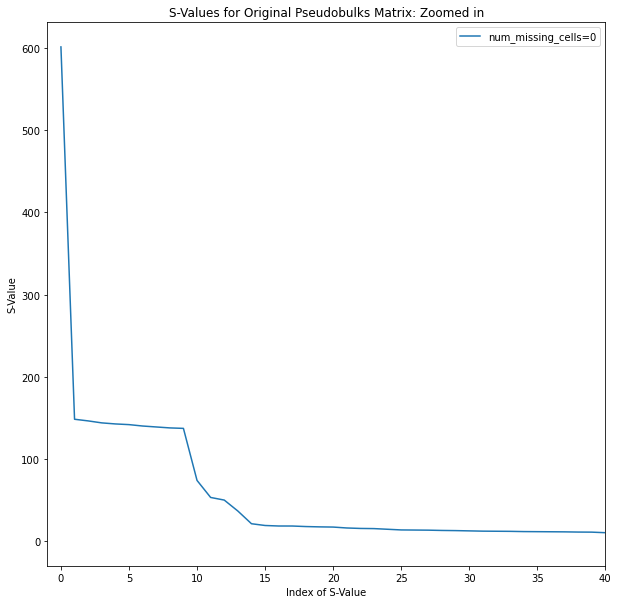

In [42]:
###SVD on Pseudobulk##
num =0
plt.figure(figsize = [10,10])
# Create a color map
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
dataframe = pd.DataFrame(s_pseudo)
x = dataframe.index
y = dataframe.values.flatten()
color = color_map(num_missing_cells.index(num))
label = f"num_missing_cells={num}"
plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Original Pseudobulks Matrix: Zoomed in')
plt.xlim([-1,40])
# Add a legend
plt.legend()
# Display the plot
plt.show()

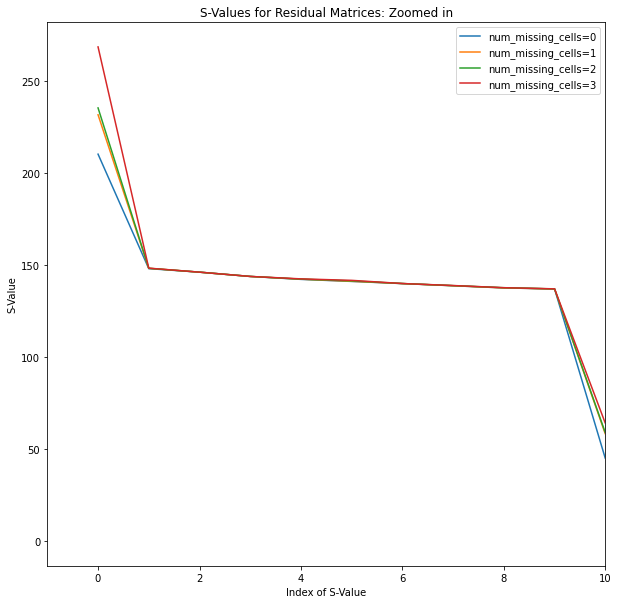

In [43]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating num 
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)
# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Residual Matrices: Zoomed in')
plt.xlim([-1,10])
# Add a legend
plt.legend()
# Display the plot
plt.show()

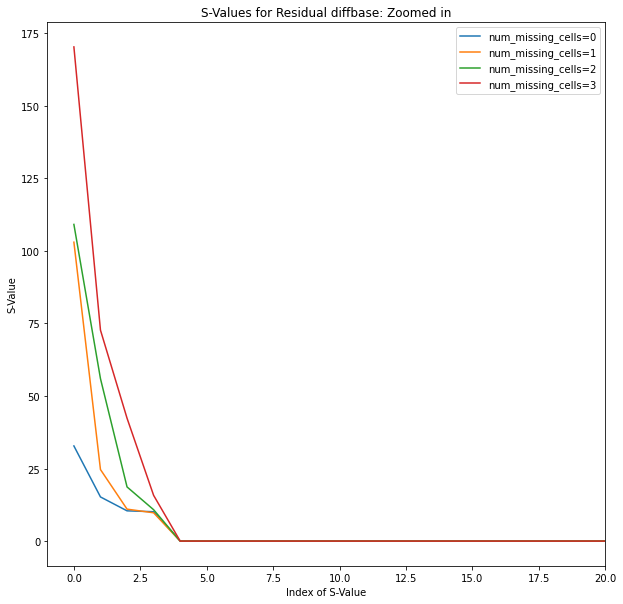

In [44]:

plt.figure(figsize = [10,10])
# Create a color map for differentiating the num
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_diffbase[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)
# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Residual diffbase: Zoomed in')
plt.xlim([-1,20])
# Add a legend
plt.legend()
# Display the plot
plt.show()


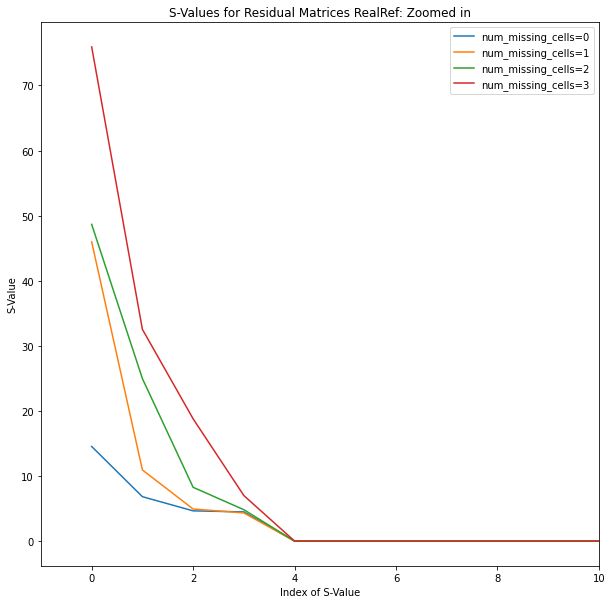

In [45]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_realref[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Residual Matrices RealRef: Zoomed in')
plt.xlim([-1,10])
# Add a legend
plt.legend()
# Display the plot
plt.show()

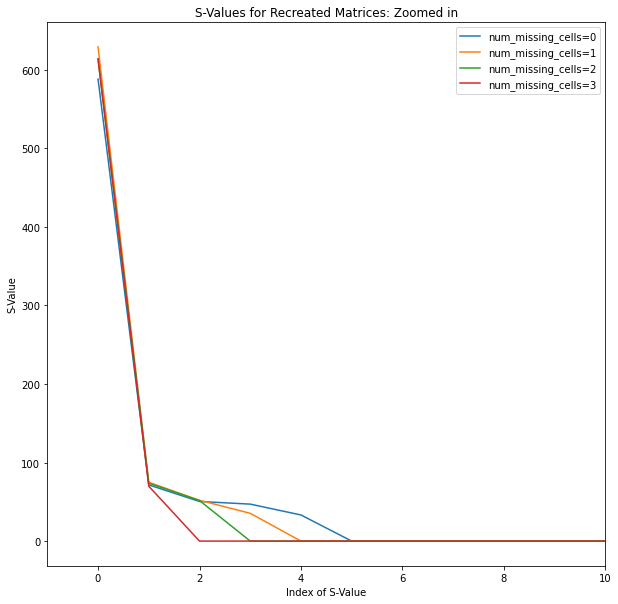

In [46]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_rec[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Recreated Matrices: Zoomed in')
plt.xlim([-1,10])
# Add a legend
plt.legend()
# Display the plot
plt.show()

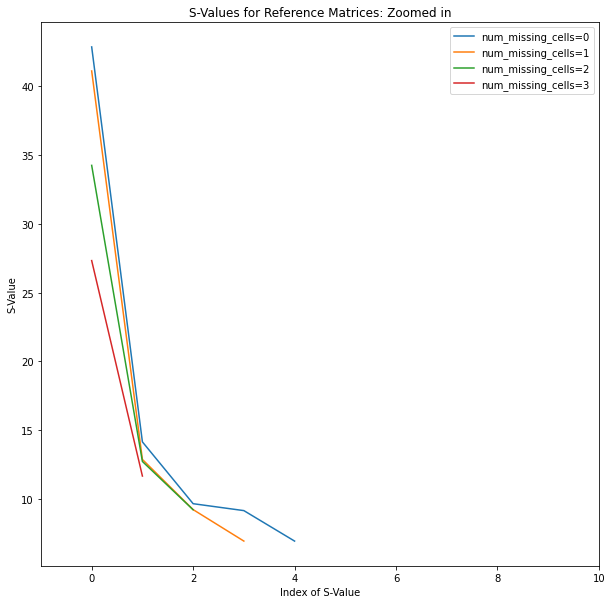

In [47]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_ref[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Reference Matrices: Zoomed in')
plt.xlim([-1,10])
# Add a legend
plt.legend()
# Display the plot
plt.show()

**Reconstructing Residual Matrix**

With highly variable genes that match elbow S:

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


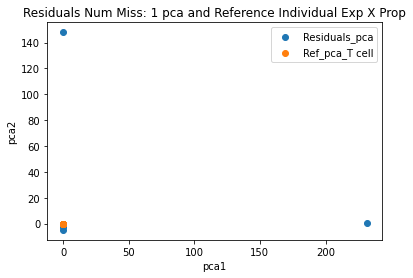

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


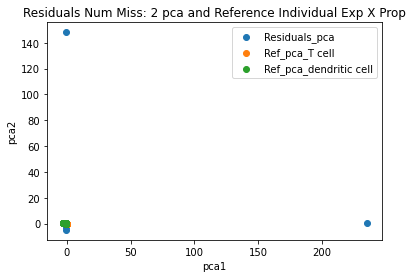

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


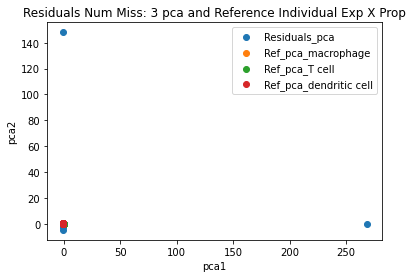

In [48]:
#reconstructing SVD using all S values, Residual 1.
Recon_Mat_allS = dict()
for num in num_cells_missing:
    num_SVs = len(s_all[num]) #num of cells
    #cutting S and U to 30 to all elbow plots
    U = U_all[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_all[num].shape[0]))
    diag_val = s_all[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])
    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_allS[num] = pd.DataFrame(anum[:,0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num] #all missing celltypes ex * prop
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict: #for each missing cell ex * prop
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show()
#each missing cell's expression * proportion matrix is projected into the SVD's reconstructed matrix (just S * U).

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


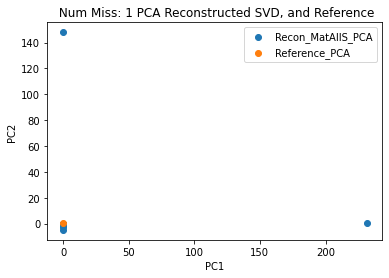

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


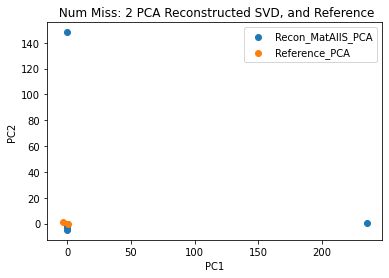

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


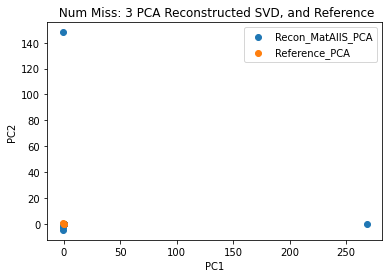

In [49]:
#analyzing reconstructed matrix of all S values with missing cell exp.
#Residual 1
for num in num_cells_missing[1:]:
    pca = PCA(n_components = 2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS[num].T)
    ref_pca = pca.transform(missing_cell_exp_usedref[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Recon_MatAllS_PCA" )
    plt.scatter(ref_pca[:,0], ref_pca[:,1], label = "Reference_PCA" )
    plt.title(f" Num Miss: {num} PCA Reconstructed SVD, and Reference")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


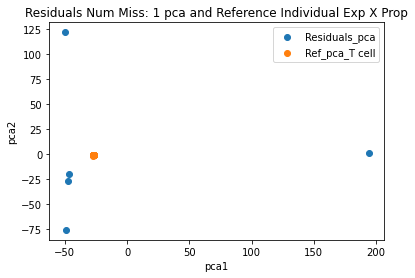

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


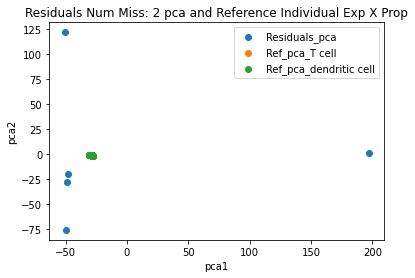

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


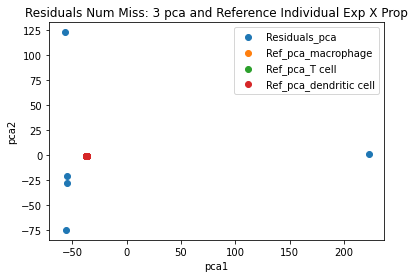

In [50]:
#reconstructing SVD using all only some S values, Residual 1.
Recon_Mat_matchS = dict()
for num in num_cells_missing:
    num_SVs = 5 #num of cells
    #cutting S and U to 30 to match elbow plots
    U = U_all[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_all[num].shape[0]))
    diag_val = s_all[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])
    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_matchS[num] = pd.DataFrame(anum[:,0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict =  usedex_prop_individual[num]
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_matchS[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show()   
#each missing cell's expression * proportion matrix is projected into the SVD's reconstructed matrix (just S * U).    

In [51]:
#reconstructing Matrix with 1 S val, residual 1.
Recon_Mat_oneS = dict()
num_SVs = 1
for num in num_cells_missing:
    #cutting S and U to 30 to one elbow plots
    U = U_all[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_all[num].shape[0]))
    diag_val = s_all[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])
    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_oneS[num] = pd.DataFrame(anum[:,0:num_SVs])
#QC    
Recon_Mat_oneS[0]  

,0
0,-11.829109
1,-0.391834
2,-0.519625
3,-0.490864
4,-1.373460
...,...
3302,0.476006
3303,-2.362951
3304,-0.514474
3305,3.779278


/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


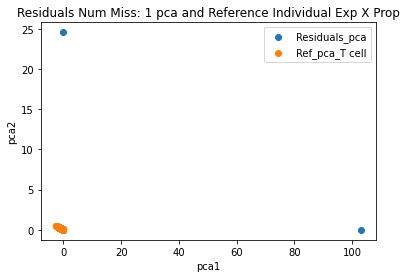

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


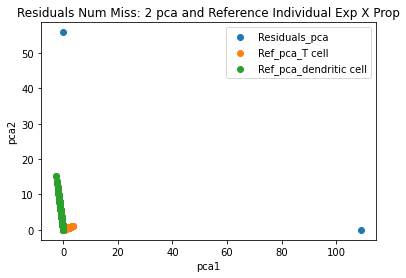

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


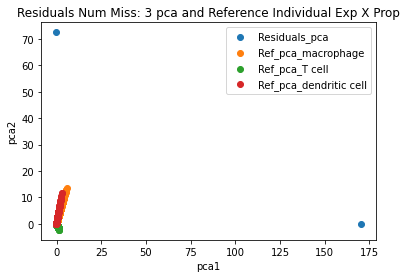

In [52]:
#reconstructing Matrix with all S values, Residual Diffbase
Recon_Mat_allS_diffbase = dict()
for num in num_cells_missing:
    num_SVs = len(s_diffbase[num]) #num of cells
    #cutting S and U to 30 to all elbow plots
    U = U_diffbase[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_diffbase[num].shape[0]))
    diag_val = s_diffbase[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])
    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_allS_diffbase[num] = pd.DataFrame(anum[:,0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict =  usedex_prop_individual[num]
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS_diffbase[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show()
#each missing cell's expression * proportion matrix is projected into the SVD's reconstructed matrix (just S * U).    

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


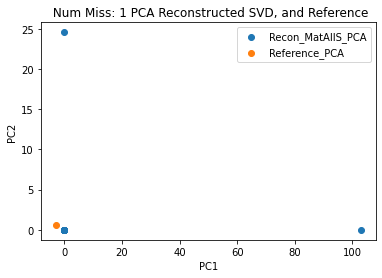

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


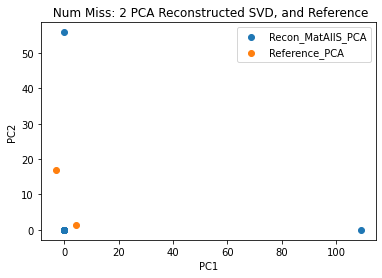

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


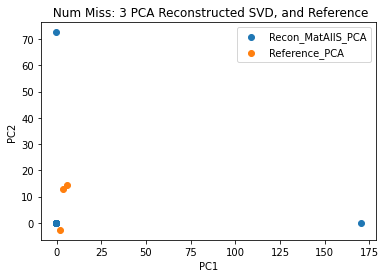

In [53]:
#analyzing reconstructed matrix of all S values with missing cell exp.
#Residual diffbase
for num in num_cells_missing[1:]:
    pca = PCA(n_components = 2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS_diffbase[num].T)
    ref_pca = pca.transform(missing_cell_exp_usedref[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Recon_MatAllS_PCA" )
    plt.scatter(ref_pca[:,0], ref_pca[:,1], label = "Reference_PCA" )
    plt.title(f" Num Miss: {num} PCA Reconstructed SVD, and Reference")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


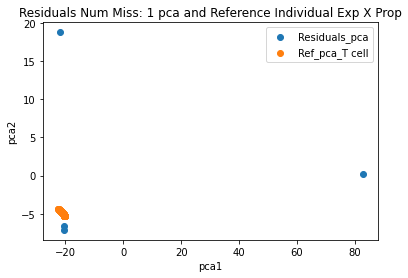

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


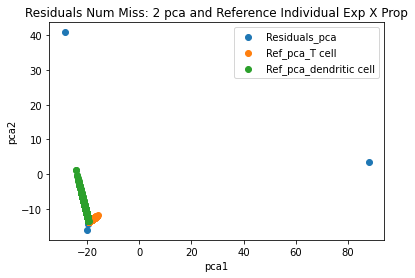

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


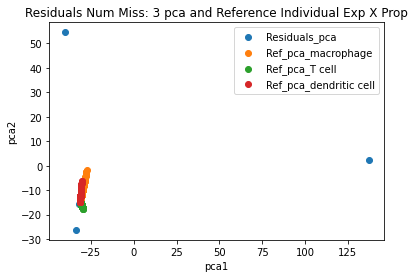

In [54]:
#reconstructing Matrix with some S values, Residual Diffbase
Recon_Mat_matchS_diffbase = dict()
for num in num_cells_missing:
    num_SVs = 5 #num of cells
    #cutting S and U to 30 to match elbow plots
    U = U_diffbase[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_diffbase[num].shape[0]))
    diag_val = s_diffbase[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])

    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_matchS_diffbase[num] = pd.DataFrame(anum[:, 0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict =  usedex_prop_individual[num]
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_matchS_diffbase[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show()

In [55]:
#reconstructing Matrix with one S value, Residual Diffbase
Recon_Mat_oneS_diffbase = dict()
num_SV = 1
for num in num_cells_missing:
    #cutting S and U to 30 to one elbow plots
    U = U_diffbase[num].values[:, :num_SV]
    S = np.zeros((U.shape[1], Matres_diffbase[num].shape[0]))
    diag_val = s_diffbase[num].values[:num_SV]
    np.fill_diagonal(S, [diag_val])

    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_oneS_diffbase[num] = pd.DataFrame(anum[:,0:num_SV])
#QC    
Recon_Mat_oneS_diffbase[0]    

,0
0,-4.313044e-01
1,-5.919415e-01
2,2.652002e-01
3,-1.004294e-01
4,-5.613837e-01
...,...
3302,4.215597e-01
3303,-3.692414e-01
3304,6.836525e-01
3305,-9.790525e-02


/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


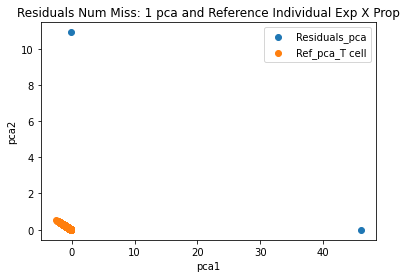

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


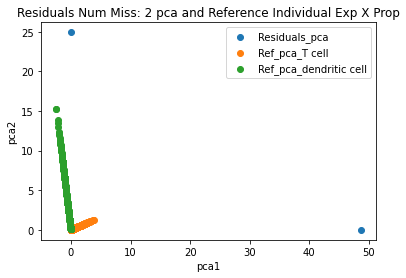

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


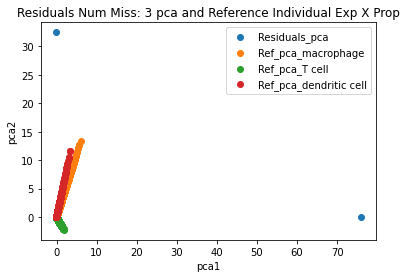

In [56]:
#reconstructing Matrix with all S values, Residual Diffbase
Recon_Mat_allS_realref = dict()
for num in num_cells_missing:
    num_SVs = len(s_all_realref[num]) #num of cells
    #cutting S and U to 30 to all elbow plots
    U = U_all_realref[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_all_realref[num].shape[0]))
    diag_val = s_all_realref[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])
    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_allS_realref[num] = pd.DataFrame(anum[:,0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict =  usedex_prop_individual[num]
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS_realref[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


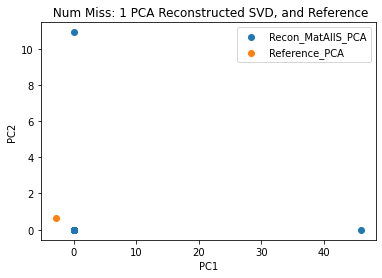

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


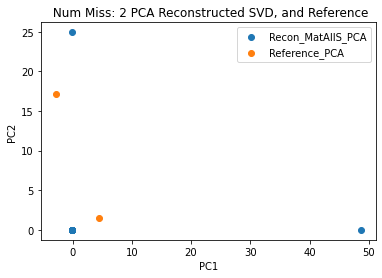

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


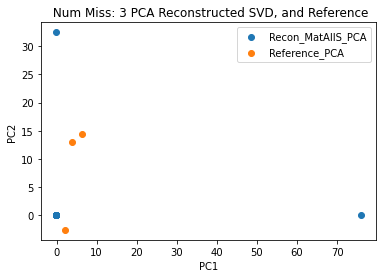

In [57]:
#analyzing reconstructed matrix of all S values with missing cell exp.
#Residual realref
for num in num_cells_missing[1:]:
    pca = PCA(n_components = 2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS_realref[num].T)
    ref_pca = pca.transform(missing_cell_exp_usedref[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Recon_MatAllS_PCA" )
    plt.scatter(ref_pca[:,0], ref_pca[:,1], label = "Reference_PCA" )
    plt.title(f" Num Miss: {num} PCA Reconstructed SVD, and Reference")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


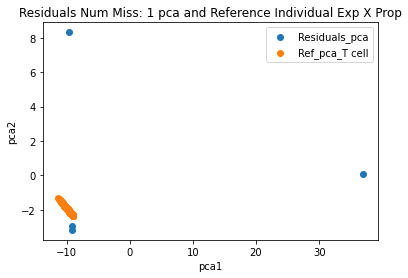

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


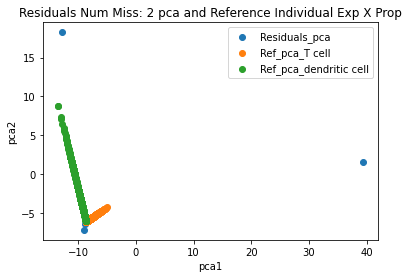

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


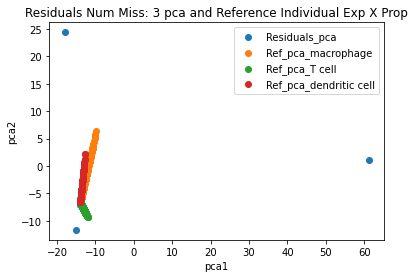

In [58]:
#reconstructing Matrix with some S values, Residual Diffbase
Recon_Mat_matchS_realref = dict()
for num in num_cells_missing:
    num_SVs = 5 #num of cells
    #cutting S and U to 30 to match elbow plots
    U = U_all_realref[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_all_realref[num].shape[0]))
    diag_val = s_all_realref[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])

    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_matchS_realref[num] = pd.DataFrame(anum[:, 0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict =  usedex_prop_individual[num]
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_matchS_realref[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show() 

In [59]:
#reconstructing Matrix with one S values, Residual Diffbase
Recon_Mat_oneS_realref = dict()
num_SV = 1
for num in num_cells_missing:
    #cutting S and U to 30 to one elbow plots
    U = U_all_realref[num].values[:, :num_SV]
    S = np.zeros((U.shape[1], Matres_all_realref[num].shape[0]))
    diag_val = s_all_realref[num].values[:num_SV]
    np.fill_diagonal(S, [diag_val])

    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_oneS_realref[num] = pd.DataFrame(anum[:,0:num_SV])
#QC    
Recon_Mat_oneS_realref[0]    

,0
0,-1.823892e-01
1,-2.738154e-01
2,1.441347e-01
3,-4.598080e-02
4,-2.402996e-01
...,...
3302,1.931170e-01
3303,-1.592766e-01
3304,3.067451e-01
3305,-4.238576e-02


**Plotting Correlations between SVD on Residual and Missing Cell Information:**

**Residual:** 

One S:

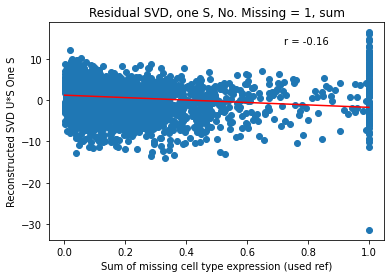

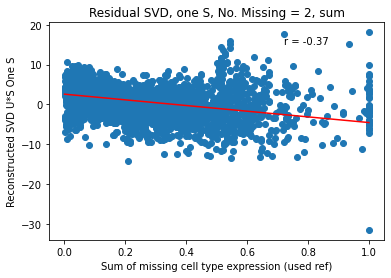

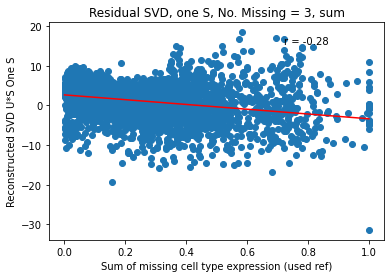

In [60]:
#one S value with mean expression of missing cell types.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    y = Recon_Mat_oneS[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residual SVD, one S, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

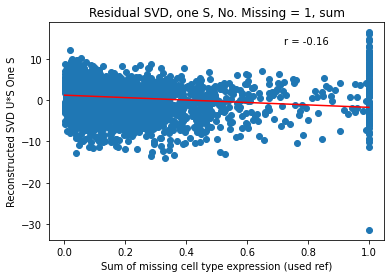

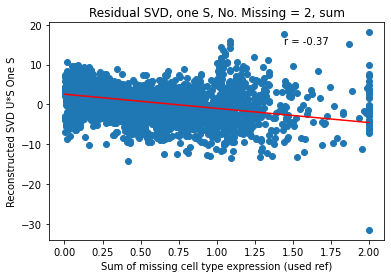

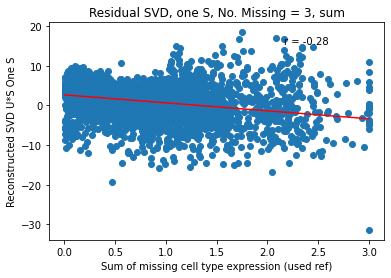

In [61]:
#one S value with sum of expression of missing cell types. Used Reference.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    y = Recon_Mat_oneS[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residual SVD, one S, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

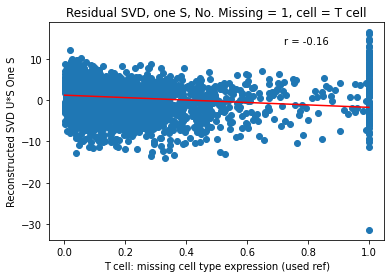

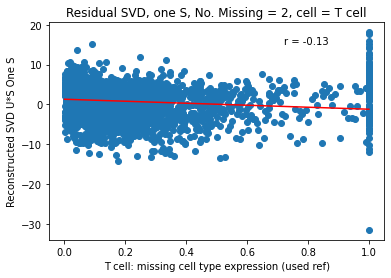

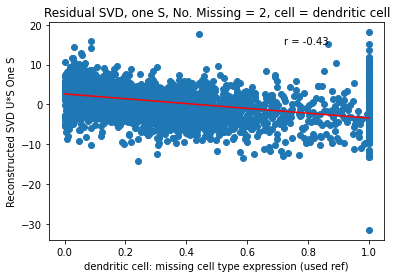

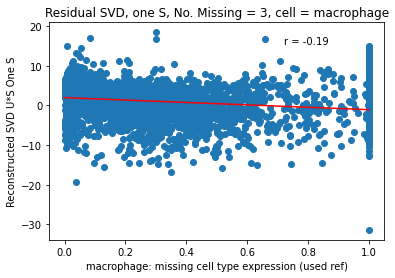

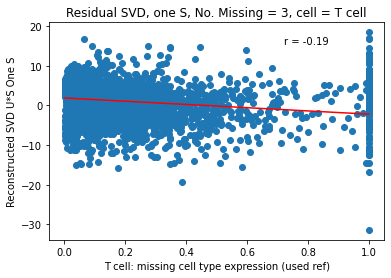

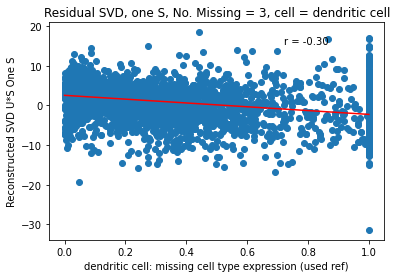

In [62]:
#Each missing cell expression seprately, used ref.
for num in num_missing_cells[1:]:
    y = Recon_Mat_oneS[num][0].values
    for col in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][col].values
        plt.scatter(x,y)
        plt.title(f'Residual SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S One S")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

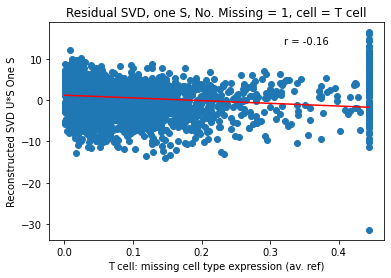

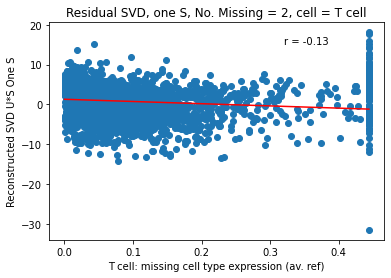

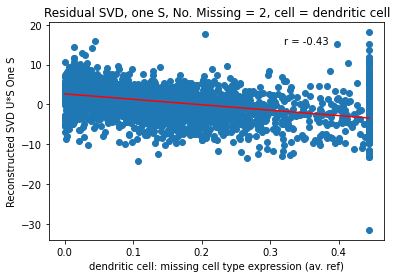

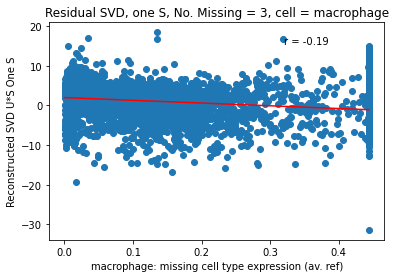

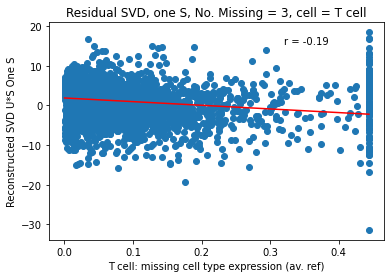

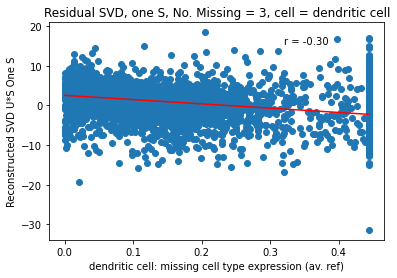

In [63]:
#Each missing cell expression seprately, average ref.
for num in num_missing_cells[1:]:
    y = Recon_Mat_oneS[num][0].values
    for col in missing_cell_exp_avref[num].columns:
        x = missing_cell_exp_avref[num][col].values
        plt.scatter(x,y)
        plt.title(f'Residual SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (av. ref)')
        plt.ylabel(f"Reconstructed SVD U*S One S")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

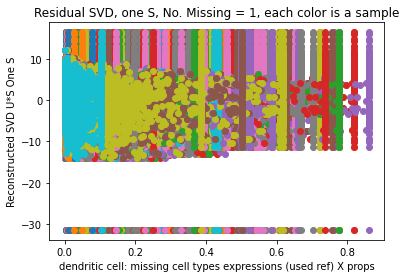

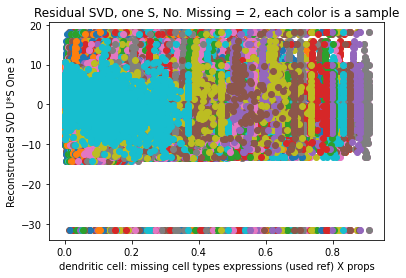

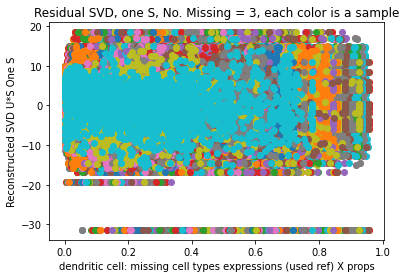

In [64]:
#Recon_mat with one S, with each sample in missing cell exp X prop, used. ref.
for num in num_missing_cells[1:]:
    y = Recon_Mat_oneS[num]
    for index,row in missing_cell_usedexp_x_prop[num].iterrows(): #each row is a sample
        x = row
        plt.scatter(x,y)
    plt.title(f'Residual SVD, one S, No. Missing = {num}, each color is a sample')
    plt.xlabel(f'{col}: missing cell types expressions (used ref) X props')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.show()

Match S:

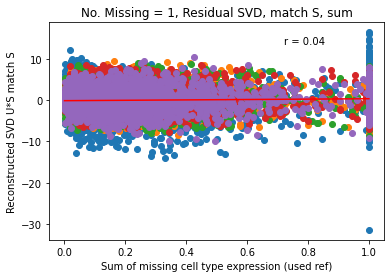

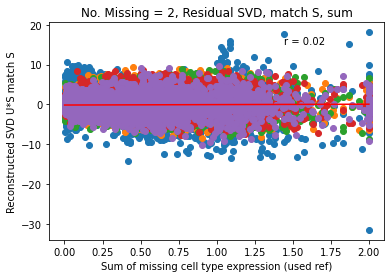

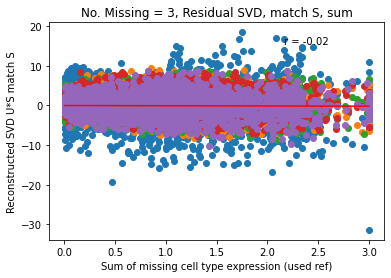

In [65]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_matchS[num].columns:
        y = Recon_Mat_matchS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

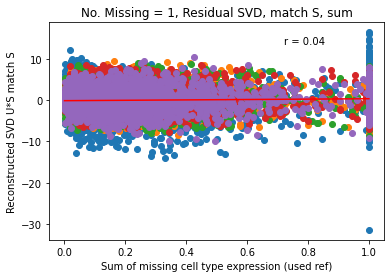

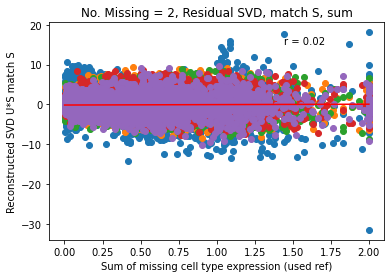

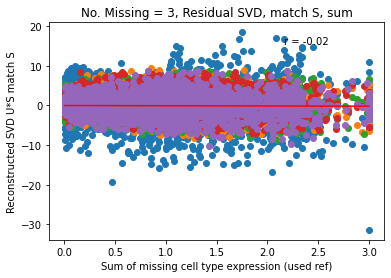

In [66]:
#sum expr. used
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_matchS[num].columns:
        y = Recon_Mat_matchS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()


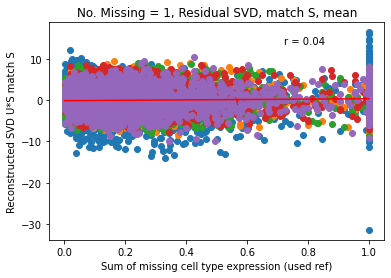

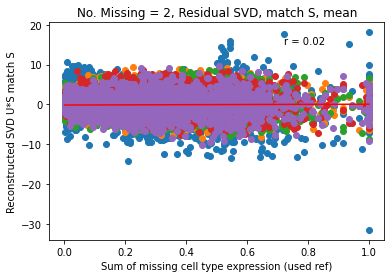

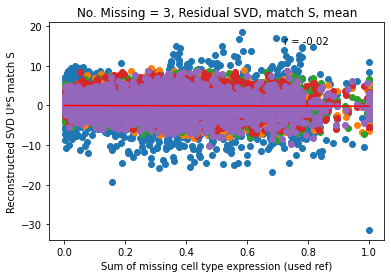

In [67]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_matchS[num].columns:
        y = Recon_Mat_matchS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, mean')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

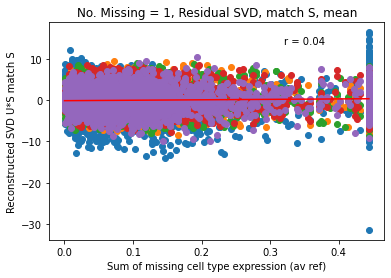

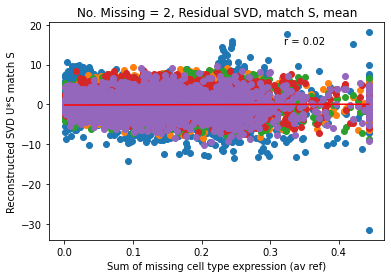

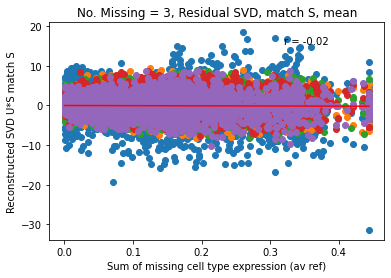

In [68]:
#mean expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].mean(axis=1).values
    for cellcol in Recon_Mat_matchS[num].columns:
        y = Recon_Mat_matchS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, mean')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

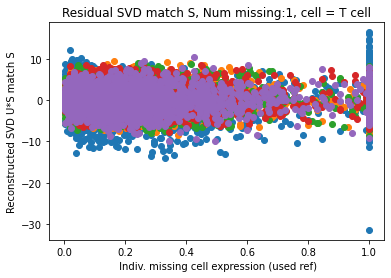

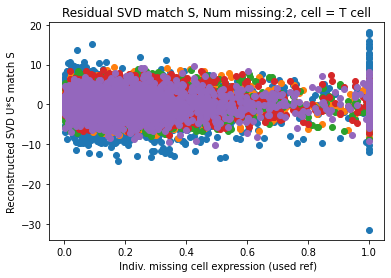

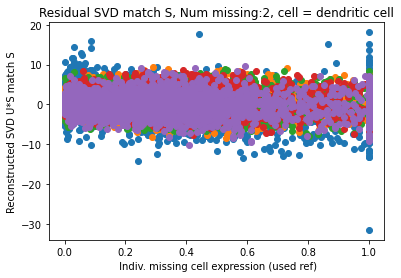

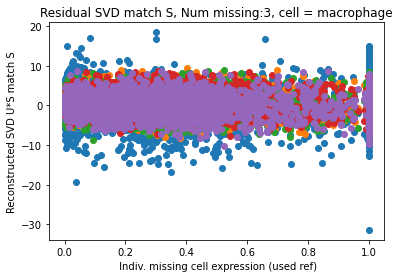

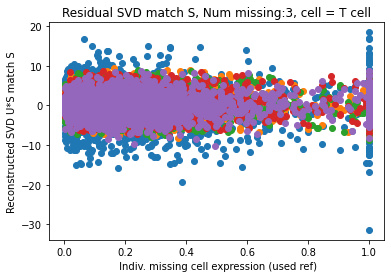

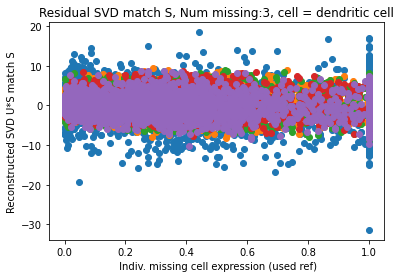

In [69]:
#Each cell type used expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        for sval in Recon_Mat_matchS[num].columns:
            y = Recon_Mat_matchS[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()            

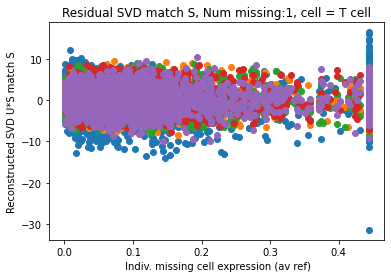

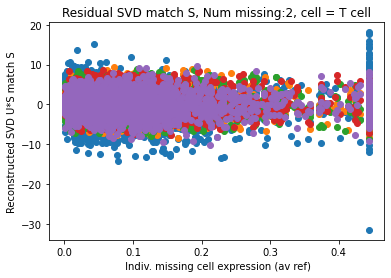

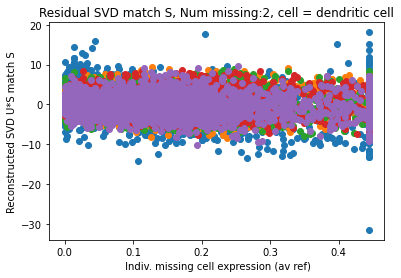

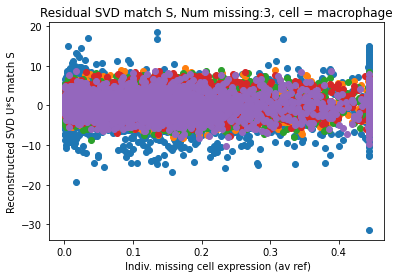

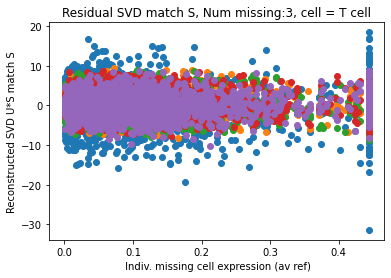

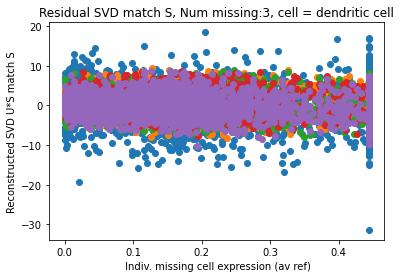

In [70]:
#Each cell type average expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_avref[num].columns:
        x = missing_cell_exp_avref[num][cell]
        for sval in Recon_Mat_matchS[num].columns:
            y = Recon_Mat_matchS[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (av ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()   

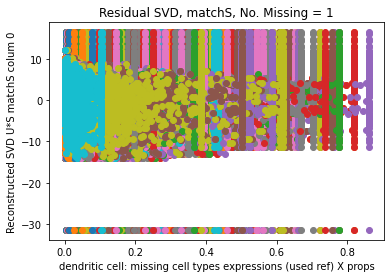

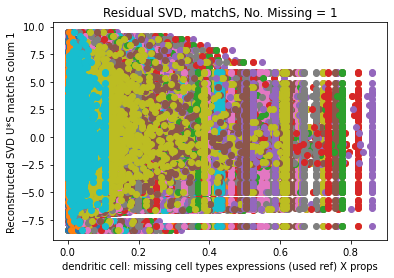

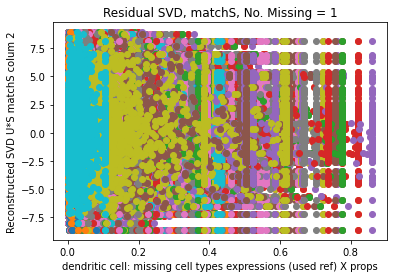

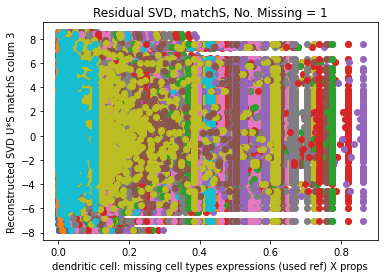

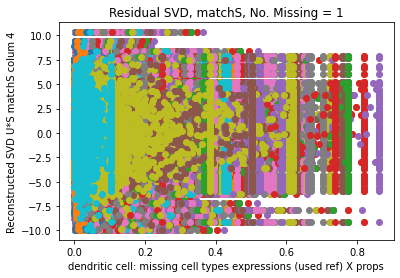

...

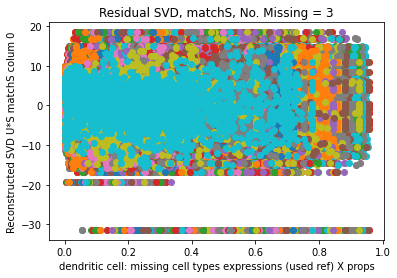

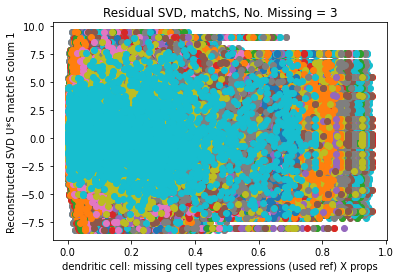

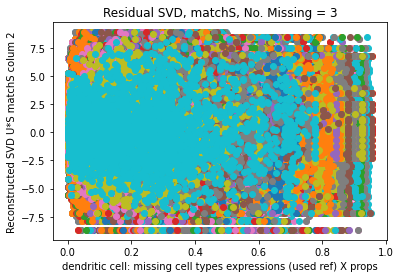

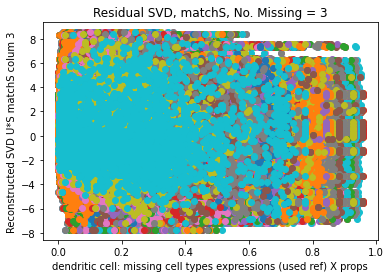

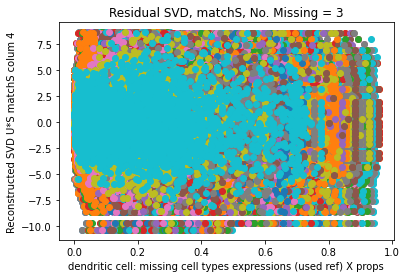

In [71]:
#Each column in Recon_mat with each sample in missing cell used exp * prop
for num in num_missing_cells[1:]:
    for column in Recon_Mat_matchS[num].columns: 
        y = Recon_Mat_matchS[num][column] #each column
        for index,row in missing_cell_usedexp_x_prop[num].iterrows(): #per sample
            x = row.values
            plt.scatter(x,y)
        plt.title(f'Residual SVD, matchS, No. Missing = {num}')
        plt.xlabel(f'{col}: missing cell types expressions (used ref) X props')
        plt.ylabel(f"Reconstructed SVD U*S matchS colum {column}")
        plt.show()

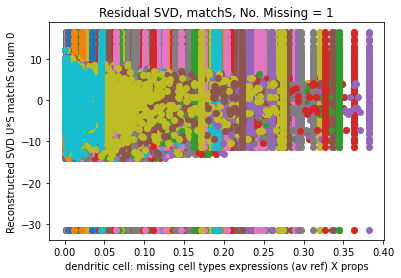

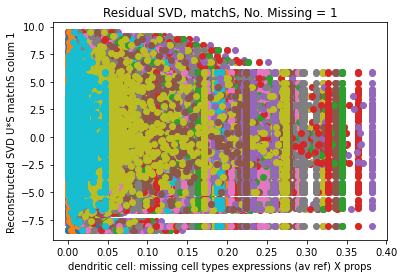

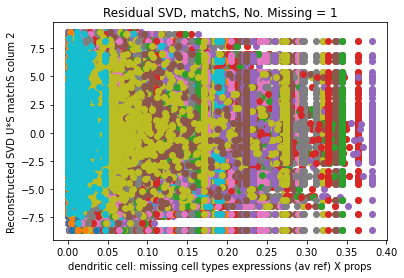

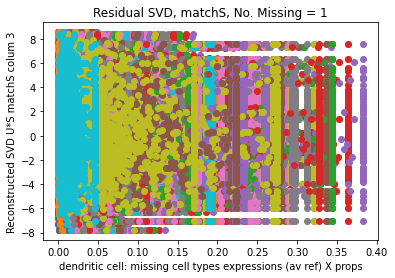

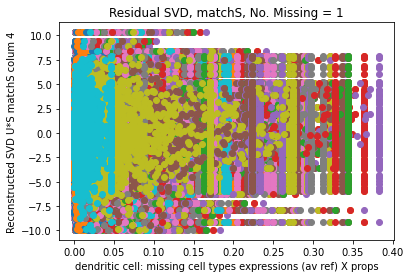

...

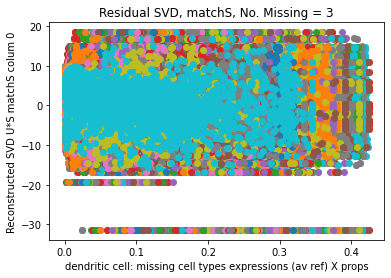

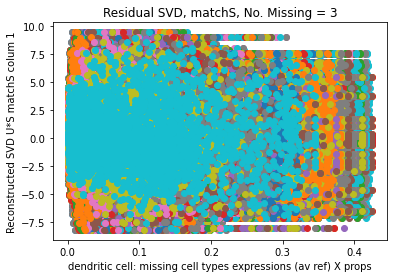

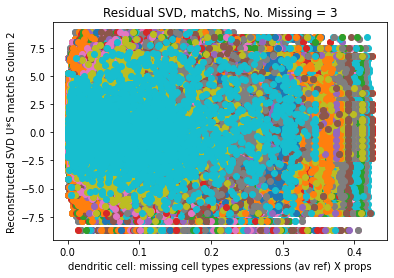

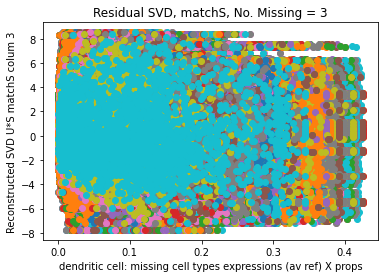

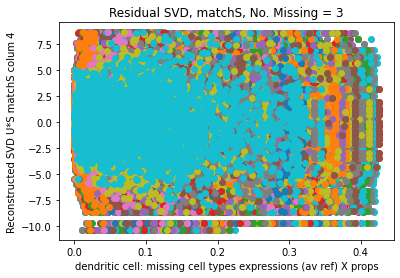

In [72]:
#Each column in Recon_mat with each sample in missing cell av exp * prop
for num in num_missing_cells[1:]:
    for column in Recon_Mat_matchS[num].columns: 
        y = Recon_Mat_matchS[num][column] #each column
        for index,row in missing_cell_avexp_x_prop[num].iterrows(): #per sample
            x = row.values
            plt.scatter(x,y)
        plt.title(f'Residual SVD, matchS, No. Missing = {num}')
        plt.xlabel(f'{col}: missing cell types expressions (av ref) X props')
        plt.ylabel(f"Reconstructed SVD U*S matchS colum {column}")
        plt.show()

All S:

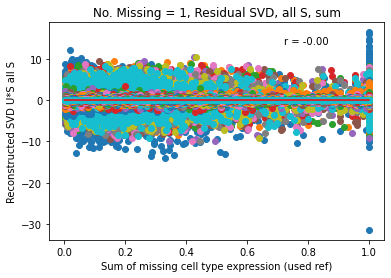

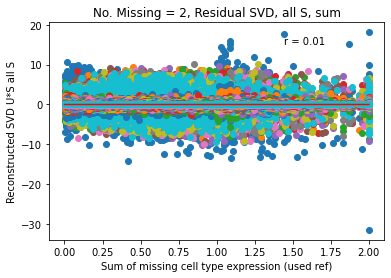

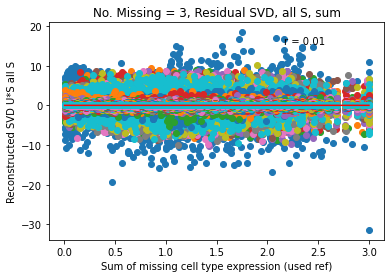

In [73]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS[num].columns:
        y = Recon_Mat_allS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

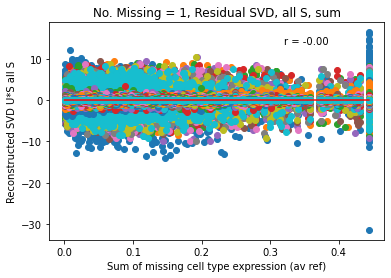

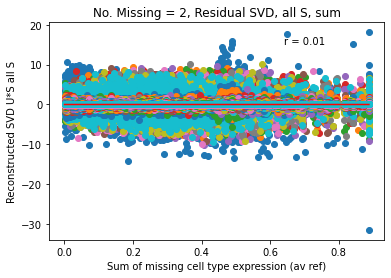

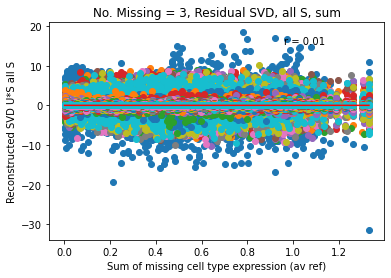

In [74]:
#sum expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS[num].columns:
        y = Recon_Mat_allS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, sum')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

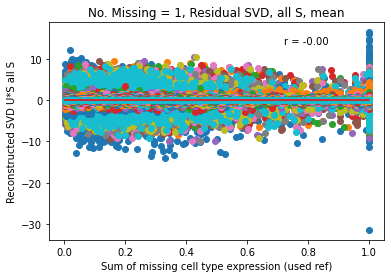

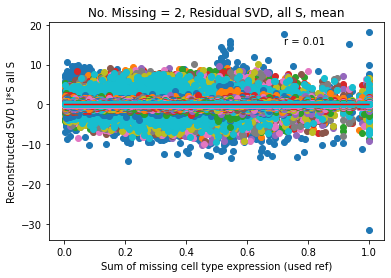

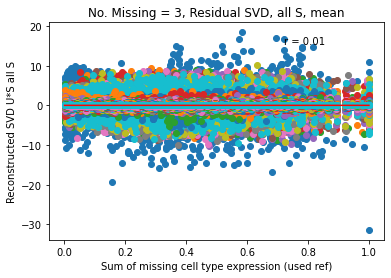

In [75]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS[num].columns:
        y = Recon_Mat_allS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

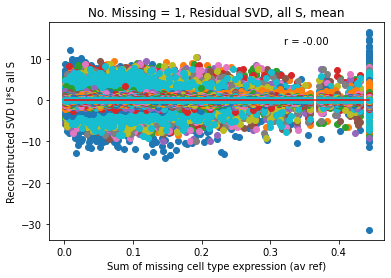

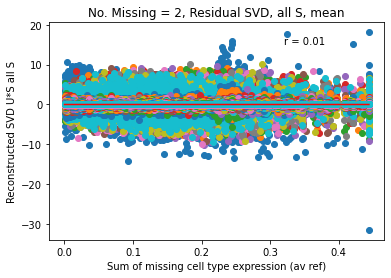

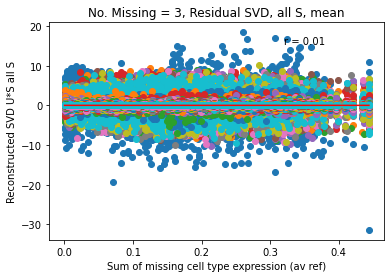

In [76]:
#mean expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS[num].columns:
        y = Recon_Mat_allS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

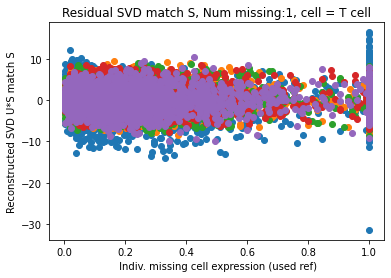

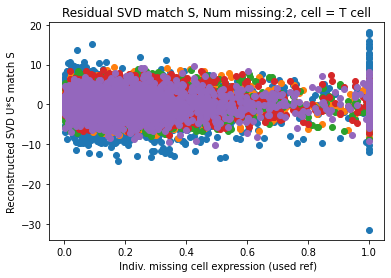

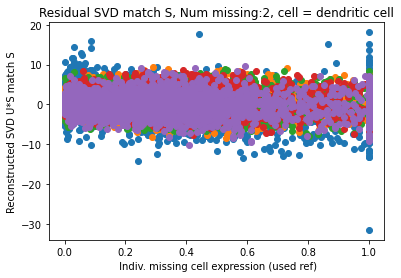

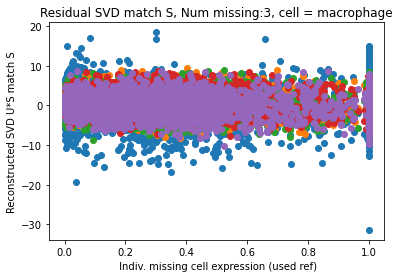

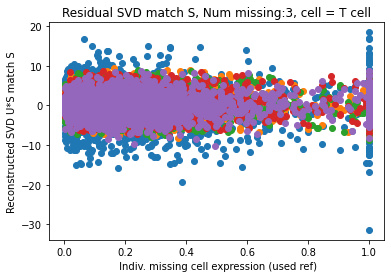

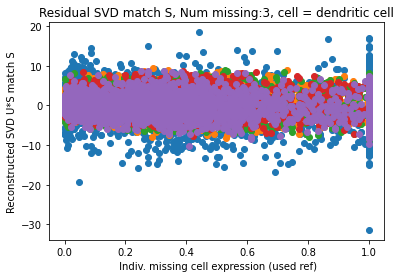

In [77]:
#Each cell type used expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        for sval in Recon_Mat_matchS[num].columns:
            y = Recon_Mat_matchS[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()            

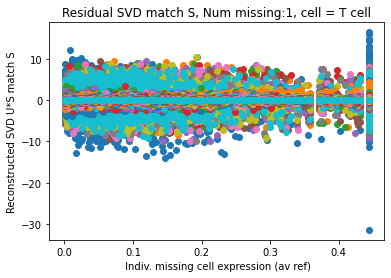

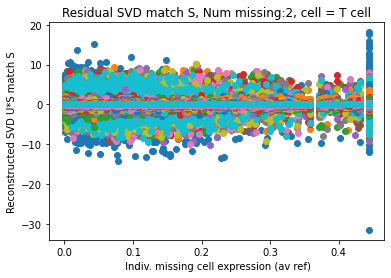

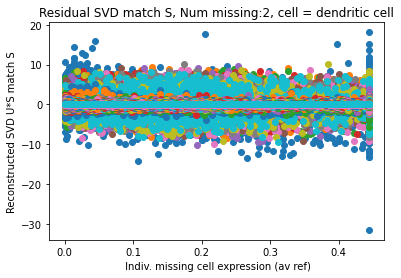

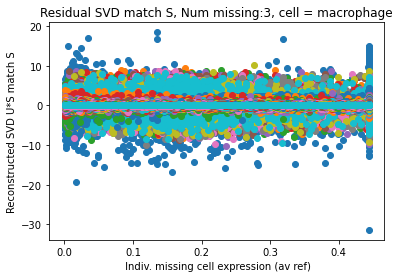

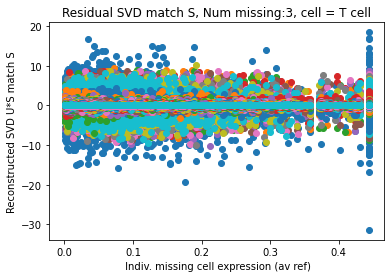

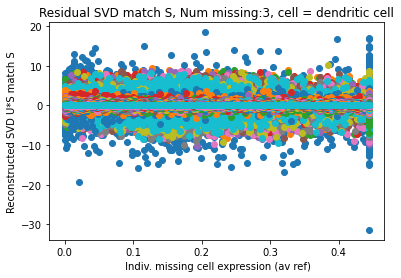

In [78]:
#Each cell type average expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_avref[num].columns:
        x = missing_cell_exp_avref[num][cell]
        for sval in Recon_Mat_allS[num].columns:
            y = Recon_Mat_allS[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (av ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()   

**Residual Diffbase**

One S:

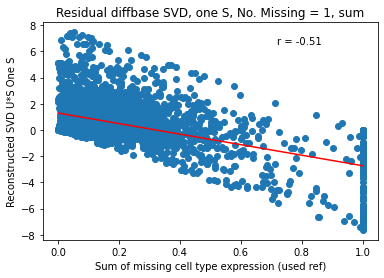

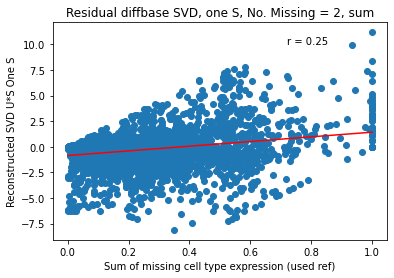

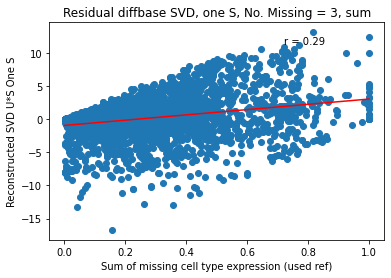

In [79]:
#one S value with mean expression of missing cell types.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    y = Recon_Mat_oneS_diffbase[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

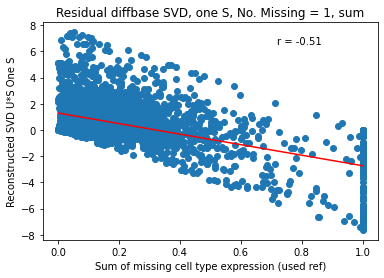

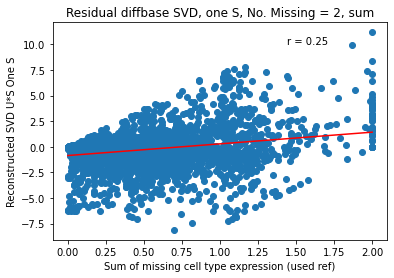

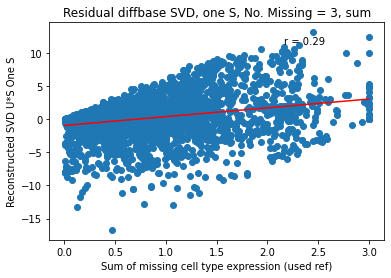

In [80]:
#one S value with sum expression of missing cell types.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    y = Recon_Mat_oneS_diffbase[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

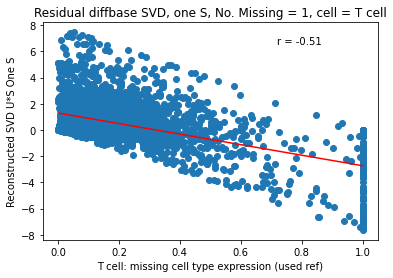

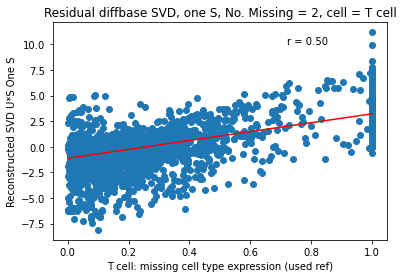

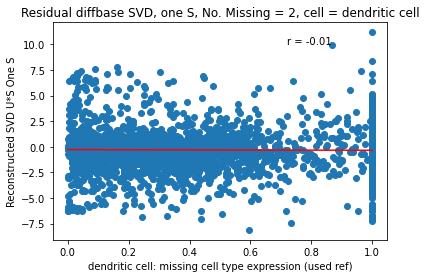

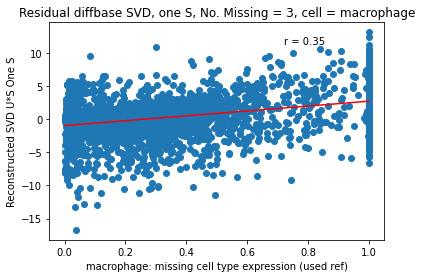

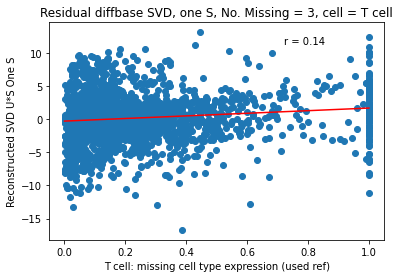

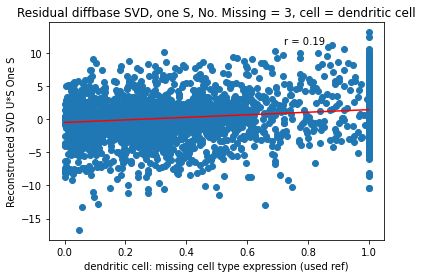

In [81]:
for num in num_missing_cells[1:]:
    for col in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][col].values
        y = Recon_Mat_oneS_diffbase[num][0].values
        plt.scatter(x,y)
        plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S One S")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

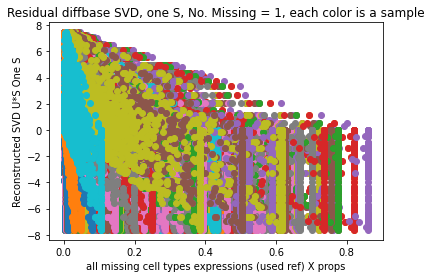

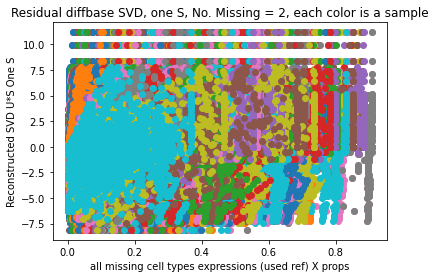

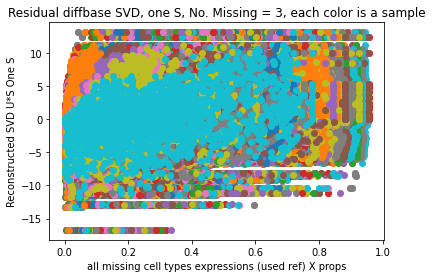

In [82]:
#Recon_mat with one S, with each sample in each individual missing cell exp X prop, used. ref.
for num in num_missing_cells[1:]:
    y = Recon_Mat_oneS_diffbase[num]
    for index,row in missing_cell_usedexp_x_prop[num].iterrows():
        x = row
        plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, each color is a sample')
    plt.xlabel(f'all missing cell types expressions (used ref) X props')
    plt.ylabel(f"Reconstructed SVD U*S One S")  
    plt.show()

Match S:

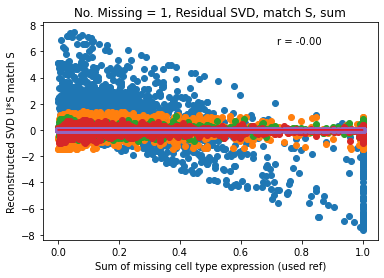

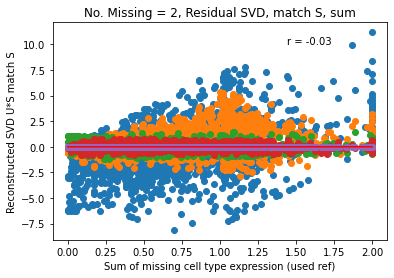

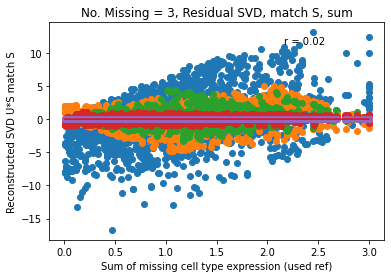

In [83]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_matchS_diffbase[num].columns:
        y = Recon_Mat_matchS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

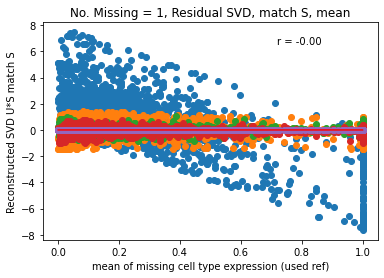

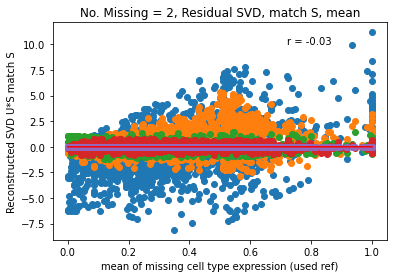

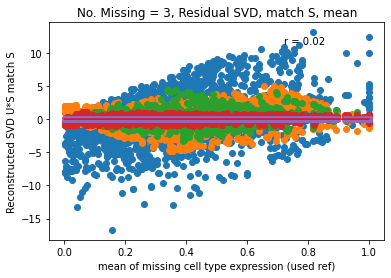

In [84]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_matchS_diffbase[num].columns:
        y = Recon_Mat_matchS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, mean')
    plt.xlabel(f'mean of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

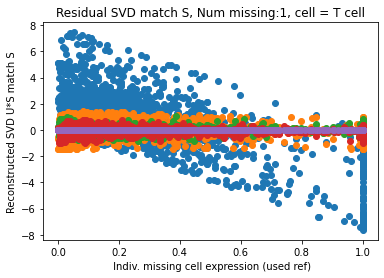

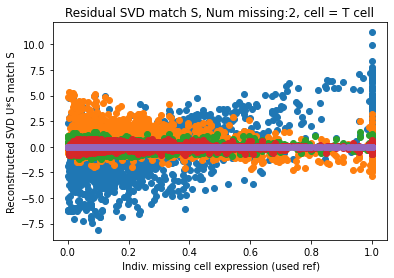

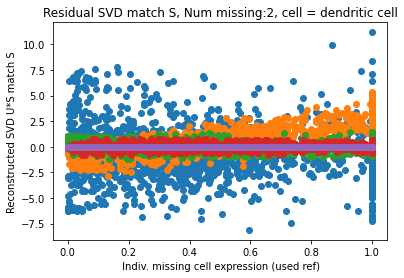

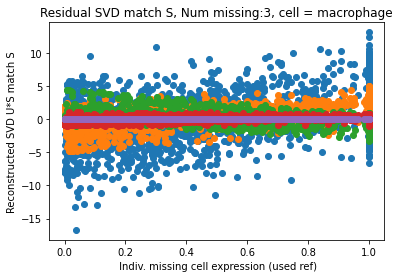

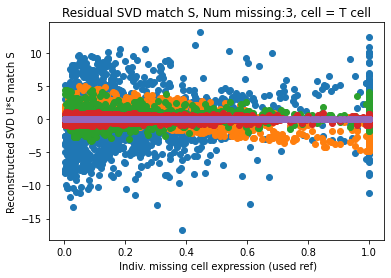

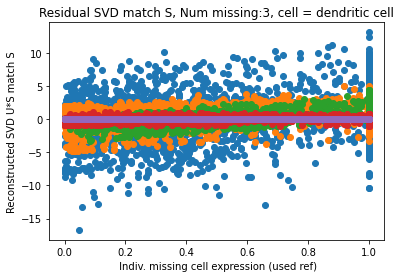

In [85]:
#Each cell type used expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        for sval in Recon_Mat_matchS_diffbase[num].columns:
            y = Recon_Mat_matchS_diffbase[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()           

All S:

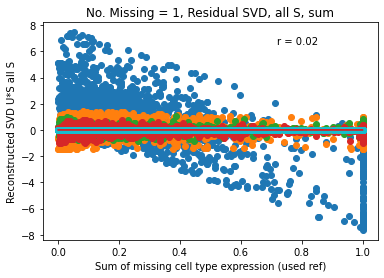

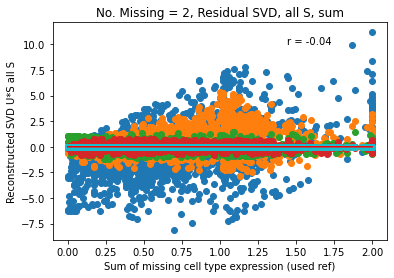

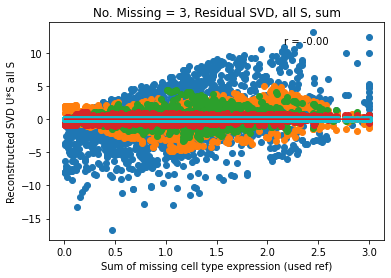

In [86]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS_diffbase[num].columns:
        y = Recon_Mat_allS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

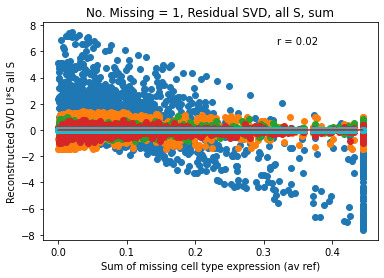

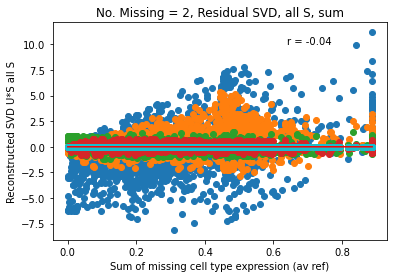

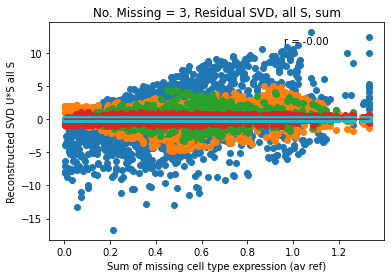

In [87]:
#sum expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS_diffbase[num].columns:
        y = Recon_Mat_allS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, sum')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

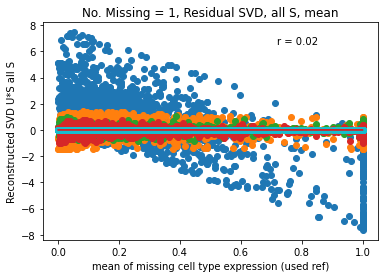

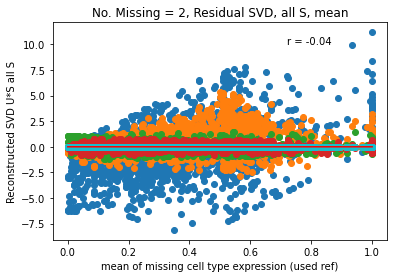

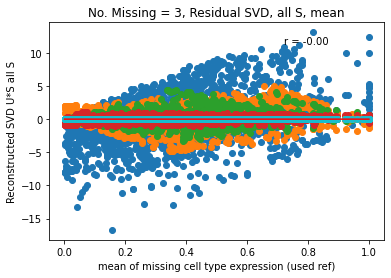

In [88]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS_diffbase[num].columns:
        y = Recon_Mat_allS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'mean of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

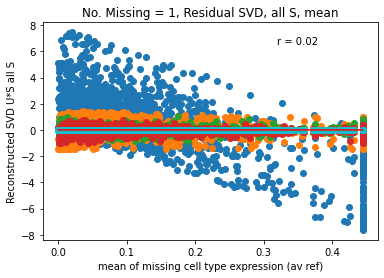

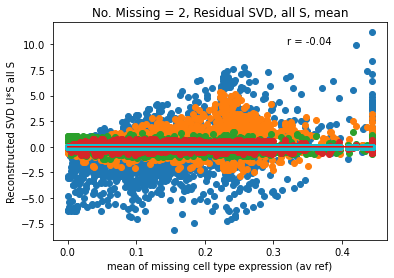

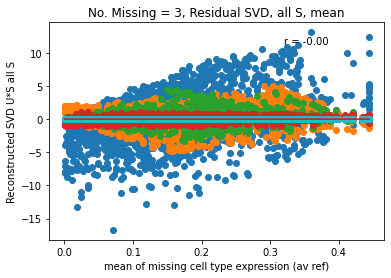

In [89]:
#mean expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS_diffbase[num].columns:
        y = Recon_Mat_allS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'mean of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

**Residual RealRef**

One S:

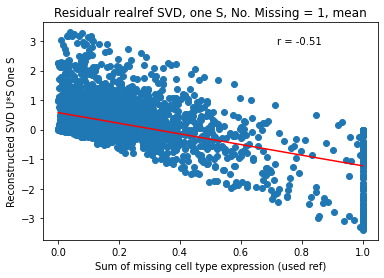

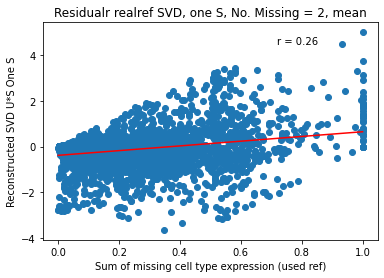

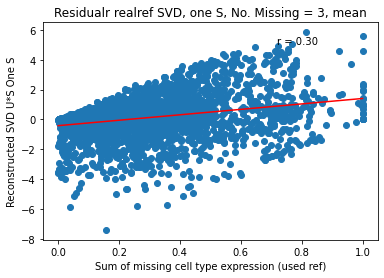

In [90]:
#one S value with mean expression of missing cell types.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    y = Recon_Mat_oneS_realref[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residualr realref SVD, one S, No. Missing = {num}, mean')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

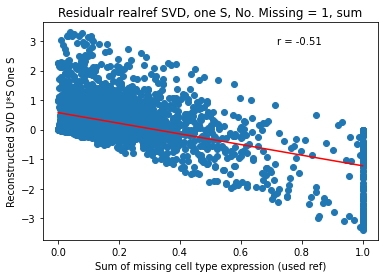

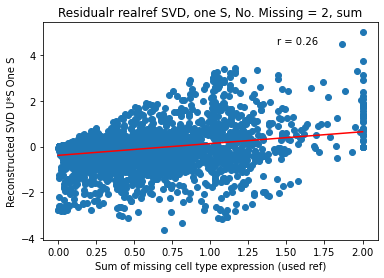

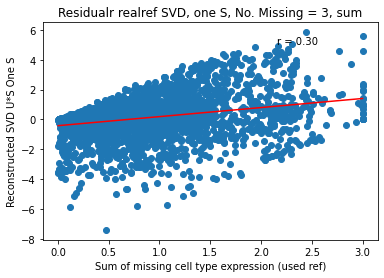

In [91]:
#one S value with sum expression of missing cell types.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    y = Recon_Mat_oneS_realref[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residualr realref SVD, one S, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

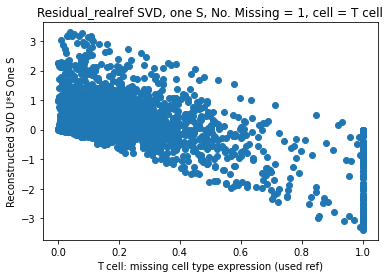

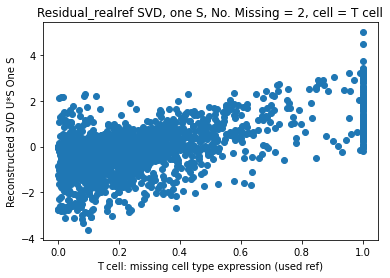

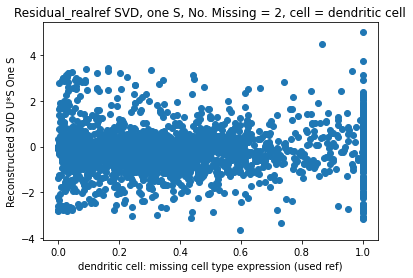

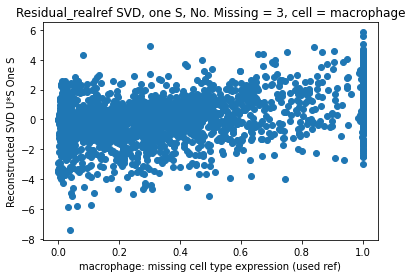

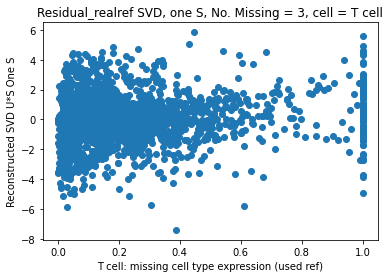

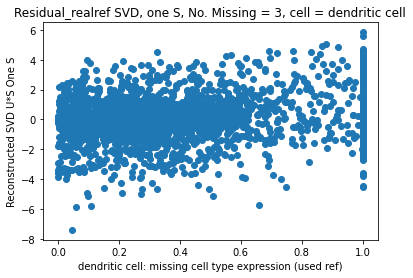

In [92]:
#one S SVD with each individual missing cell used reference expression
for num in num_missing_cells[1:]:
    y = Recon_Mat_oneS_realref[num]
    for col in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][col].values
        plt.scatter(x,y)
        plt.title(f'Residual_realref SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S One S")
        plt.show()

Match S:

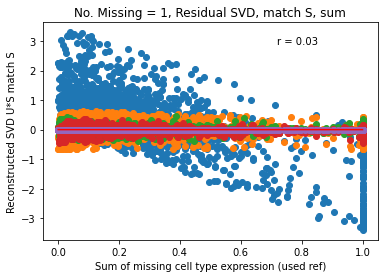

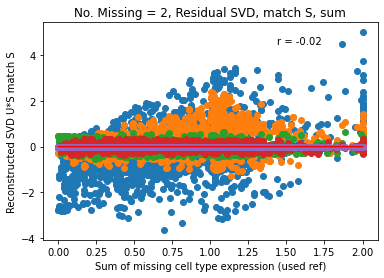

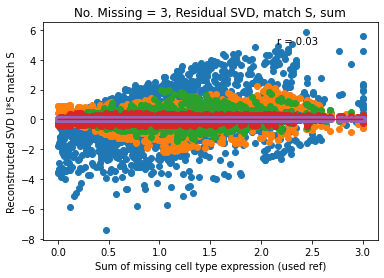

In [93]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_matchS_realref[num].columns:
        y = Recon_Mat_matchS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show() 

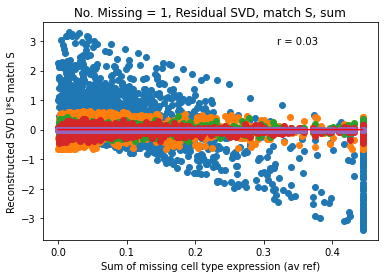

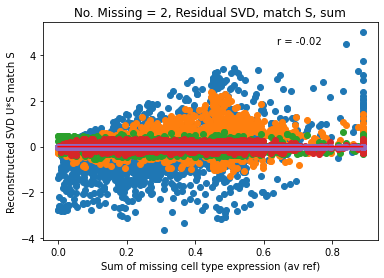

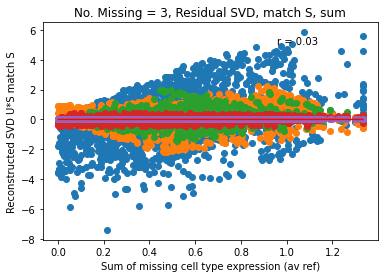

In [94]:
#sum expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    for cellcol in Recon_Mat_matchS_realref[num].columns:
        y = Recon_Mat_matchS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

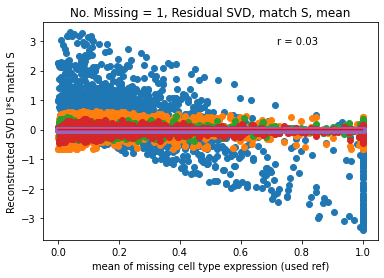

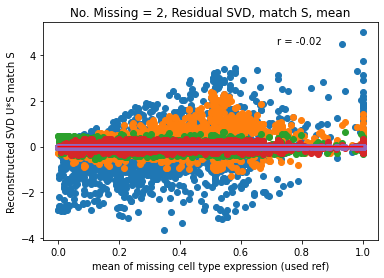

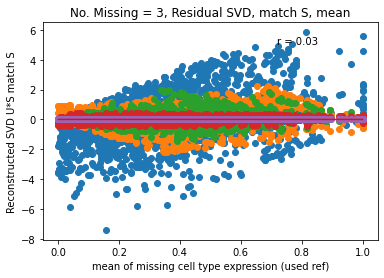

In [95]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_matchS_realref[num].columns:
        y = Recon_Mat_matchS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, mean')
    plt.xlabel(f'mean of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

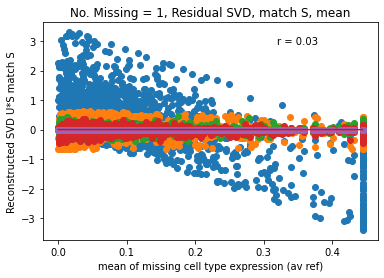

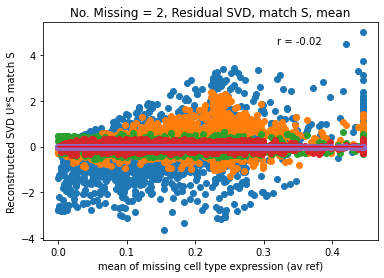

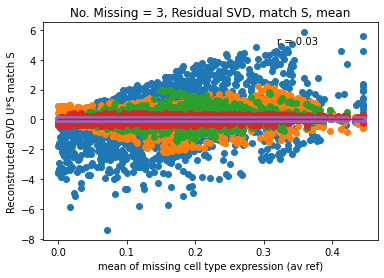

In [96]:
#mean expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].mean(axis=1).values
    for cellcol in Recon_Mat_matchS_realref[num].columns:
        y = Recon_Mat_matchS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, mean')
    plt.xlabel(f'mean of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

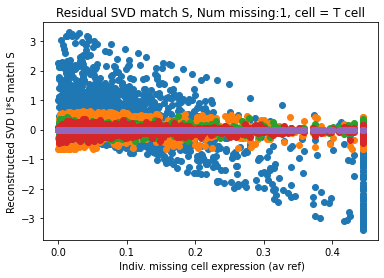

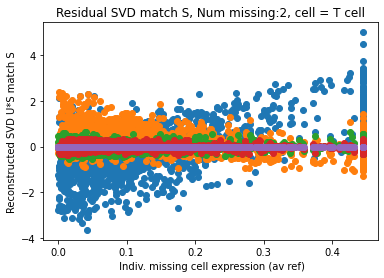

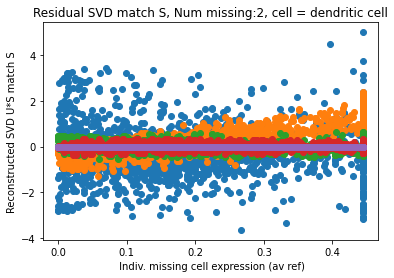

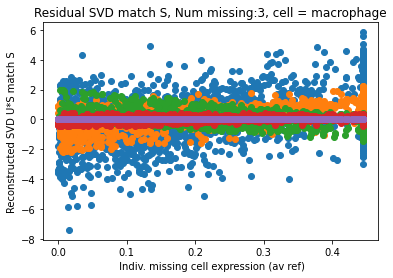

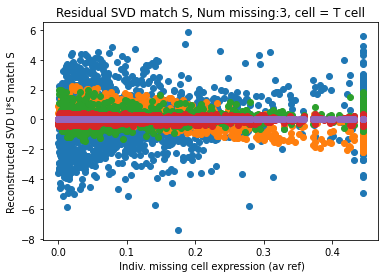

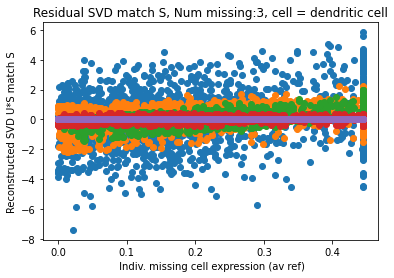

In [97]:
#Each cell type average expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_avref[num].columns:
        x = missing_cell_exp_avref[num][cell]
        for sval in Recon_Mat_matchS_realref[num].columns:
            y = Recon_Mat_matchS_realref[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (av ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()   

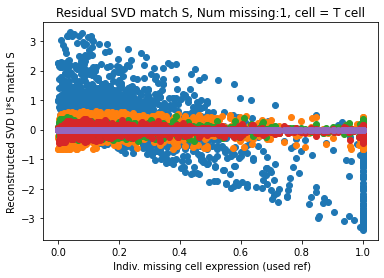

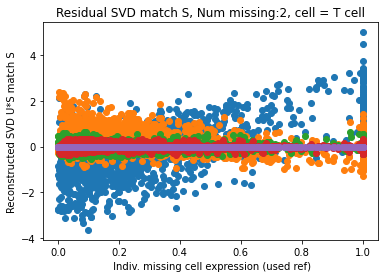

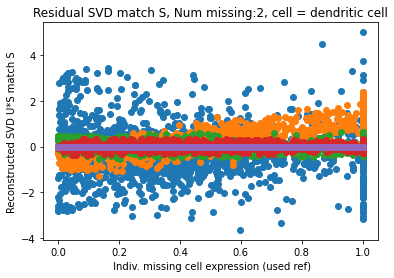

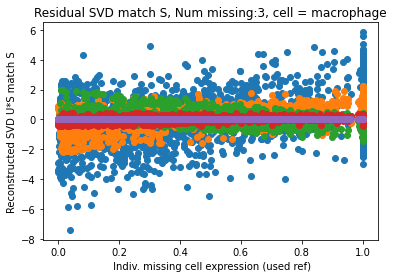

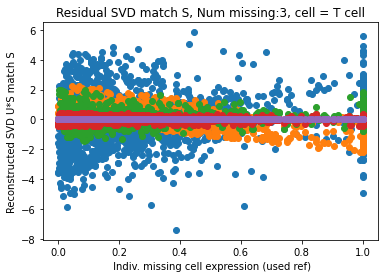

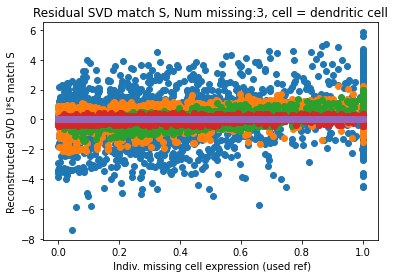

In [98]:
#Each cell type used expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        for sval in Recon_Mat_matchS_realref[num].columns:
            y = Recon_Mat_matchS_realref[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()   

All S:

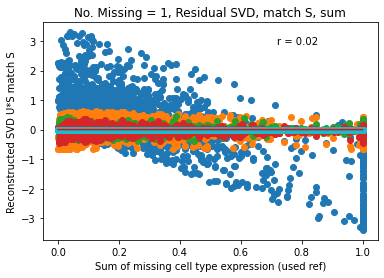

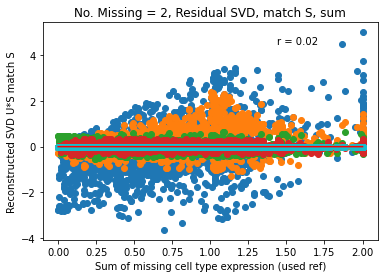

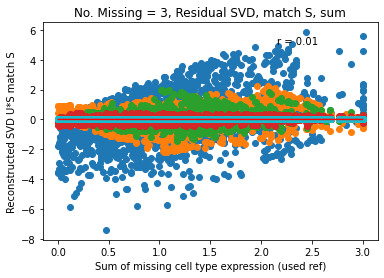

In [99]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS_realref[num].columns:
        y = Recon_Mat_allS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

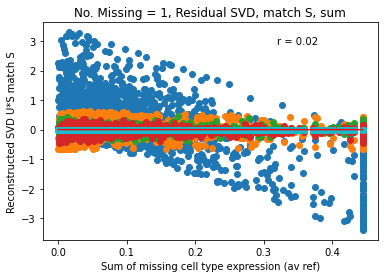

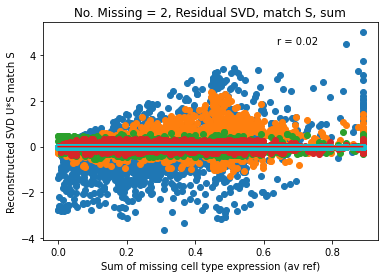

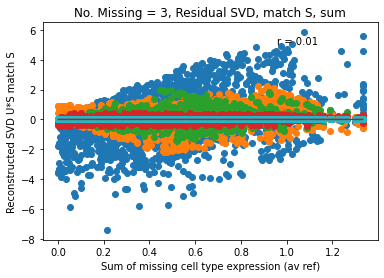

In [100]:
#sum expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS_realref[num].columns:
        y = Recon_Mat_allS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

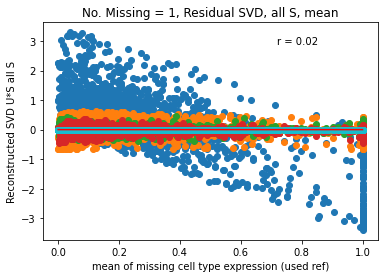

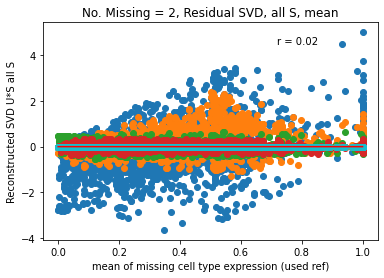

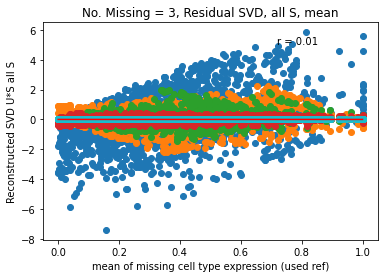

In [101]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS_realref[num].columns:
        y = Recon_Mat_allS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'mean of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

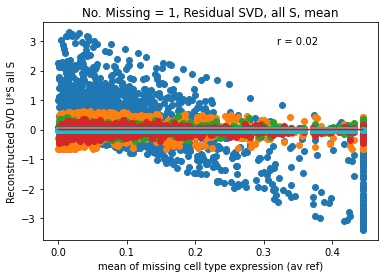

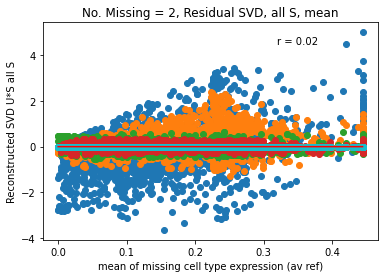

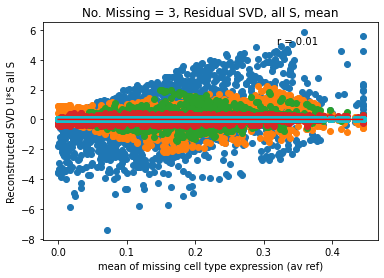

In [102]:
#mean expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS_realref[num].columns:
        y = Recon_Mat_allS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'mean of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

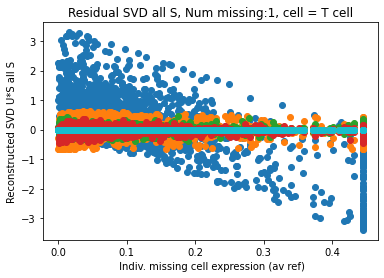

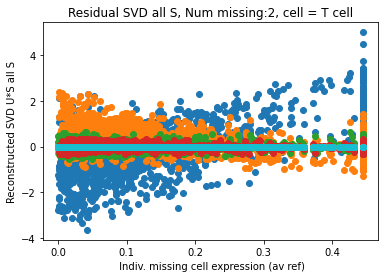

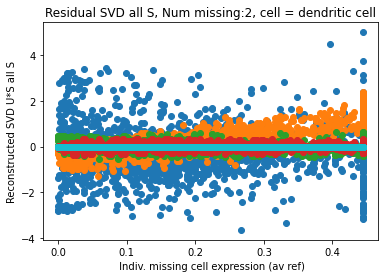

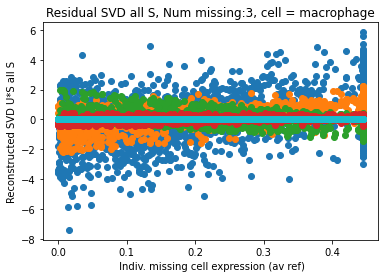

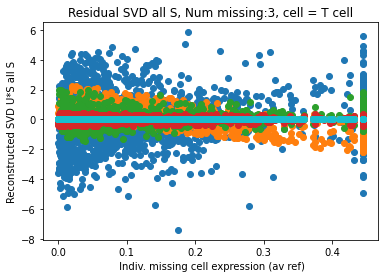

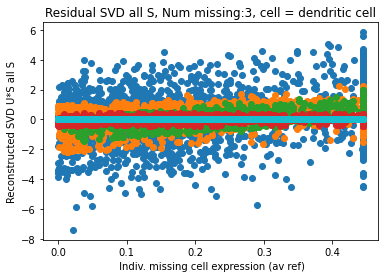

In [103]:
#Each cell type average expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_avref[num].columns:
        x = missing_cell_exp_avref[num][cell]
        for sval in Recon_Mat_allS_realref[num].columns:
            y = Recon_Mat_allS_realref[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD all S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (av ref)')
        plt.ylabel(f"Reconstructed SVD U*S all S")
        plt.show()   

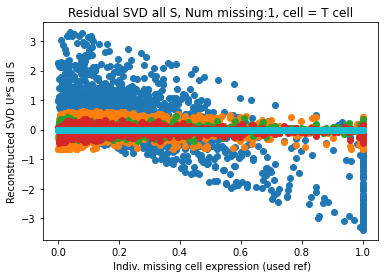

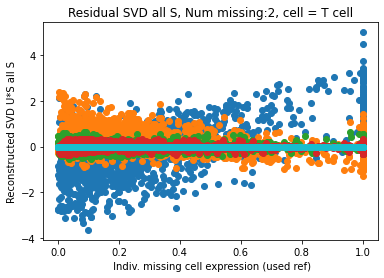

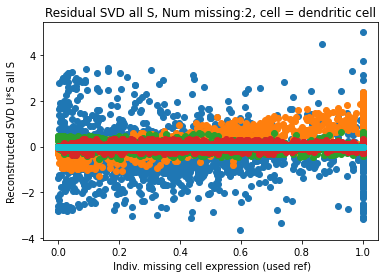

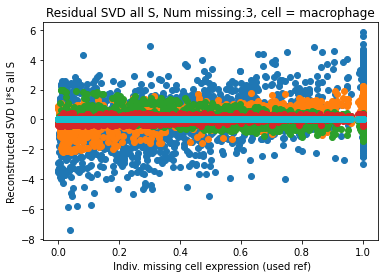

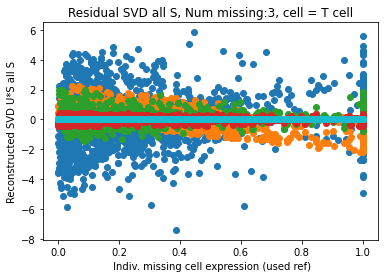

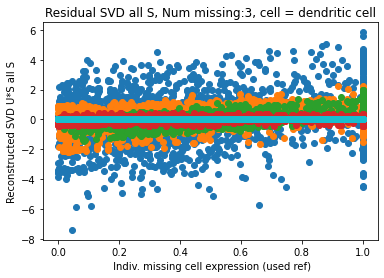

In [104]:
#Each cell type used expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        for sval in Recon_Mat_allS_realref[num].columns:
            y = Recon_Mat_allS_realref[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD all S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S all S")
        plt.show()   

## **PCA**

Calculating PCA for each Residual and Percent of Variance Explained

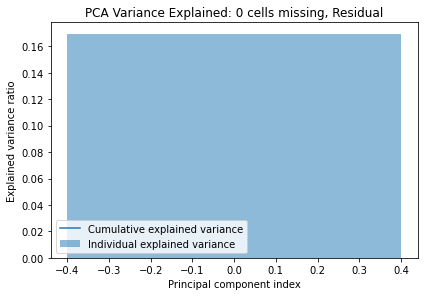

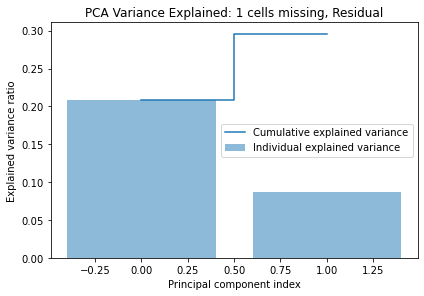

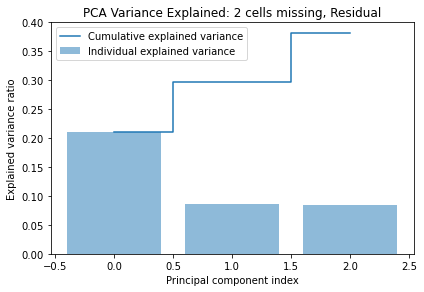

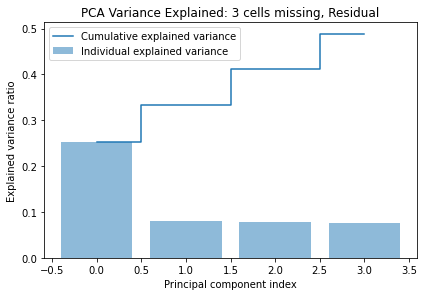

In [105]:
pca_res = dict()
for num in num_cells_missing:
    df = residuals[num].T #transposing to get length of genes instead of samples
    fit = PCA(n_components= num + 1)
    pca_results = fit.fit_transform(df.values)

    exp_var_pca = fit.explained_variance_ratio_
    cum_sum_eigenvalues = np.cumsum(exp_var_pca)

    ## plot variance explained
    plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
    plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal component index')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.title(f"PCA Variance Explained: {num} cells missing, Residual")
    plt.show()
    pca_res[num] = pd.DataFrame(pca_results)

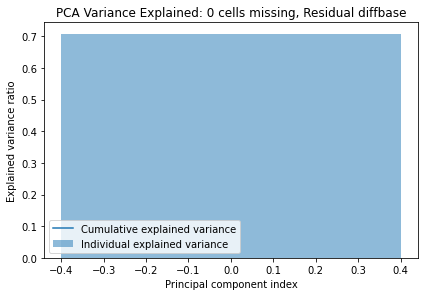

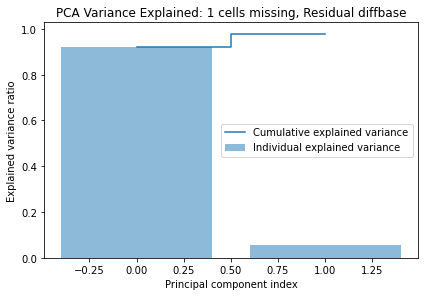

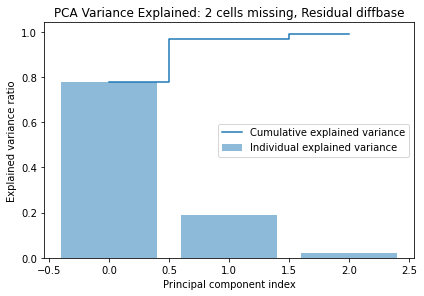

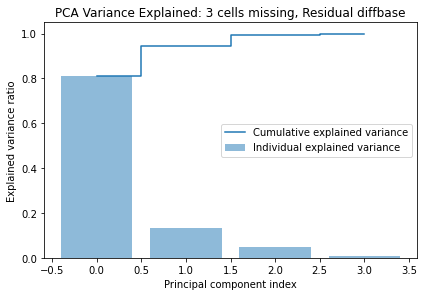

In [106]:
pca_diffbase = dict()
for num in num_cells_missing:
    df = residuals_diffbase[num].T #transposing to get length of genes instead of samples
    fit = PCA(n_components=num + 1)
    pca_results = fit.fit_transform(df.values)

    exp_var_pca = fit.explained_variance_ratio_
    cum_sum_eigenvalues = np.cumsum(exp_var_pca)

    ## plot variance explained
    plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
    plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal component index')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.title(f"PCA Variance Explained: {num} cells missing, Residual diffbase")
    plt.show()
    pca_diffbase[num] = pd.DataFrame(pca_results)

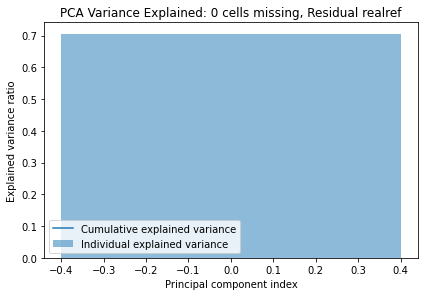

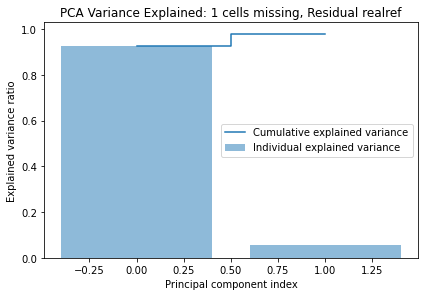

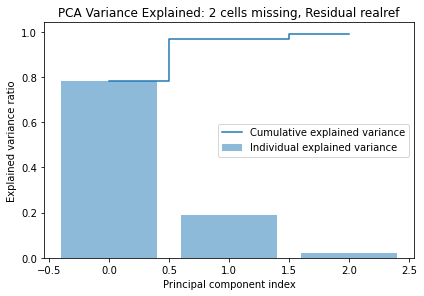

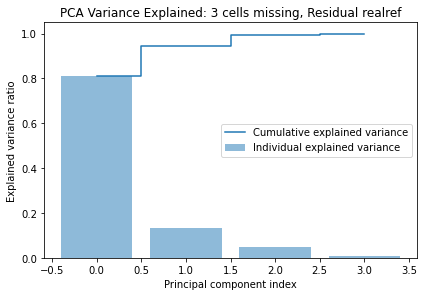

In [107]:
pca_realref = dict()
for num in num_cells_missing: 
    df = residuals_realref[num].T #transposing to get length of genes instead of samples
    fit = PCA(n_components=num + 1)
    pca_results = fit.fit_transform(df.values)

    exp_var_pca = fit.explained_variance_ratio_
    cum_sum_eigenvalues = np.cumsum(exp_var_pca)

    ## plot variance explained
    plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
    plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal component index')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.title(f"PCA Variance Explained: {num} cells missing, Residual realref")
    plt.show()
    pca_realref[num] = pd.DataFrame(pca_results)

Analyzing PCA Results

Residual

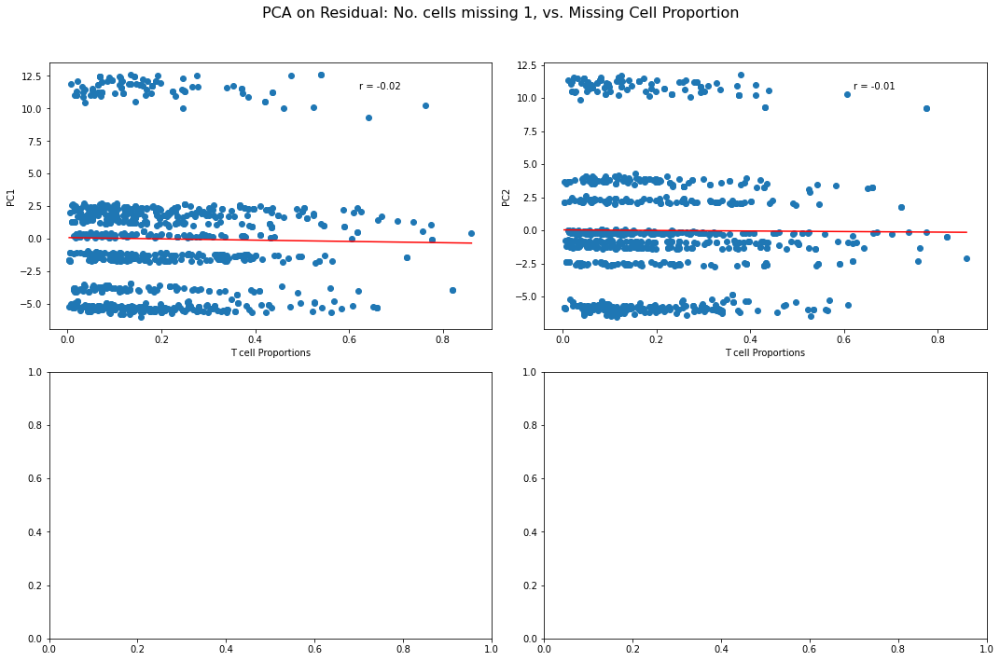

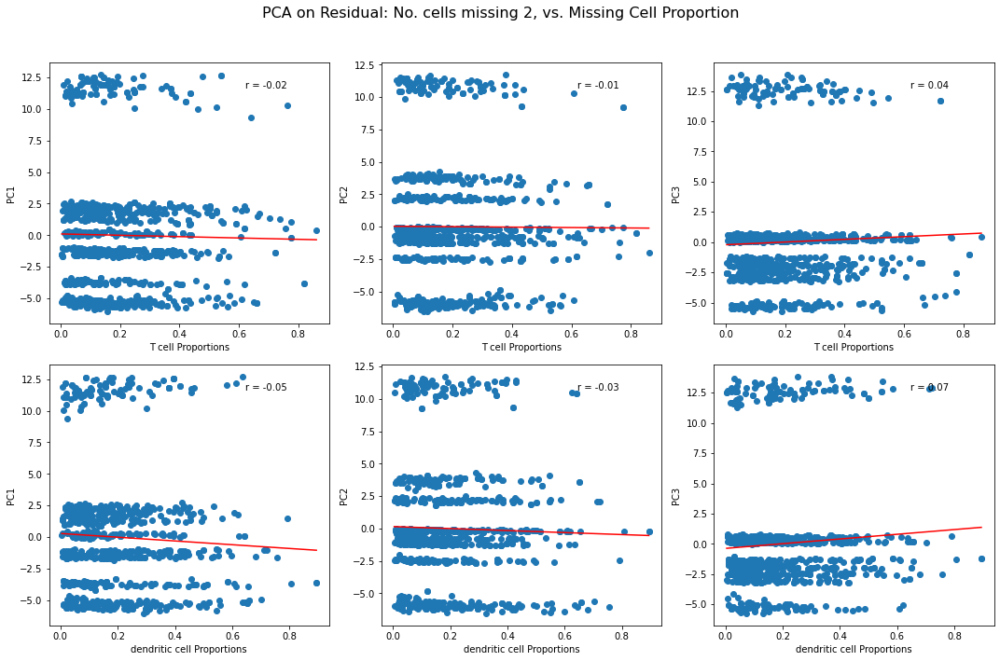

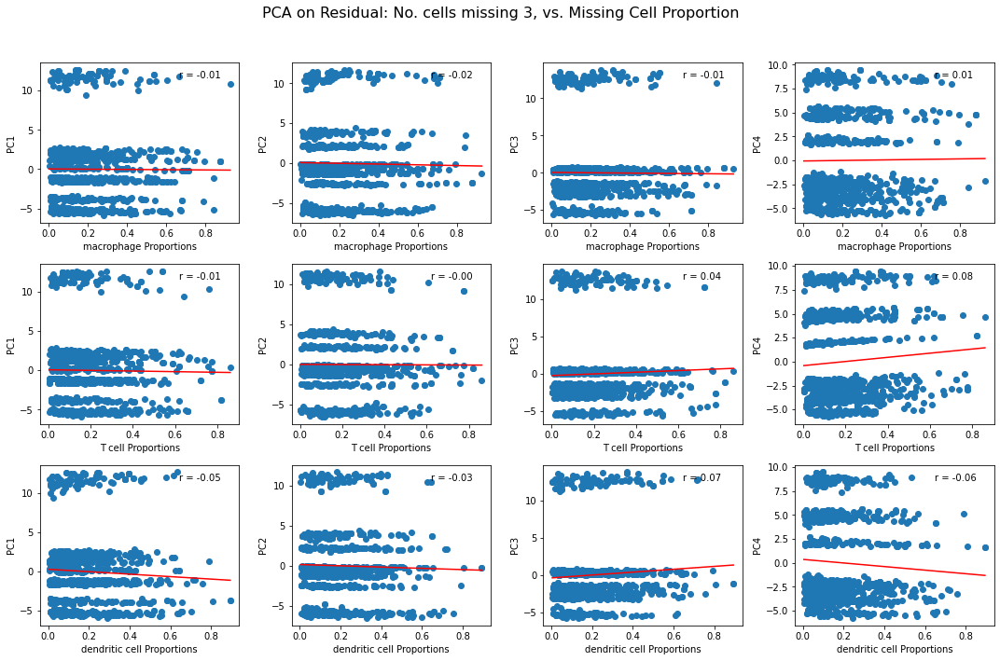

In [174]:
#pca on residual, Starting with pca by sample, not by gene, 
# compared to the proportions of missing cell types.
for num in num_cells_missing[1:]:
    num_pca = num + 1
    pca = PCA(n_components = num_pca)
    res_pca_df = pca.fit_transform(residuals[num])
    res_pca_df = pd.DataFrame(res_pca_df)#each missing cell type expression with each factor
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_prop[num].columns) 
    num_cols = num_pca
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'PCA on Residual: No. cells missing {num}, vs. Missing Cell Proportion', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_prop[num].columns):
        for j in range(num_pca):
            x = list(missing_cell_prop[num][cell_type])
            y = list(res_pca_df[j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Proportions')
            ax.set_ylabel(f'PC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If pca works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

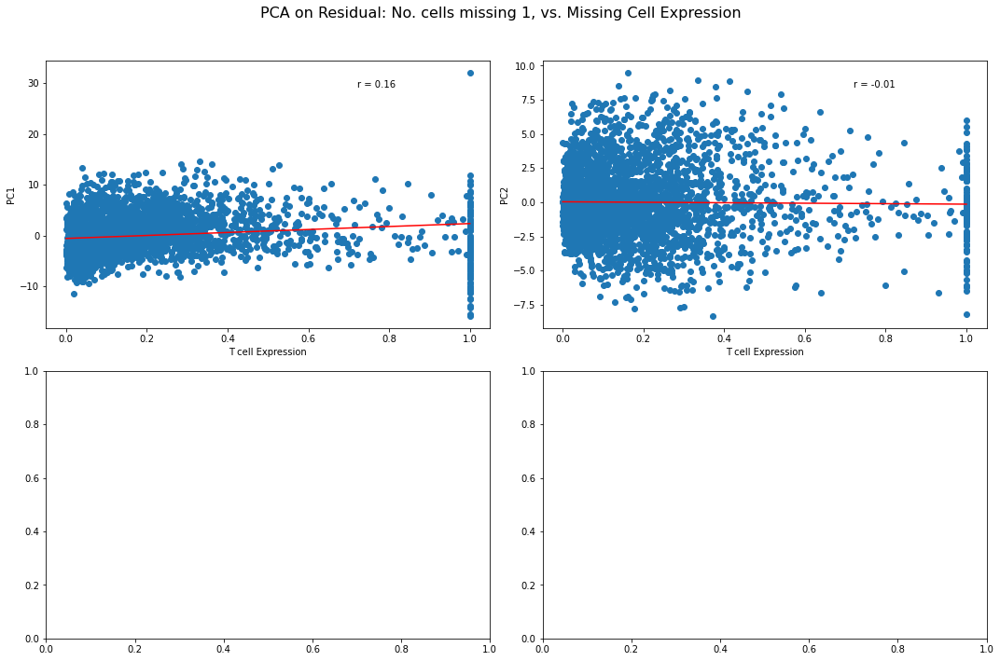

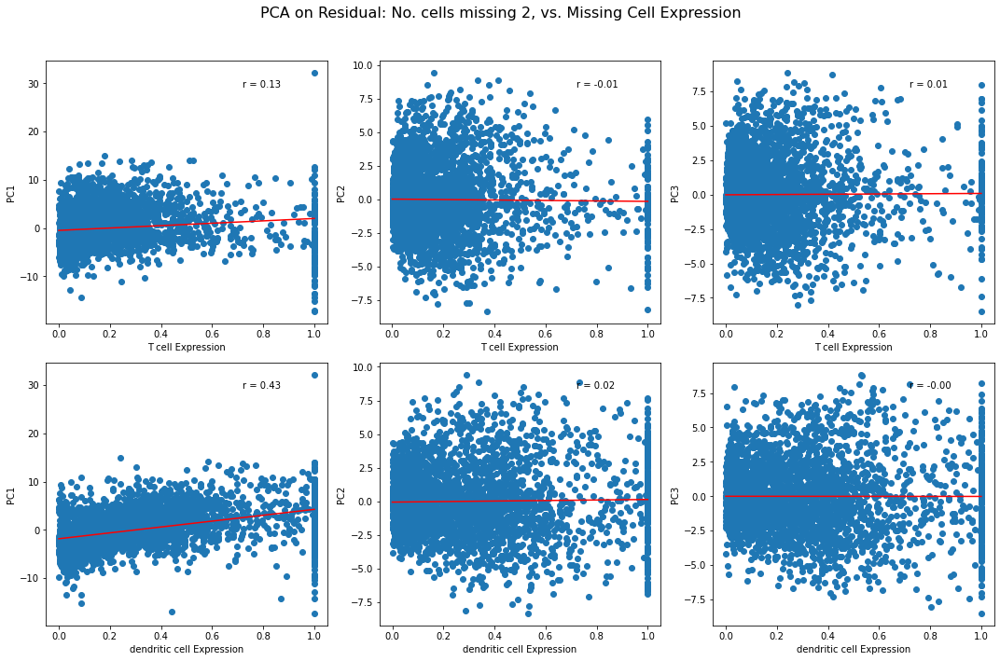

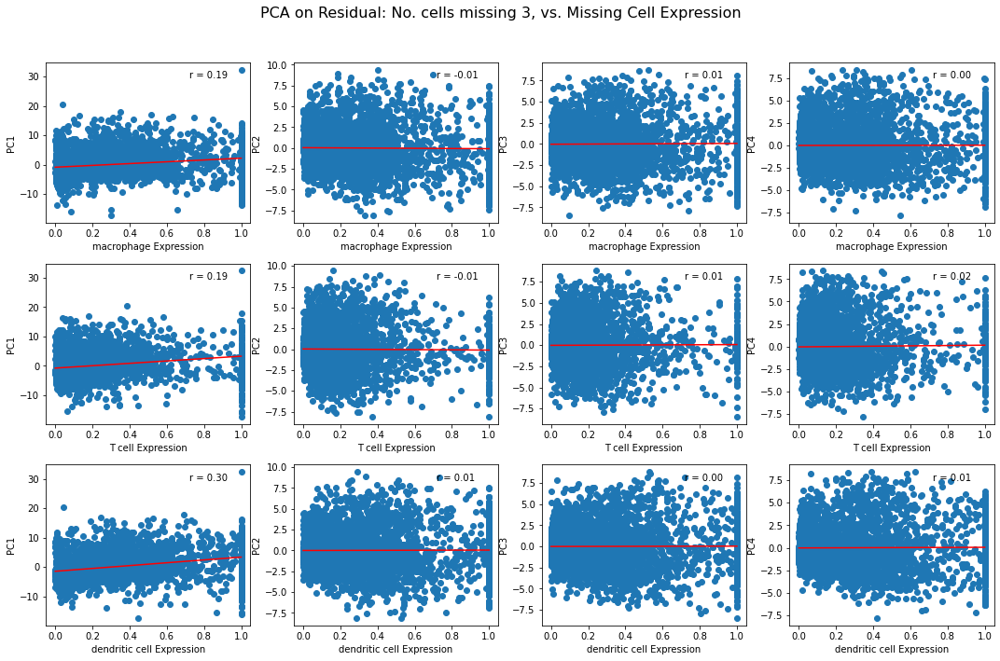

In [109]:
#pca on residual, Starting with pca by sample, not by gene, 
# compared to the Expression of missing cell types.
for num in num_cells_missing[1:]:
    num_pca = num + 1
    pca = PCA(n_components = num_pca)
    res_pca_df = pca.fit_transform(residuals[num].T)
    res_pca_df = pd.DataFrame(res_pca_df)#each missing cell type expression with each factor
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_exp_usedref[num].columns) 
    num_cols = num_pca
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'PCA on Residual: No. cells missing {num}, vs. Missing Cell Expression', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_exp_usedref[num].columns):
        for j in range(num_pca):
            x = list(missing_cell_exp_usedref[num][cell_type])
            y = list(res_pca_df[j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Expression')
            ax.set_ylabel(f'PC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If pca works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

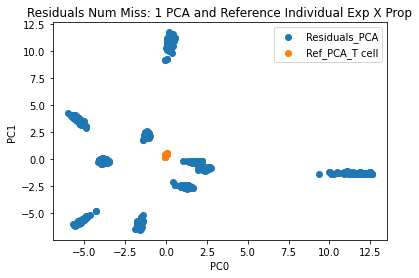

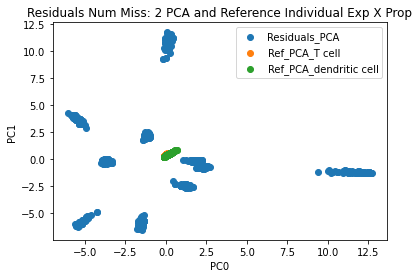

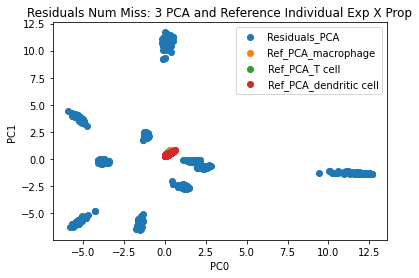

In [110]:
#PCA of Residual with Each missing cell's used exp * prop
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    pca = PCA(n_components=5)
    pseudos_pca = pca.fit_transform(residuals[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC0")
    plt.ylabel("PC1")
    plt.legend()
    plt.show()

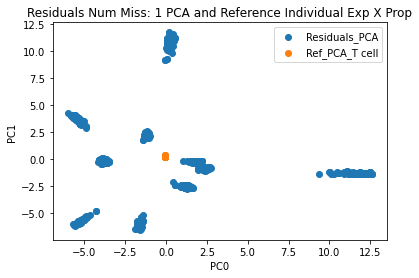

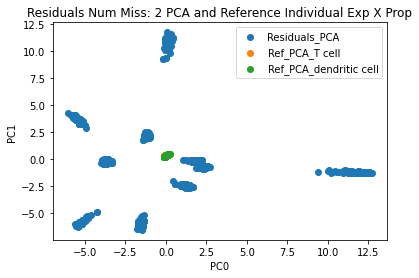

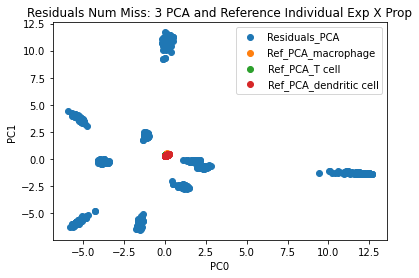

In [111]:
#PCA of Residual with Each missing cell's av exp * prop
for num in num_missing_cells[1:]:
    cells_dict = avex_prop_individual[num]
    pca = PCA(n_components = 4)
    pseudos_pca = pca.fit_transform(residuals[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC0")
    plt.ylabel("PC1")
    plt.legend()
    plt.show()

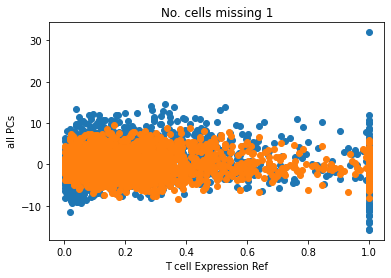

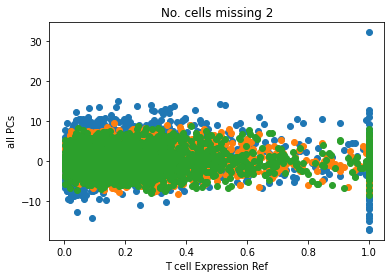

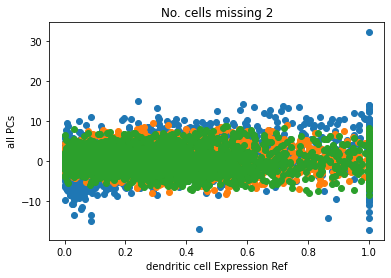

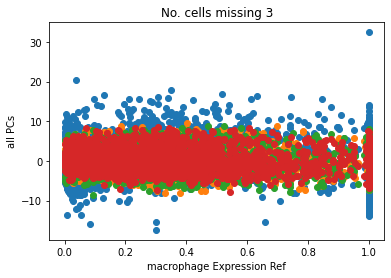

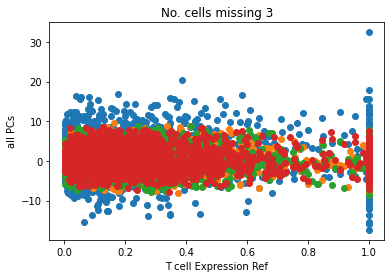

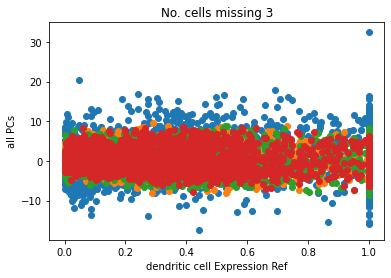

In [112]:
#each missing cell type expression with each PC
for num in num_missing_cells[1:]:
    for column in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][column] #each missing cell type
        for pc in pca_res[num].columns: #each PC
            y = pca_res[num][pc]
            plt.scatter(x,y)
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{column} Expression Ref')
        plt.ylabel(f"all PCs")
        plt.show()

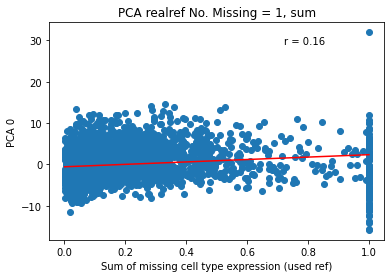

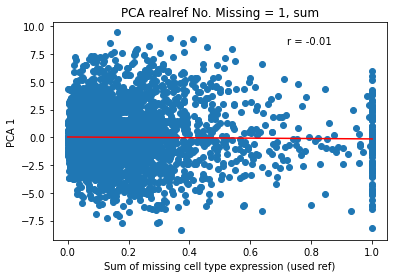

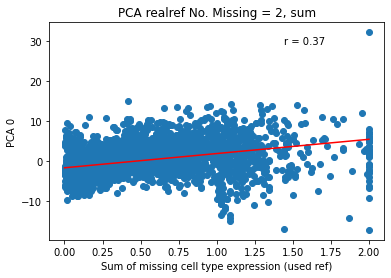

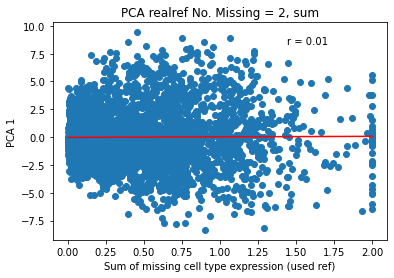

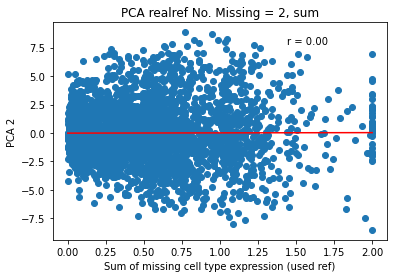

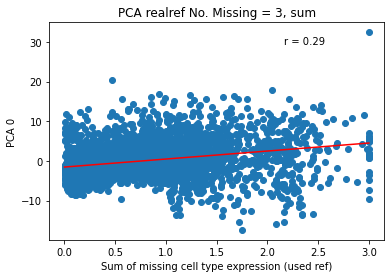

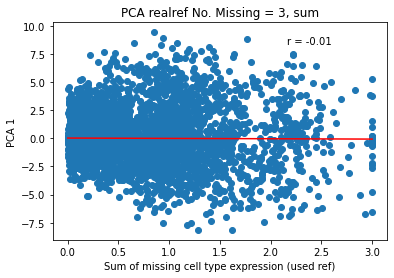

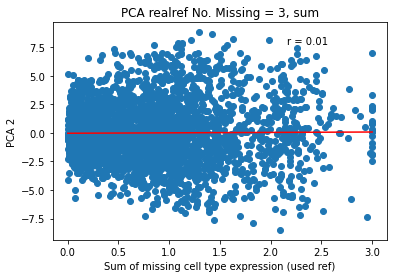

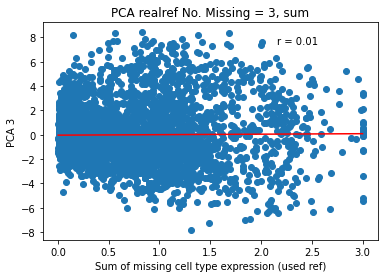

In [113]:
#Each missing cell type expression summed with each PC 
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for number in range(0,num+1):
        y = pca_res[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (used ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

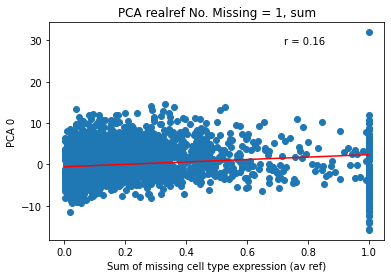

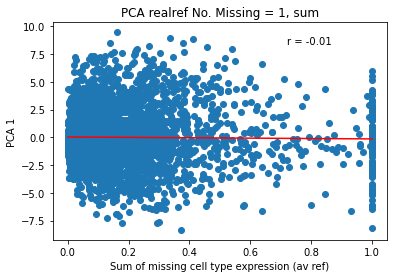

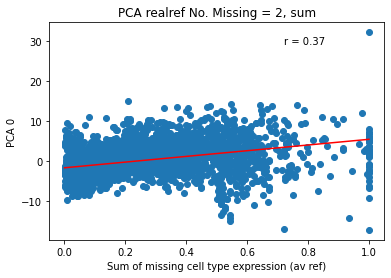

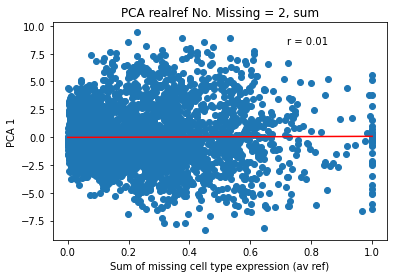

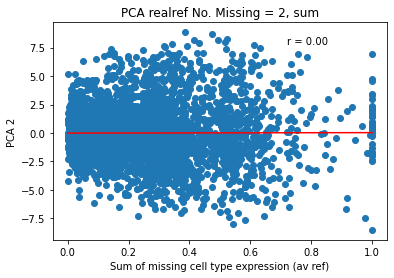

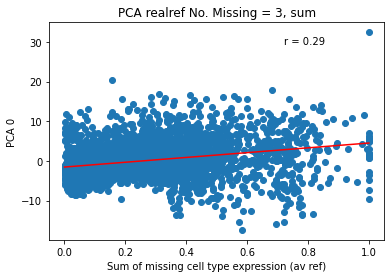

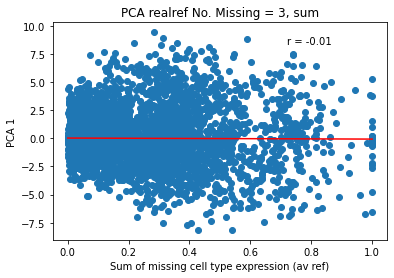

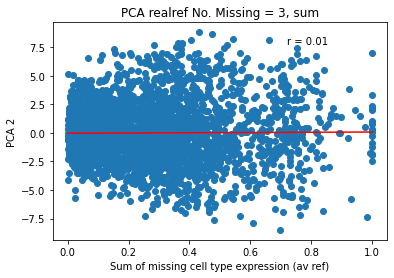

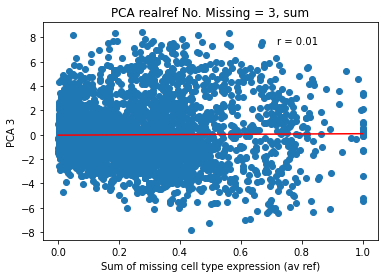

In [114]:
#same as above, but with average instead of sum:
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for number in range(0,num+1):
        y = pca_res[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (av ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

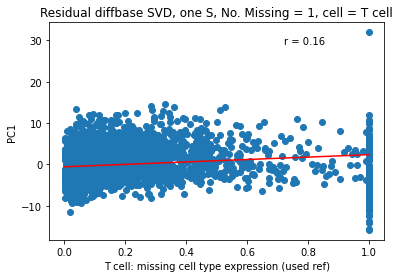

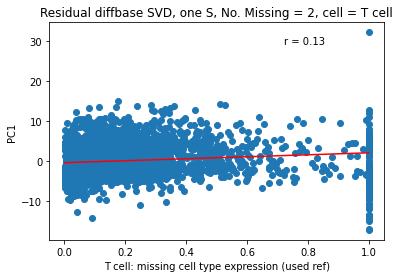

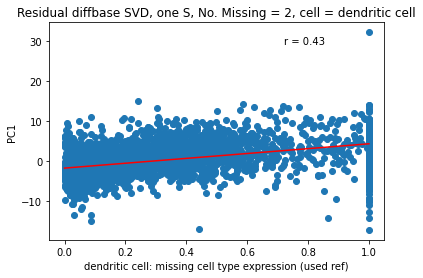

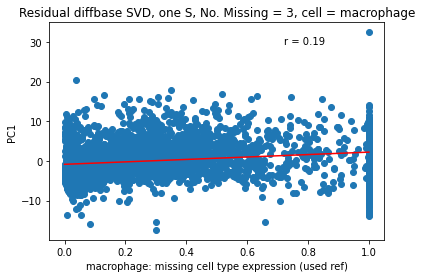

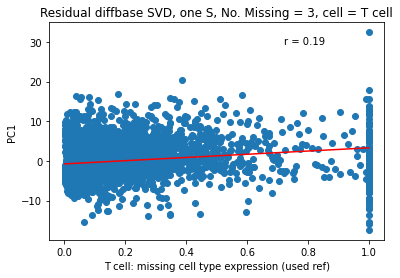

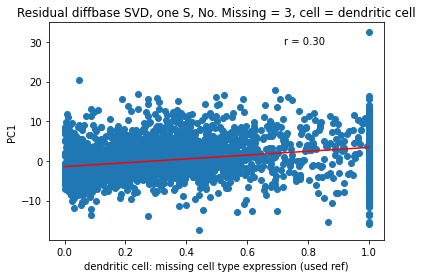

In [115]:
#Just the first PC with each cell type
for num in num_missing_cells[1:]:
    for col in missing_cell_exp_usedref[num].columns: #each cell type
        x = missing_cell_exp_usedref[num][col]
        y= pca_res[num][0] #with PC0
        plt.scatter(x,y)
        plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"PC1")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

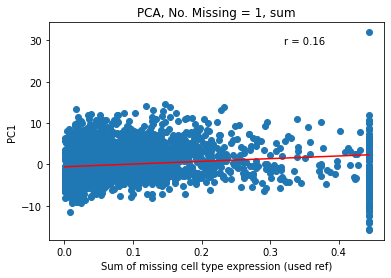

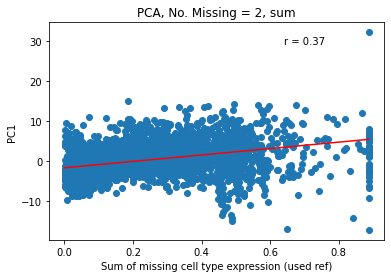

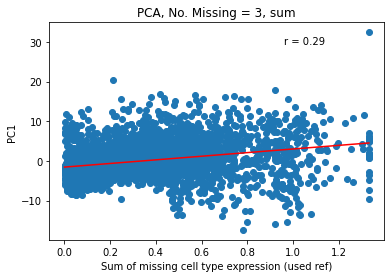

In [116]:
#just the firsty PC with the SUM of all missing cell types expression
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    y= pca_res[num][0]
    plt.scatter(x,y)
    plt.title(f'PCA, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"PC1")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

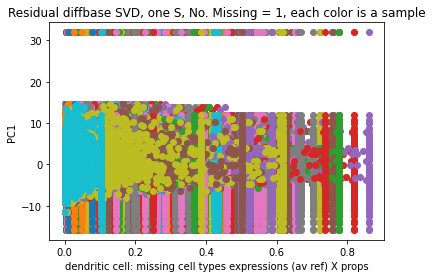

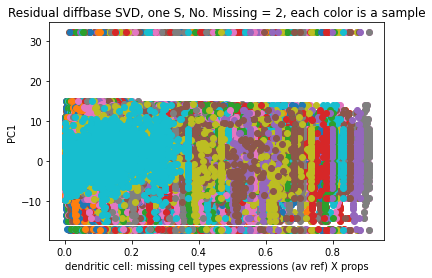

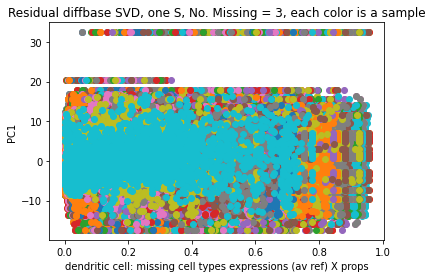

In [117]:
#combined missing cell types expression X proportions, each sample with PC0
for num in num_missing_cells[1:]:
    for index,row in missing_cell_usedexp_x_prop[num].iterrows(): #each sample 
        x = row.values
        y= pca_res[num][0] #with PC0
        plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, each color is a sample')
    plt.xlabel(f'{col}: missing cell types expressions (av ref) X props')
    plt.ylabel(f"PC1")
    plt.show()

Residual diffbase

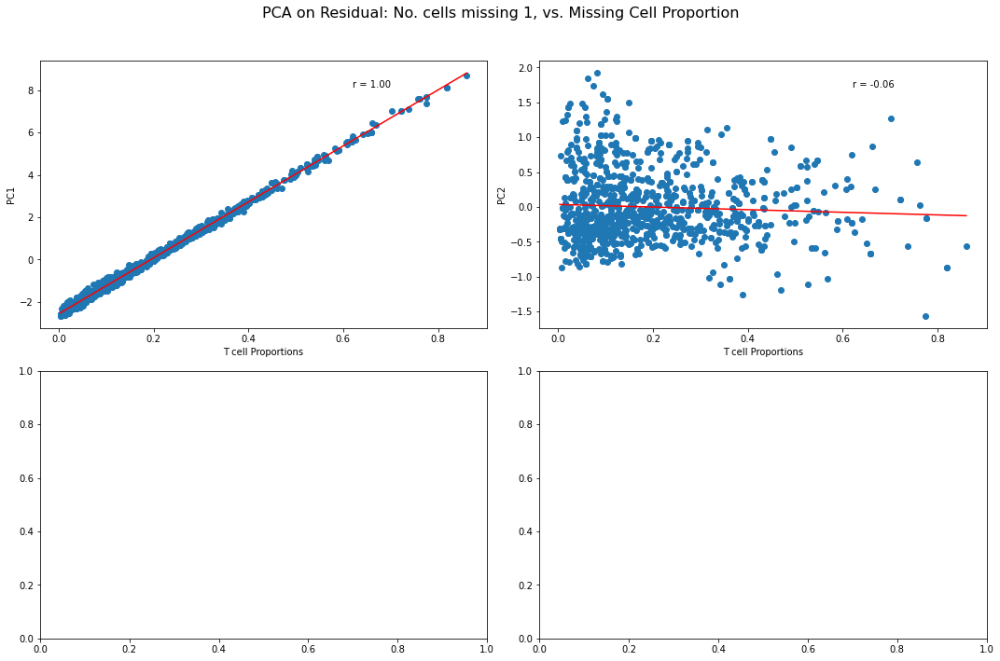

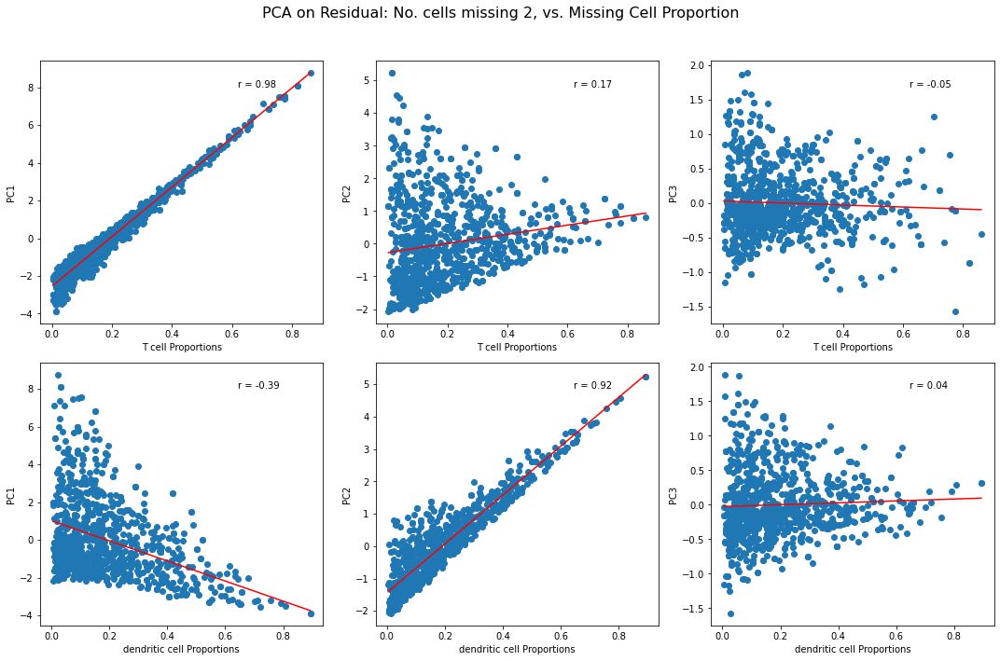

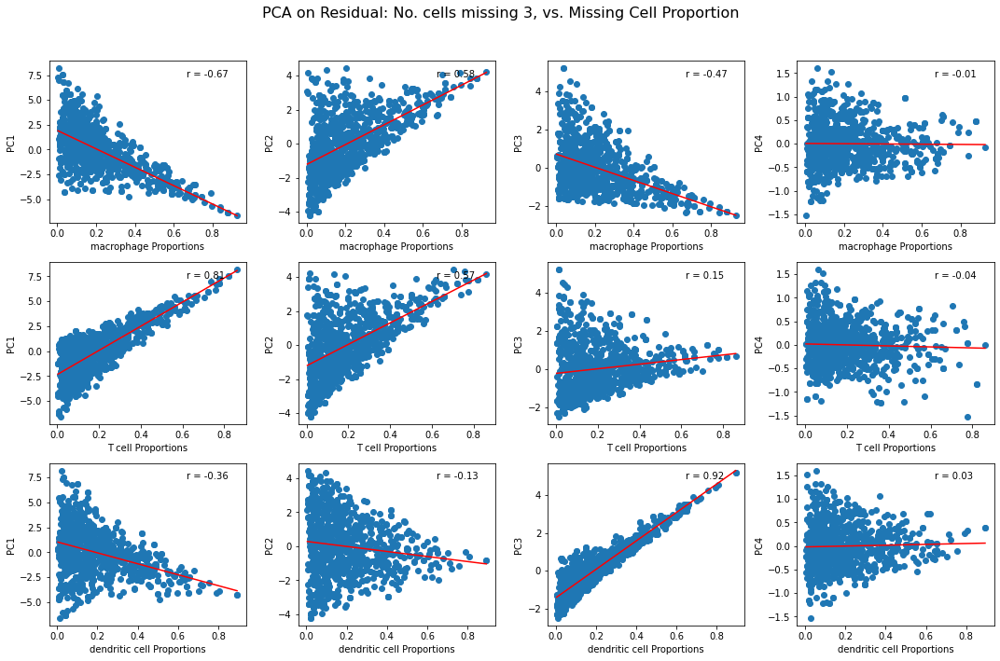

In [118]:
#pca on residual, Starting with pca by sample, not by gene, 
# compared to the proportions of missing cell types.
for num in num_cells_missing[1:]:
    num_pca = num + 1
    pca = PCA(n_components = num_pca)
    res_pca_df = pca.fit_transform(residuals_diffbase[num])
    res_pca_df = pd.DataFrame(res_pca_df)#each missing cell type expression with each factor
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_prop[num].columns) 
    num_cols = num_pca
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'PCA on Residual: No. cells missing {num}, vs. Missing Cell Proportion', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_prop[num].columns):
        for j in range(num_pca):
            x = list(missing_cell_prop[num][cell_type])
            y = list(res_pca_df[j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Proportions')
            ax.set_ylabel(f'PC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If pca works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

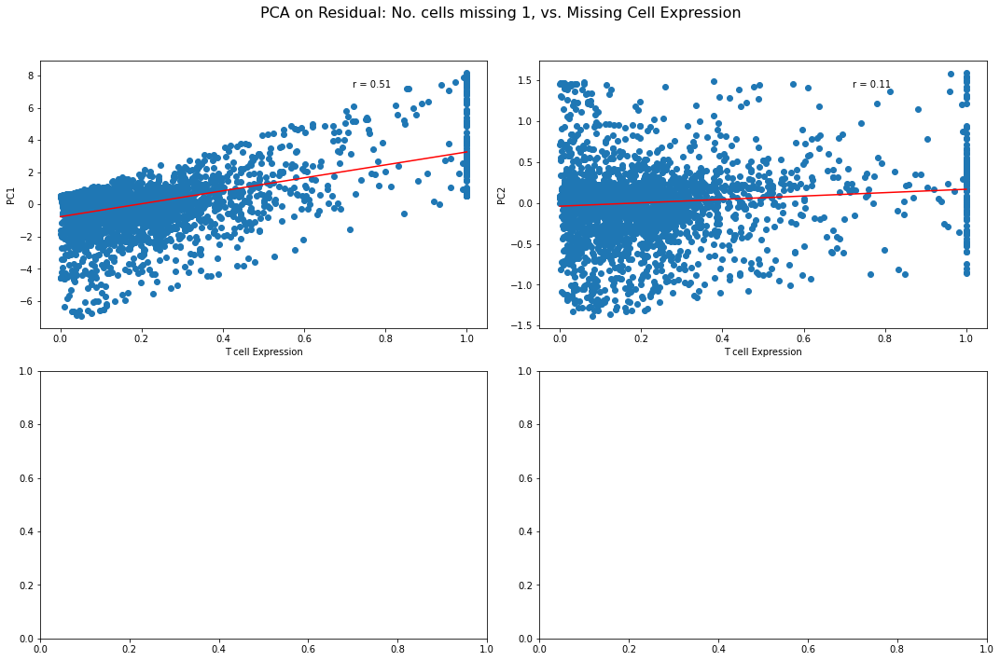

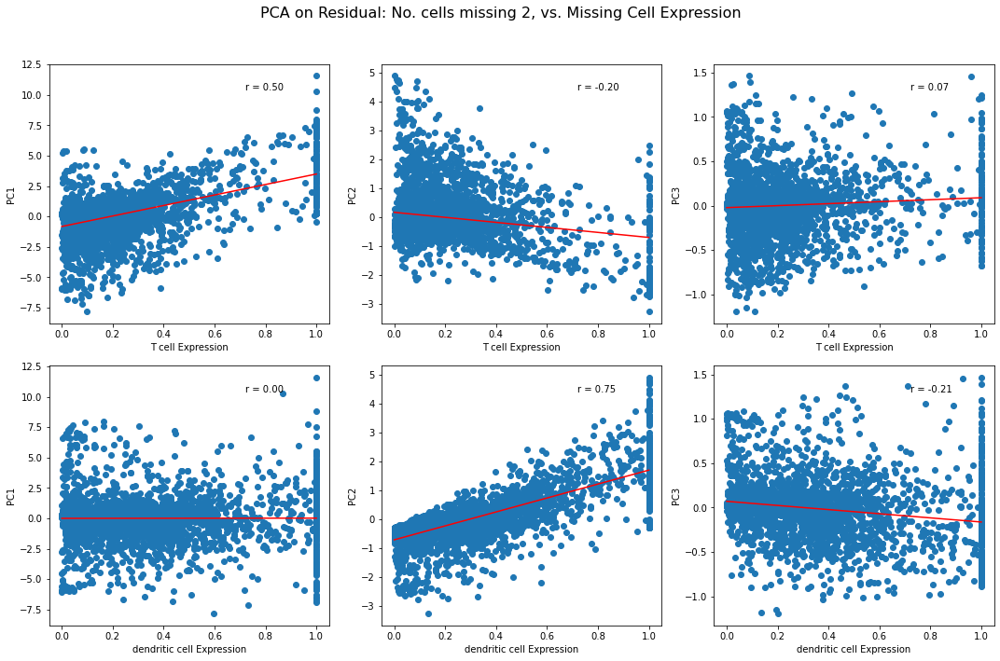

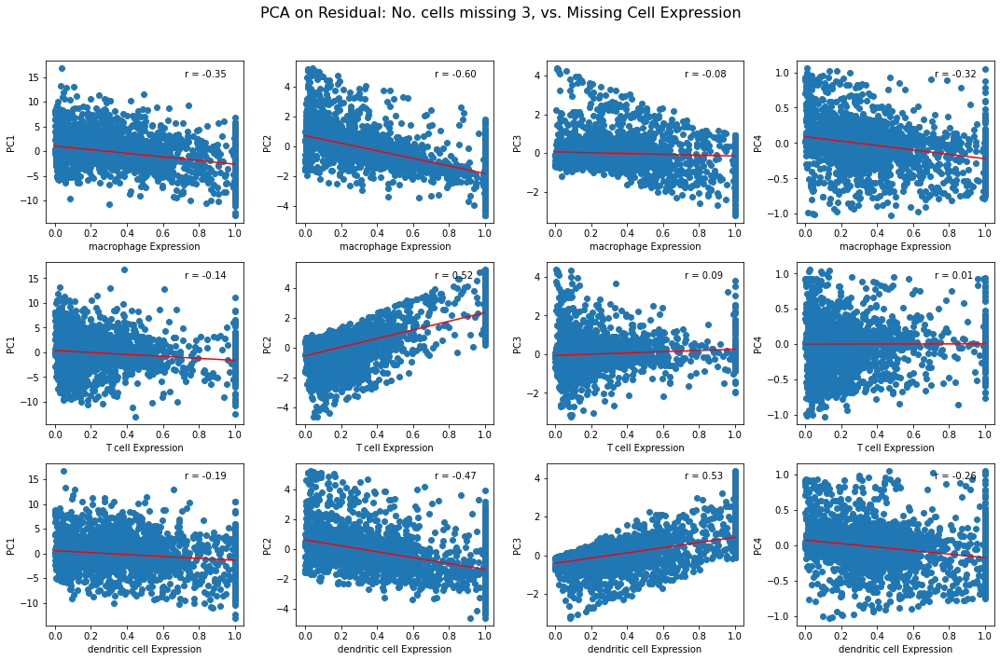

In [119]:
#pca on residual, Starting with pca by gene, not by sample
# compared to the Expression of missing cell types.
for num in num_cells_missing[1:]:
    num_pca = num + 1
    pca = PCA(n_components = num_pca)
    res_pca_df = pca.fit_transform(residuals_diffbase[num].T)
    res_pca_df = pd.DataFrame(res_pca_df)#each missing cell type expression with each factor
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_exp_usedref[num].columns) 
    num_cols = num_pca
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'PCA on Residual: No. cells missing {num}, vs. Missing Cell Expression', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_exp_usedref[num].columns):
        for j in range(num_pca):
            x = list(missing_cell_exp_usedref[num][cell_type])
            y = list(res_pca_df[j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Expression')
            ax.set_ylabel(f'PC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If pca works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

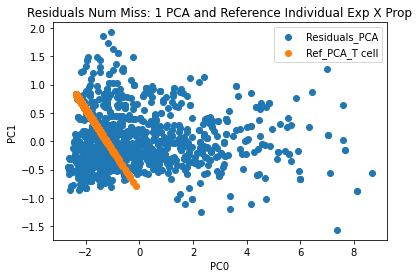

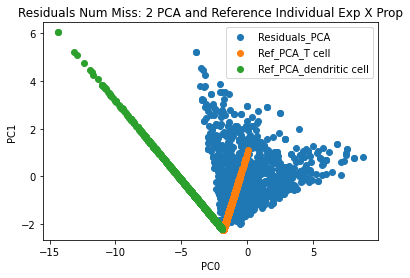

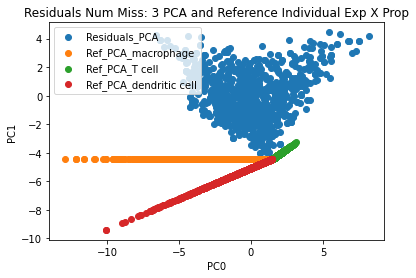

In [120]:
#PCA of Residual with Each missing cell's used exp * prop
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    pca = PCA(n_components=10)
    pseudos_pca = pca.fit_transform(residuals_diffbase[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC0")
    plt.ylabel("PC1")
    plt.legend()
    plt.show()

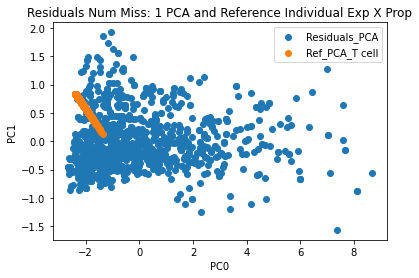

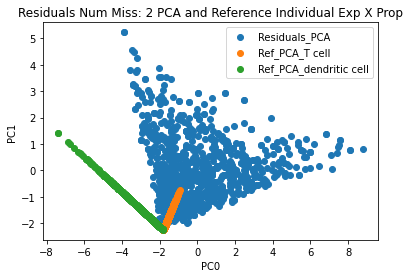

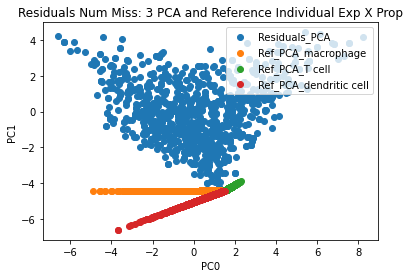

In [121]:
#PCA of Residual with Each missing cell's av exp * prop
for num in num_missing_cells[1:]:
    cells_dict = avex_prop_individual[num]
    pca = PCA(n_components = 4)
    pseudos_pca = pca.fit_transform(residuals_diffbase[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC0")
    plt.ylabel("PC1")
    plt.legend()
    plt.show()

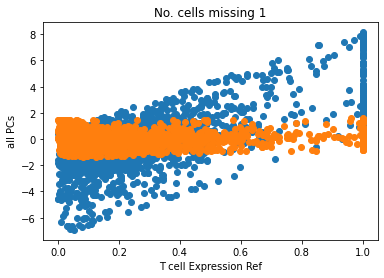

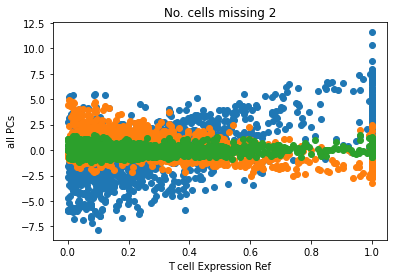

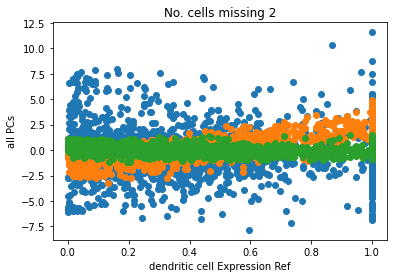

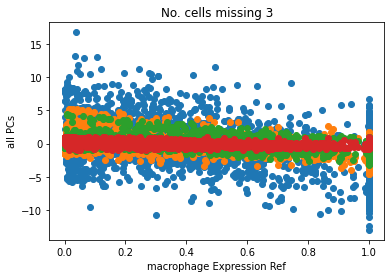

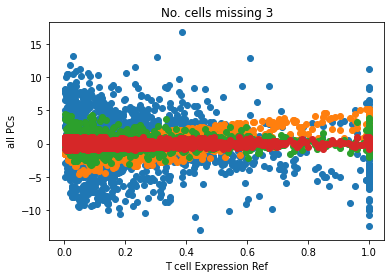

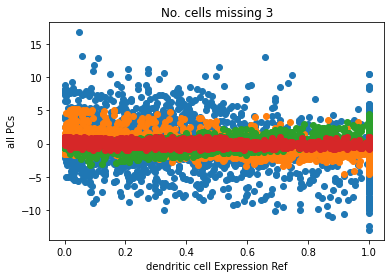

In [122]:
#each missing cell type expression with each PC
for num in num_missing_cells[1:]:
    for column in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][column] #each missing cell type
        for pc in pca_diffbase[num].columns: #each PC
            y = pca_diffbase[num][pc]
            plt.scatter(x,y)
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{column} Expression Ref')
        plt.ylabel(f"all PCs")
        plt.show()

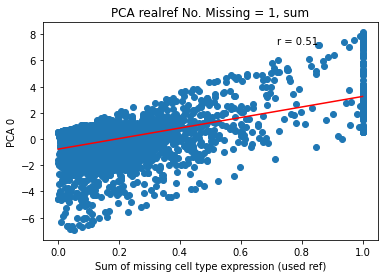

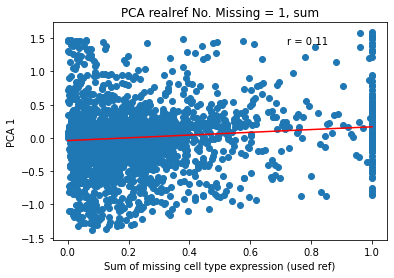

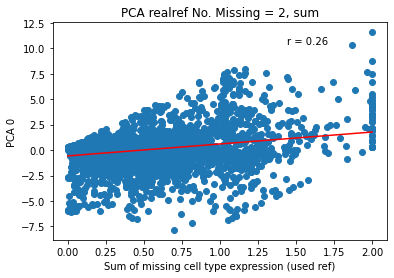

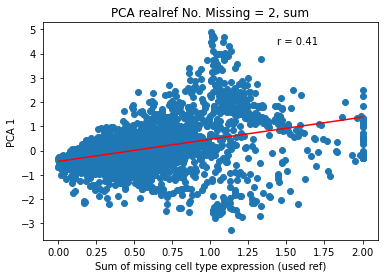

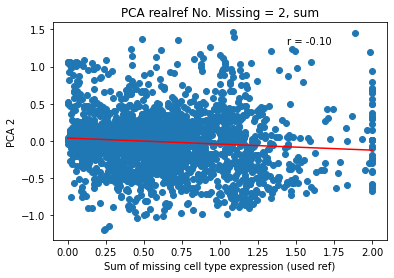

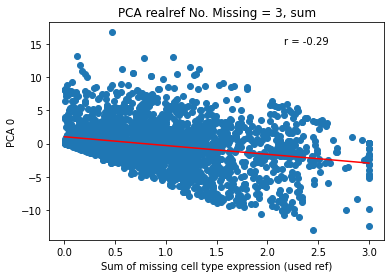

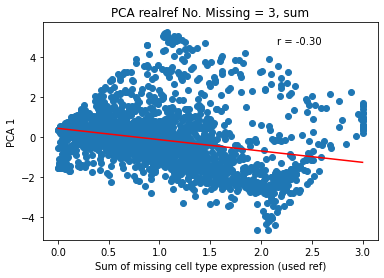

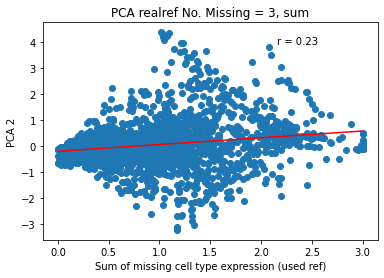

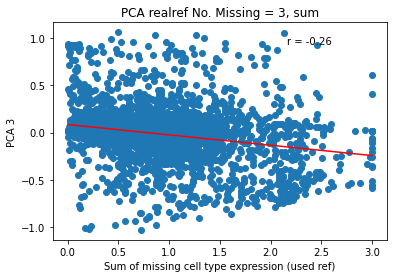

In [123]:
#Each missing cell type expression summed with each PC 
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for number in range(0,num + 1):
        y = pca_diffbase[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (used ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

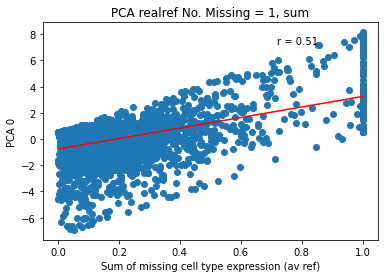

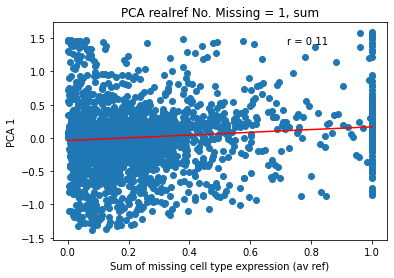

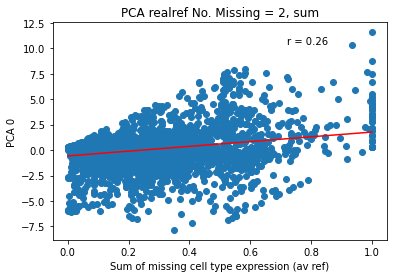

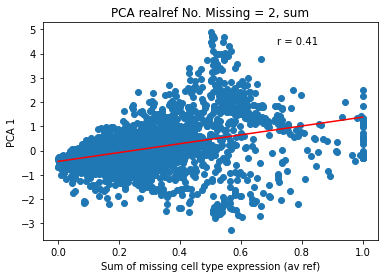

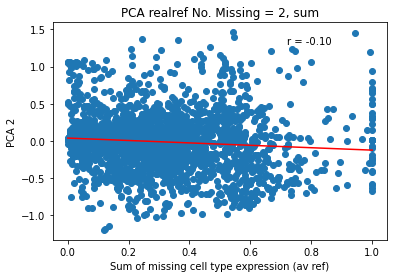

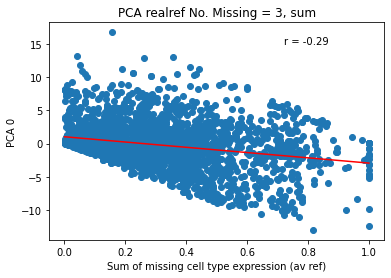

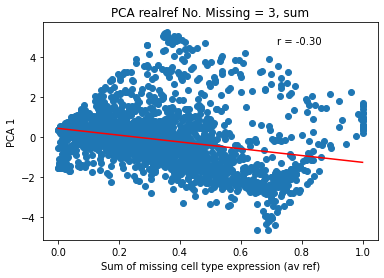

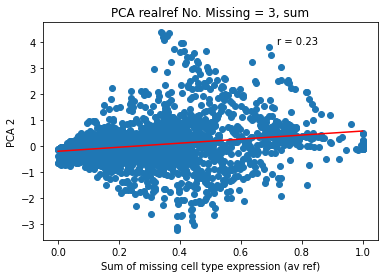

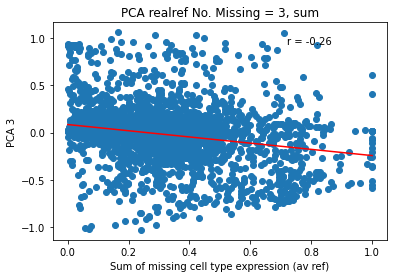

In [124]:
#same as above, but with average instead of sum:
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for number in range(0,num + 1):
        y = pca_diffbase[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (av ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

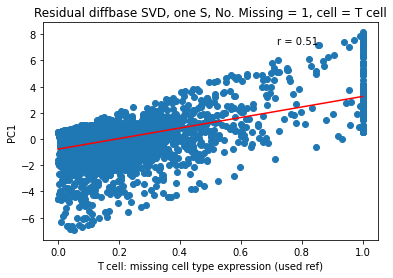

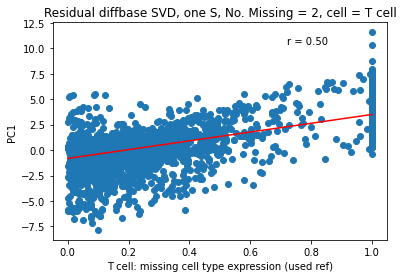

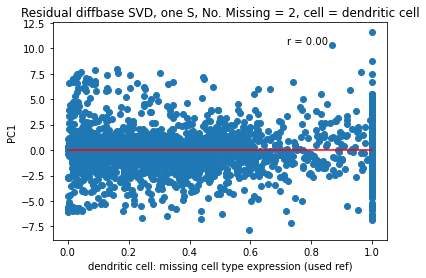

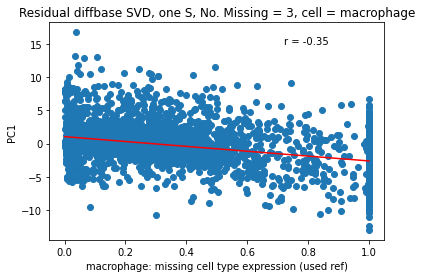

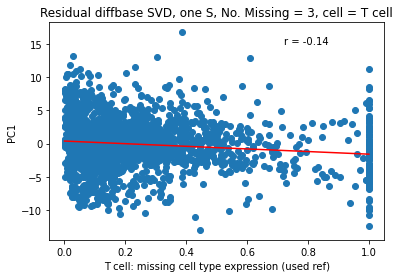

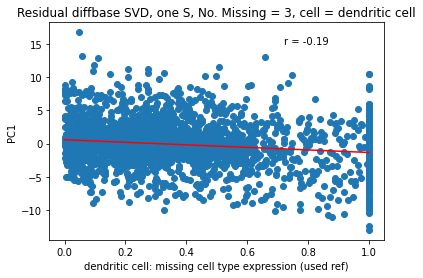

In [125]:
#Just the first PC with each cell type expression
for num in num_missing_cells[1:]:
    for col in missing_cell_exp_usedref[num].columns: #each cell type
        x = missing_cell_exp_usedref[num][col]
        y= pca_diffbase[num][0] #with PC0
        plt.scatter(x,y)
        plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"PC1")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

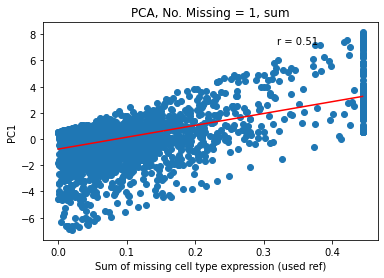

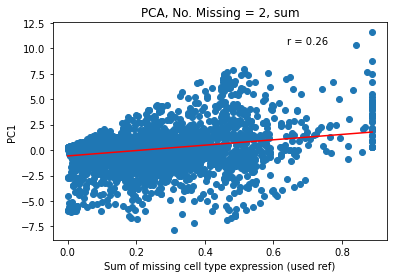

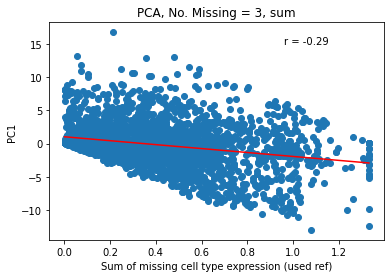

In [126]:
#just the firsty PC with the SUM of all missing cell types expression
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    y= pca_diffbase[num][0]
    plt.scatter(x,y)
    plt.title(f'PCA, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"PC1")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

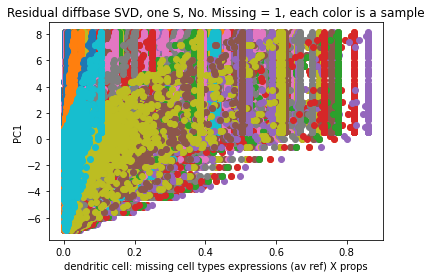

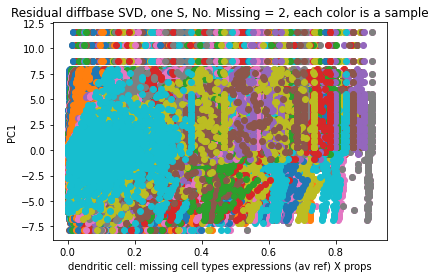

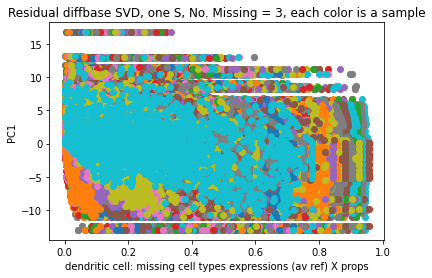

In [127]:
#combined missing cell types expression X proportions, each sample with PC0
for num in num_missing_cells[1:]:
    for index,row in missing_cell_usedexp_x_prop[num].iterrows(): #each sample 
        x = row.values
        y= pca_diffbase[num][0] #with PC0
        plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, each color is a sample')
    plt.xlabel(f'{col}: missing cell types expressions (av ref) X props')
    plt.ylabel(f"PC1")
    plt.show()

Residual realref

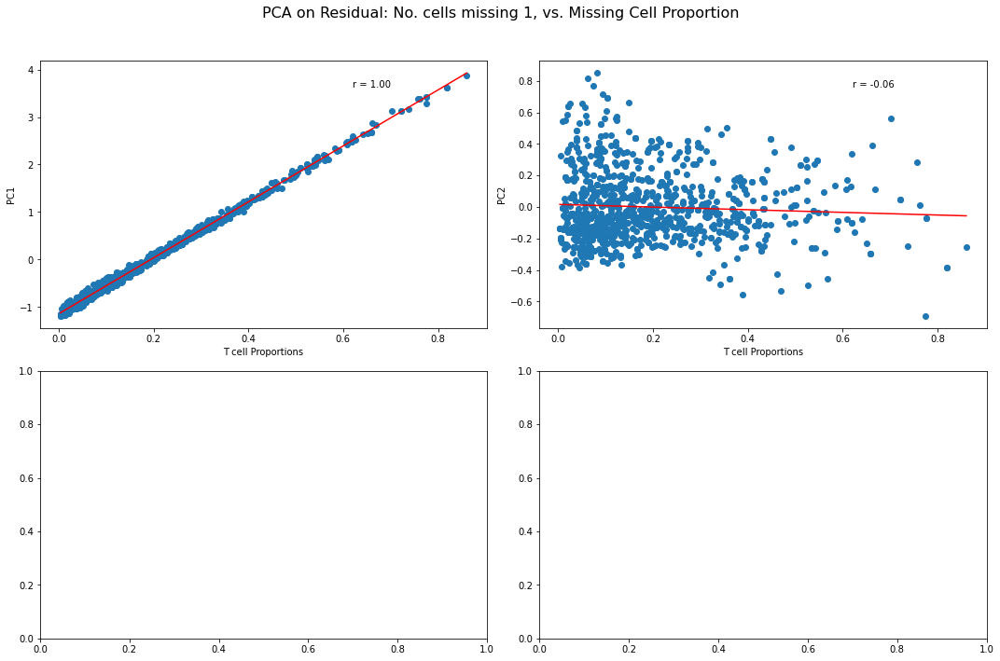

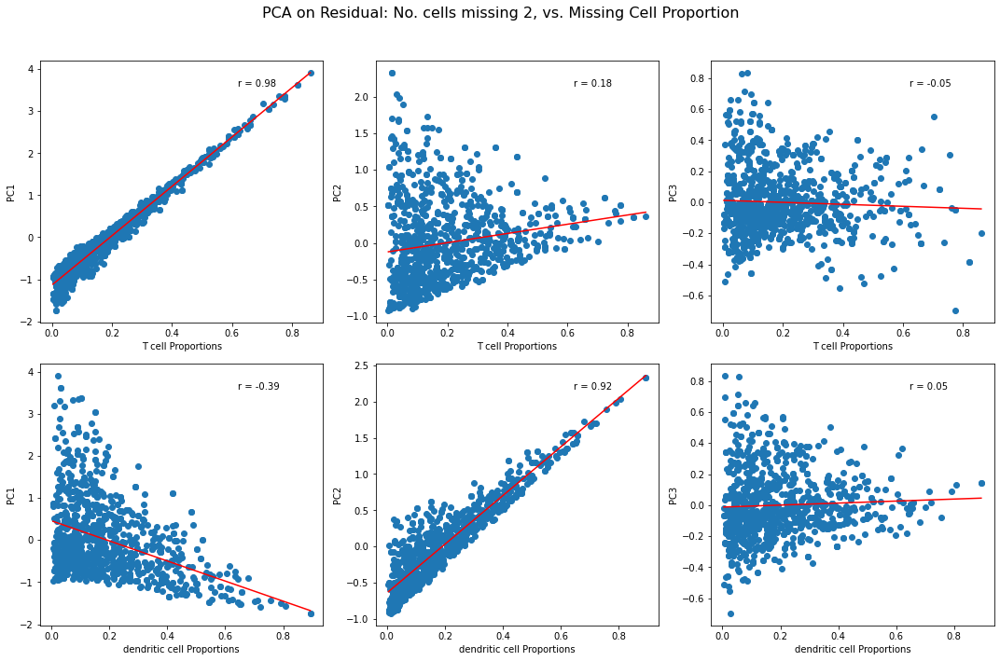

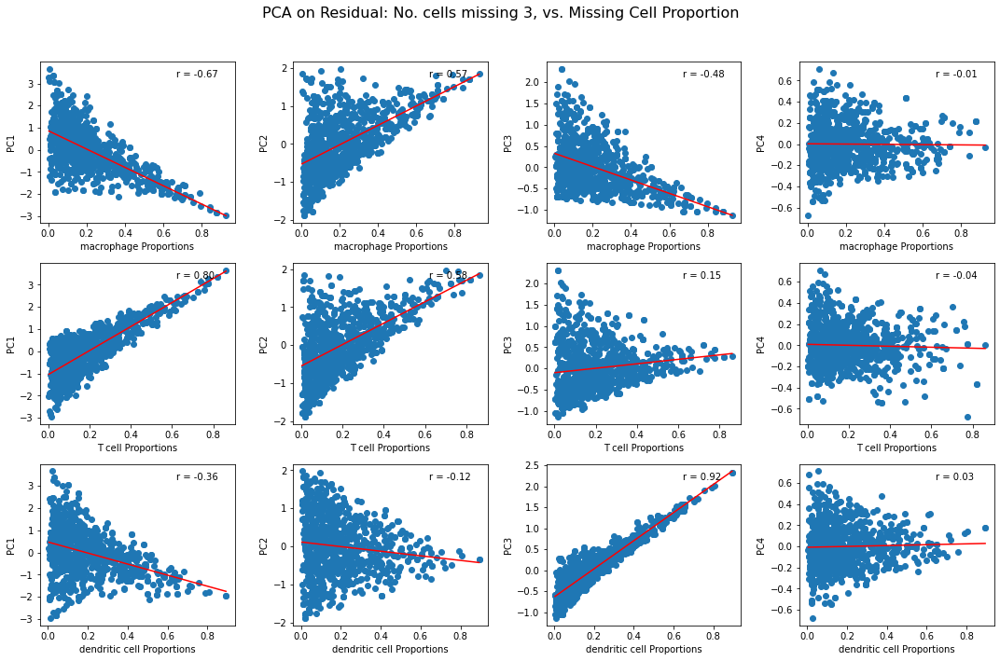

In [128]:
#pca on residual, Starting with pca by sample, not by gene, 
# compared to the proportions of missing cell types.
for num in num_cells_missing[1:]:
    num_pca = num + 1
    pca = PCA(n_components = num_pca)
    res_pca_df = pca.fit_transform(residuals_realref[num])
    res_pca_df = pd.DataFrame(res_pca_df)#each missing cell type expression with each factor
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_prop[num].columns) 
    num_cols = num_pca
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'PCA on Residual: No. cells missing {num}, vs. Missing Cell Proportion', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_prop[num].columns):
        for j in range(num_pca):
            x = list(missing_cell_prop[num][cell_type])
            y = list(res_pca_df[j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Proportions')
            ax.set_ylabel(f'PC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If pca works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

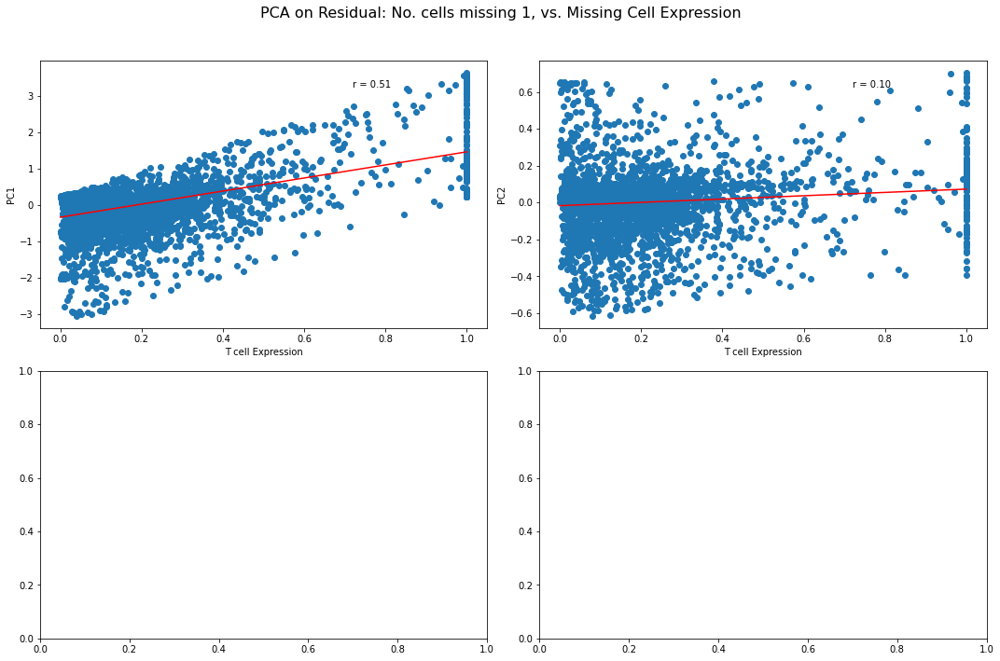

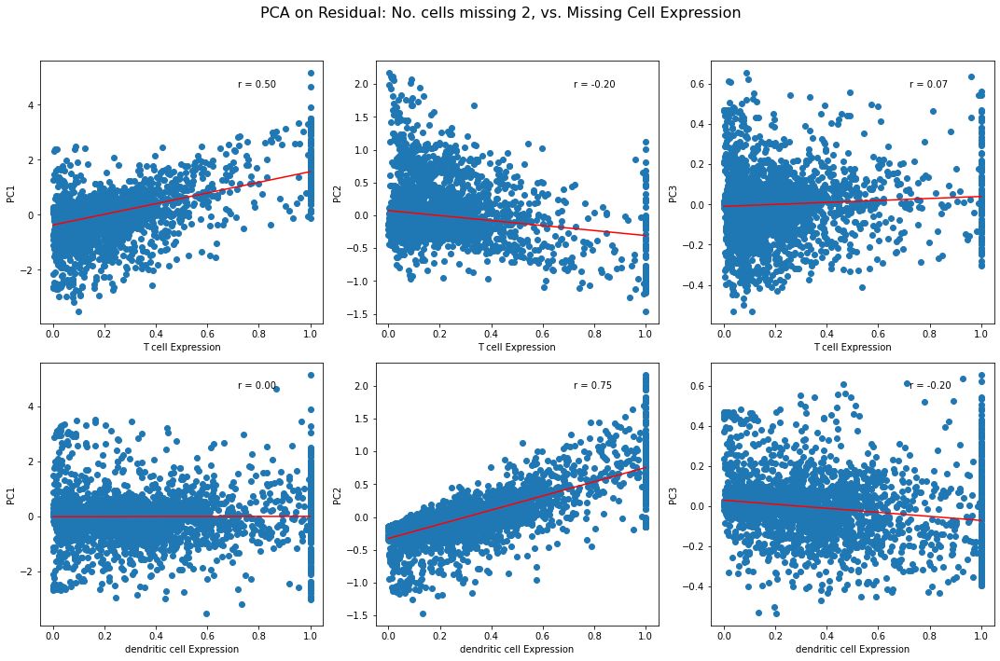

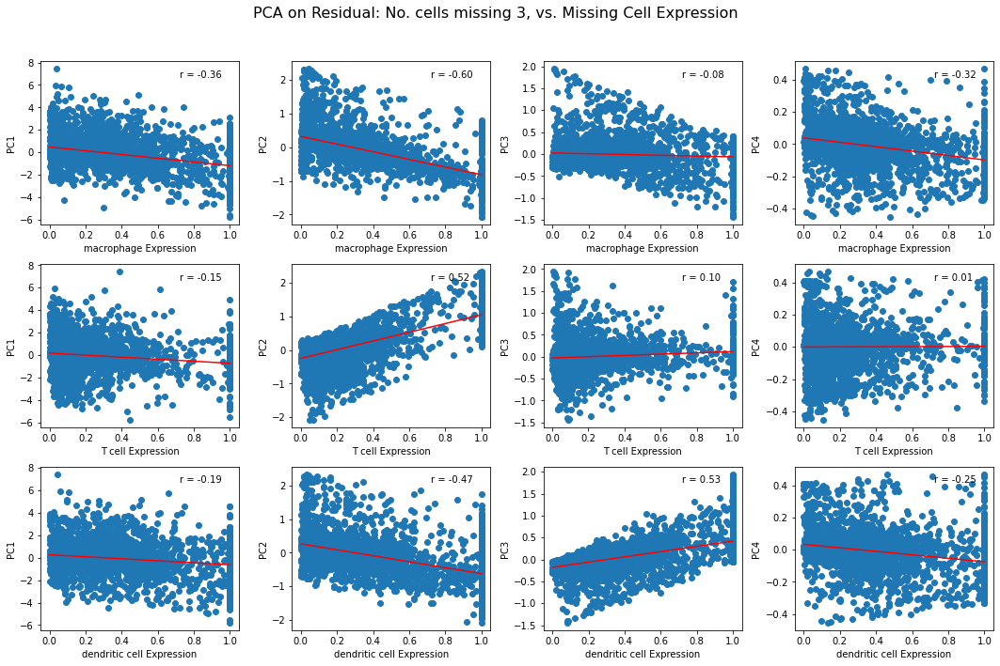

In [129]:
#pca on residual, Starting with pca by gene, not by sample
# compared to the Expression of missing cell types.
for num in num_cells_missing[1:]:
    num_pca = num + 1
    pca = PCA(n_components = num_pca)
    res_pca_df = pca.fit_transform(residuals_realref[num].T)
    res_pca_df = pd.DataFrame(res_pca_df)#each missing cell type expression with each factor
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_exp_usedref[num].columns) 
    num_cols = num_pca
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'PCA on Residual: No. cells missing {num}, vs. Missing Cell Expression', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_exp_usedref[num].columns):
        for j in range(num_pca):
            x = list(missing_cell_exp_usedref[num][cell_type])
            y = list(res_pca_df[j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Expression')
            ax.set_ylabel(f'PC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If pca works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

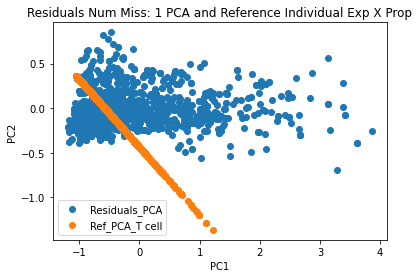

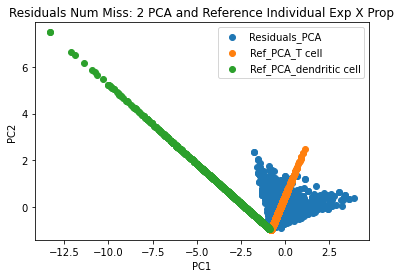

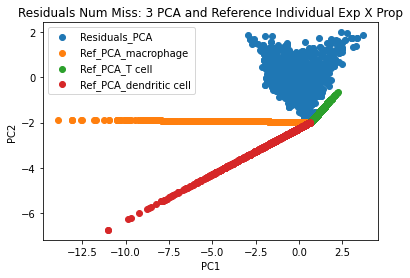

In [130]:
#PCA of Residual with Each missing cell's used exp * prop
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    pca = PCA(n_components=10)
    pseudos_pca = pca.fit_transform(residuals_realref[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

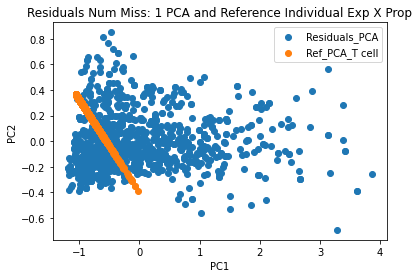

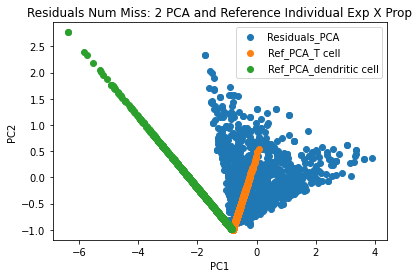

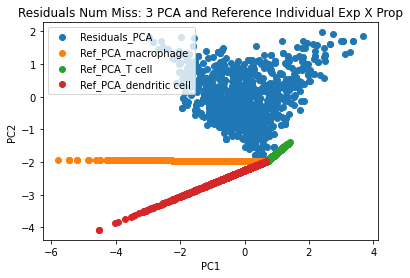

In [131]:
#PCA of Residual with Each missing cell's av exp * prop
for num in num_missing_cells[1:]:
    cells_dict = avex_prop_individual[num]
    pca = PCA(n_components = 4)
    pseudos_pca = pca.fit_transform(residuals_realref[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

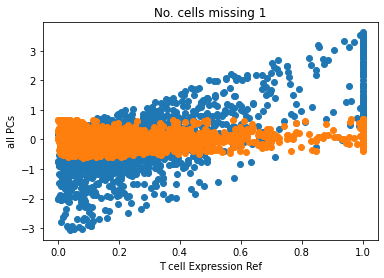

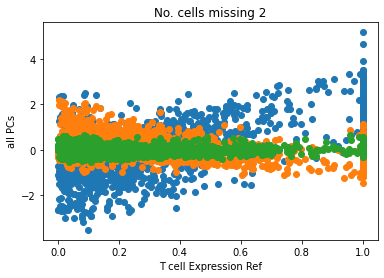

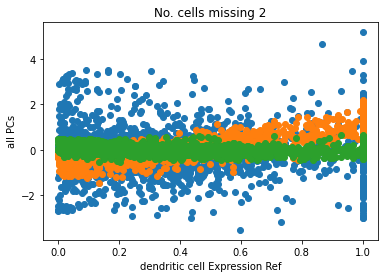

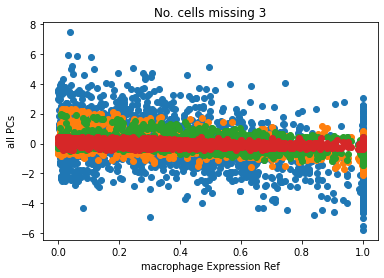

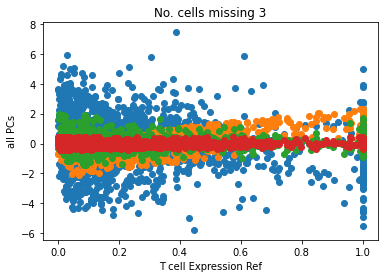

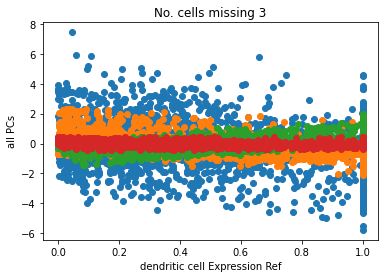

In [132]:
#each missing cell type expression with each PC
for num in num_missing_cells[1:]:
    for column in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][column] #each missing cell type
        for pc in pca_realref[num].columns: #each PC
            y = pca_realref[num][pc]
            plt.scatter(x,y)
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{column} Expression Ref')
        plt.ylabel(f"all PCs")
        plt.show()

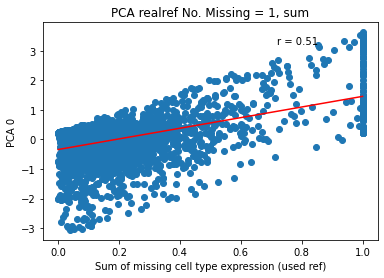

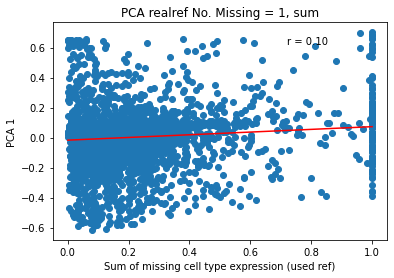

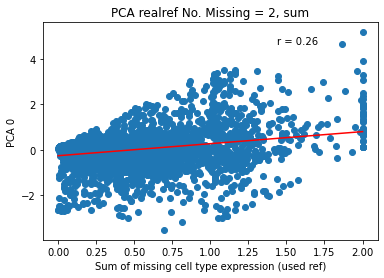

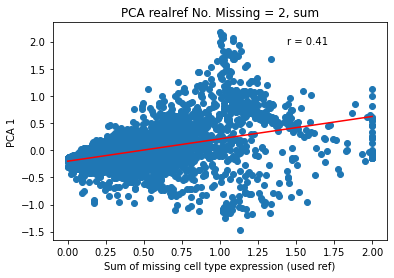

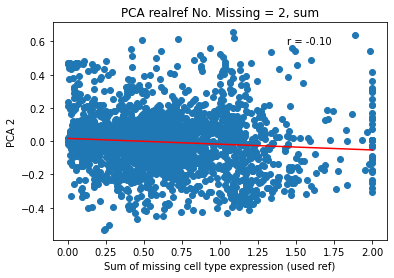

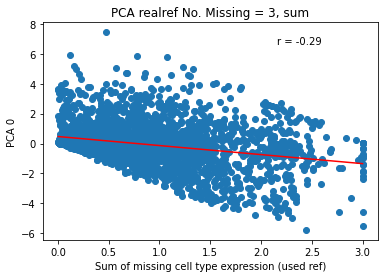

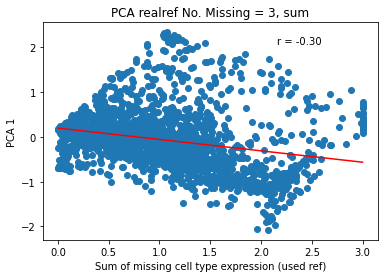

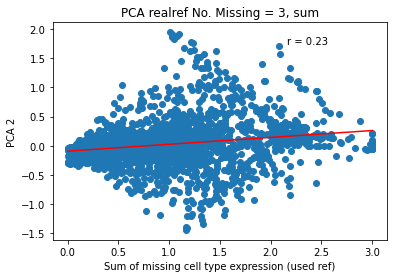

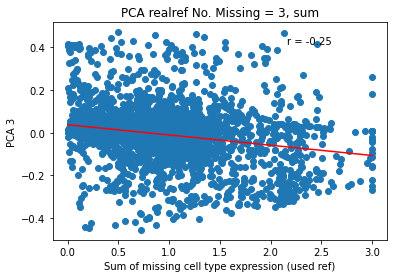

In [133]:
#Each missing cell type expression summed with each PC 
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for number in range(0,num + 1):
        y = pca_realref[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (used ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

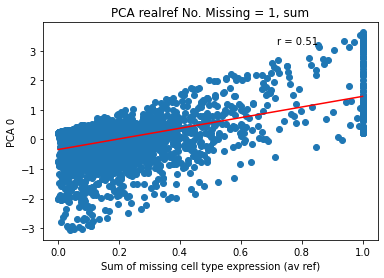

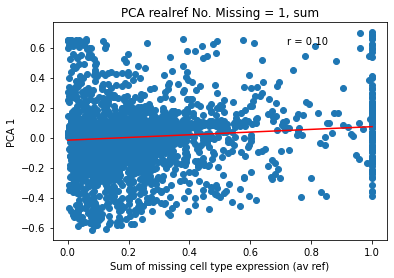

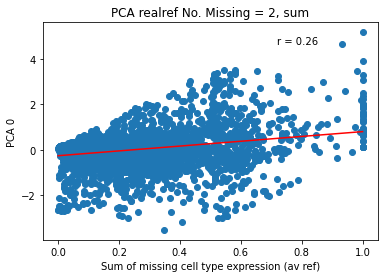

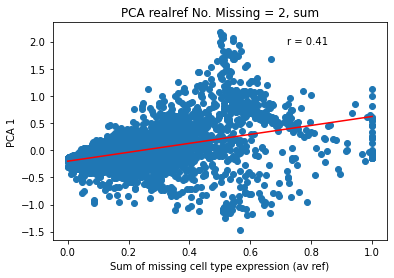

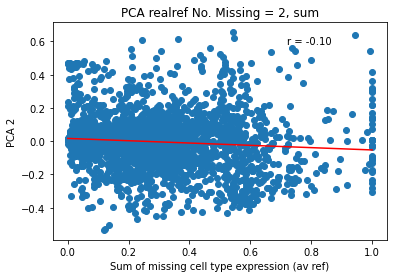

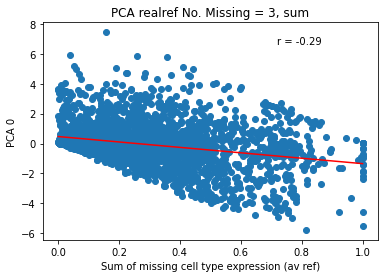

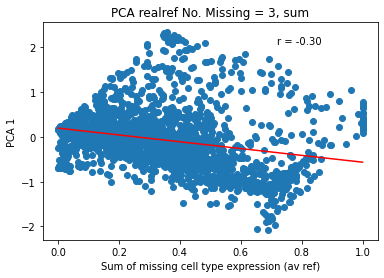

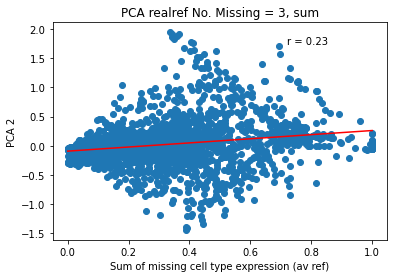

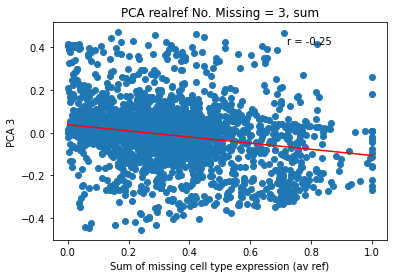

In [134]:
#same as above, but with average instead of sum:
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for number in range(0,num+ 1):
        y = pca_realref[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (av ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

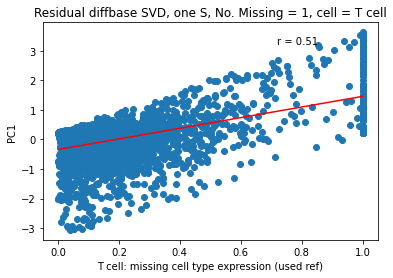

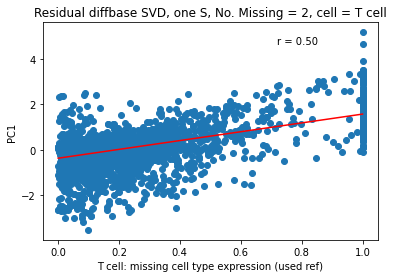

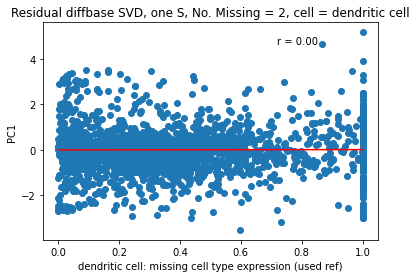

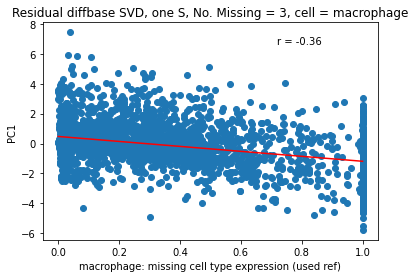

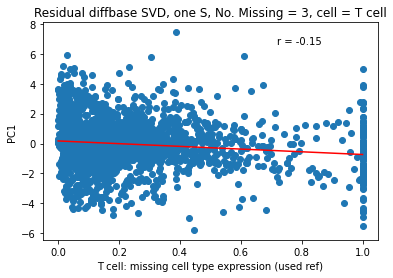

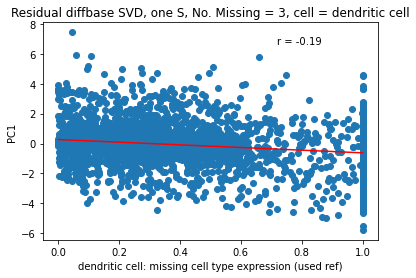

In [135]:
#Just the first PC with each cell type expression
for num in num_missing_cells[1:]:
    for col in missing_cell_exp_usedref[num].columns: #each cell type
        x = missing_cell_exp_usedref[num][col]
        y= pca_realref[num][0] #with PC0
        plt.scatter(x,y)
        plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"PC1")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

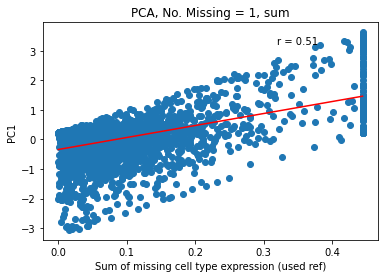

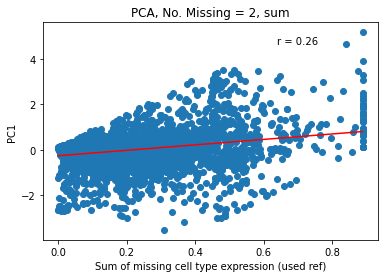

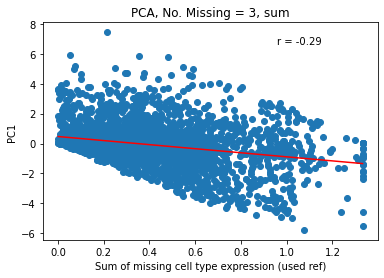

In [136]:
#just the firsty PC with the SUM of all missing cell types expression
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    y= pca_realref[num][0]
    plt.scatter(x,y)
    plt.title(f'PCA, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"PC1")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

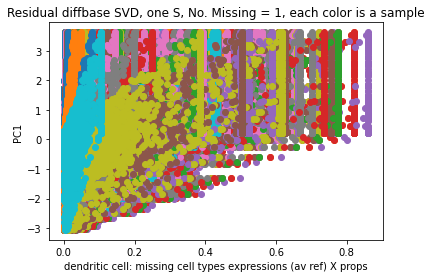

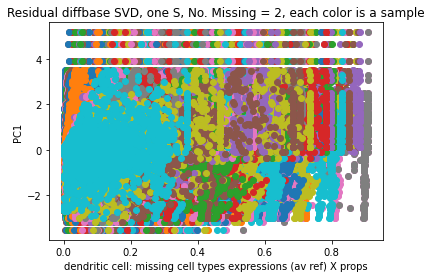

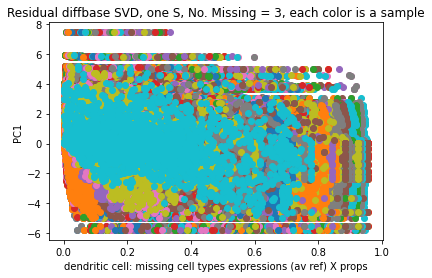

In [137]:
#combined missing cell types expression X proportions, each sample with PC0
for num in num_missing_cells[1:]:
    for index,row in missing_cell_usedexp_x_prop[num].iterrows(): #each sample 
        x = row.values
        y= pca_realref[num][0] #with PC0
        plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, each color is a sample')
    plt.xlabel(f'{col}: missing cell types expressions (av ref) X props')
    plt.ylabel(f"PC1")
    plt.show()

## **ICA**

Calculate ICA

In [138]:
#ICA on residual 1
res_ica = dict()
for num in num_missing_cells:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals[num].T)
    res_ica_df = pd.DataFrame(res_ica_df)
    res_ica[num] = res_ica_df

In [139]:
#ICA on residual diffbase
res_ica_diffbase = dict()
for num in num_missing_cells:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals_diffbase[num].T)
    res_ica_df = pd.DataFrame(res_ica_df)
    res_ica_diffbase[num] = res_ica_df

In [140]:
#ICA on residual realref
res_ica_realref = dict()
for num in num_missing_cells:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals_realref[num].T)
    res_ica_df = pd.DataFrame(res_ica_df)
    res_ica_realref[num] = res_ica_df

Residual

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


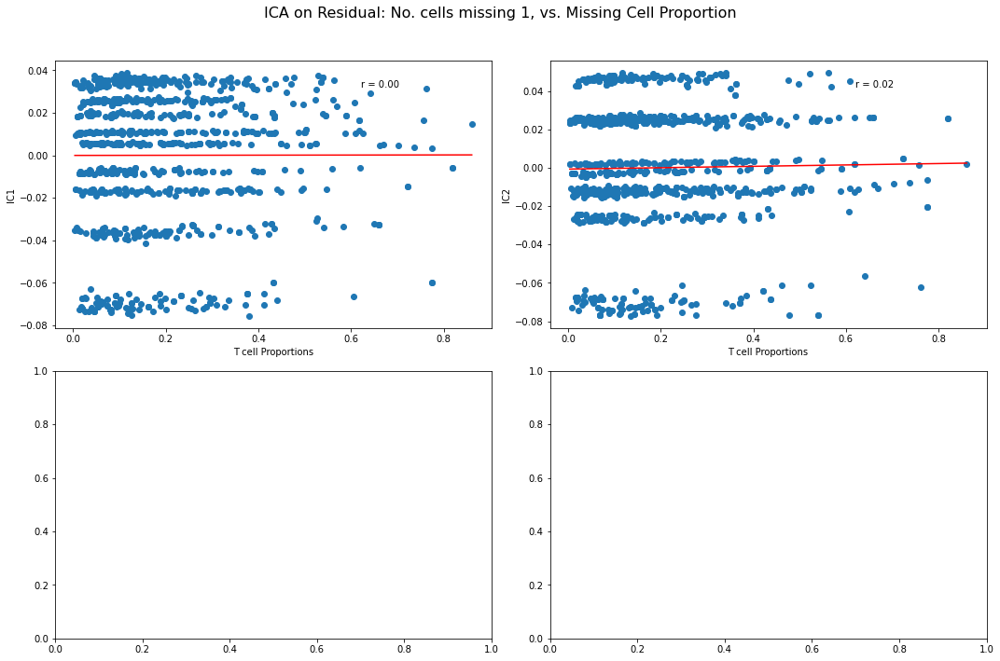

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


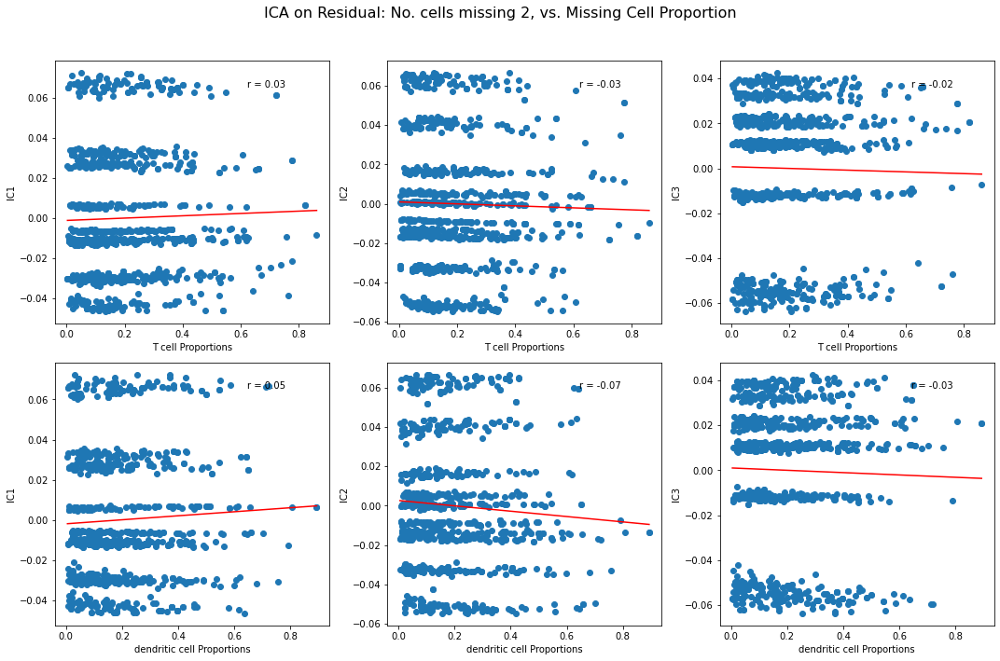

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


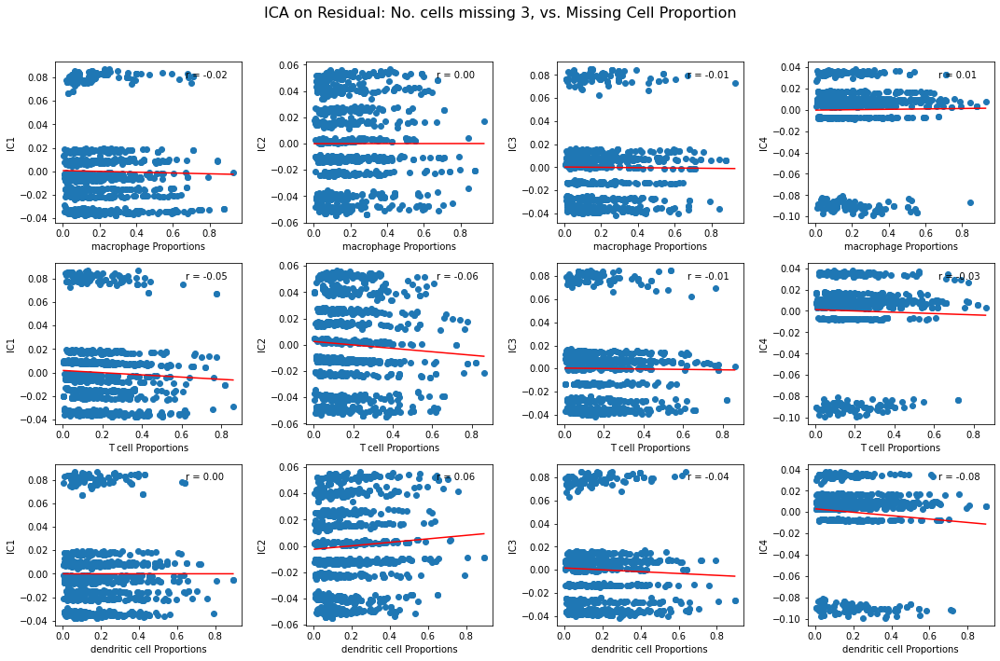

In [141]:
#ICA on residual, Starting with ICA by sample, not by gene, 
# compared to the proportions of missing cell types.
for num in num_cells_missing[1:]:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals[num])
    res_ica_df = pd.DataFrame(res_ica_df)#each missing cell type expression with each factor
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_prop[num].columns) 
    num_cols = num_ica
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'ICA on Residual: No. cells missing {num}, vs. Missing Cell Proportion', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_prop[num].columns):
        for j in range(num_ica):
            x = list(missing_cell_prop[num][cell_type])
            y = list(res_ica_df[j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Proportions')
            ax.set_ylabel(f'IC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If ICA works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

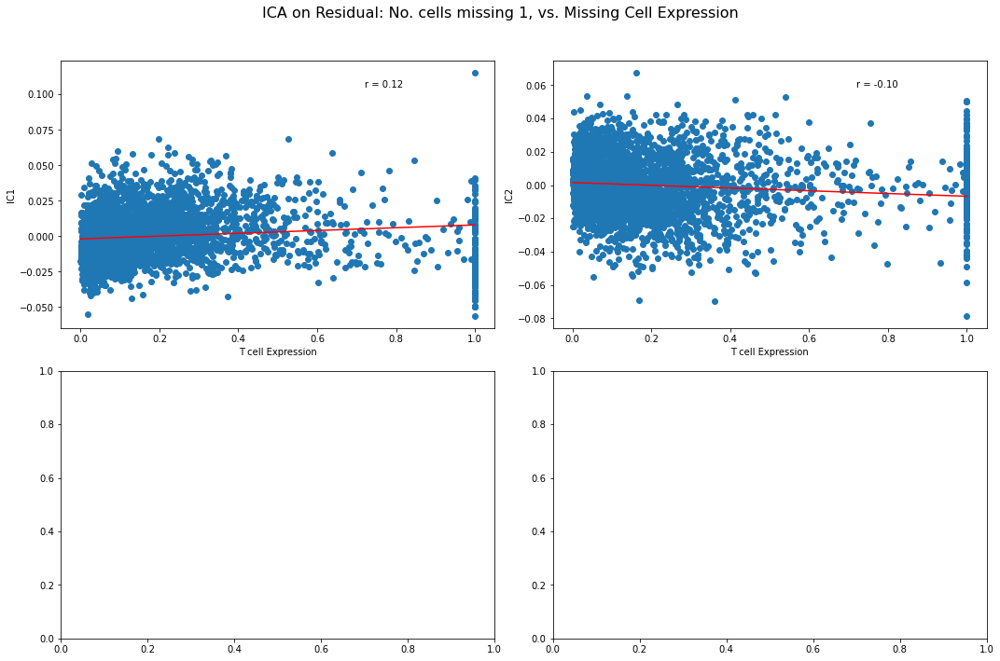

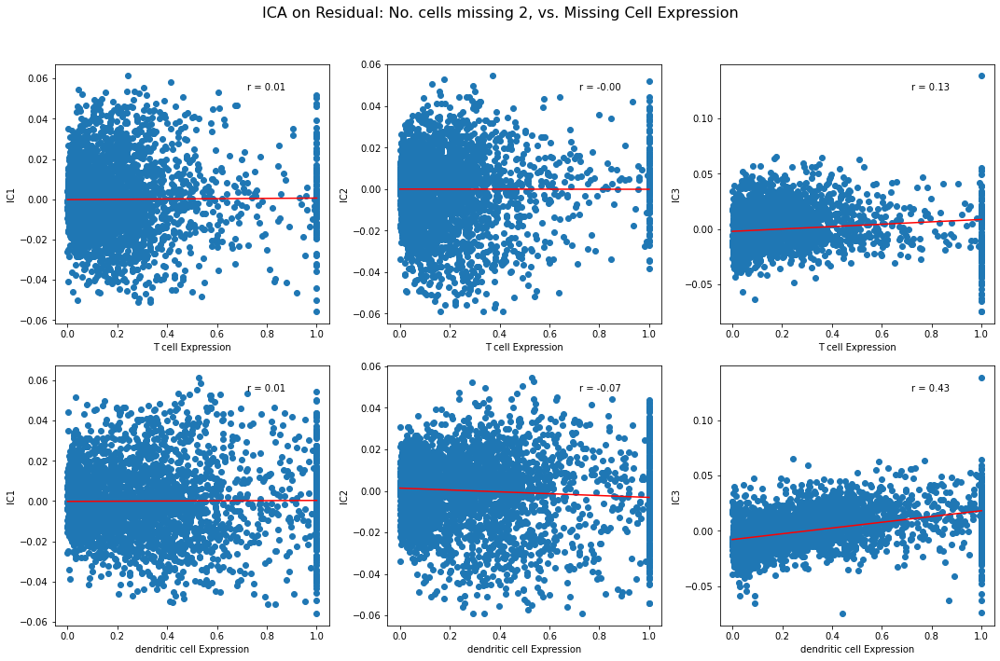

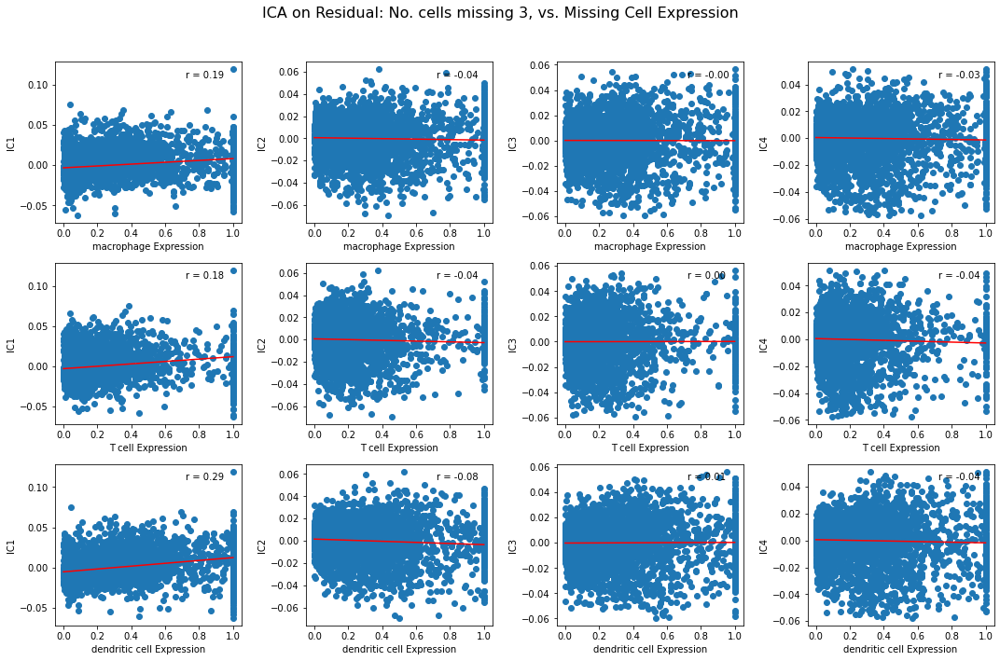

In [142]:
#ICA on residual, ICA by gene, not by sample.
# compared to the reference expression of missing cell types.
for num in num_cells_missing[1:]:
    num_ica = num + 1
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_exp_usedref[num].columns) 
    num_cols = num_ica
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'ICA on Residual: No. cells missing {num}, vs. Missing Cell Expression', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_exp_usedref[num].columns):
        for j in range(num_ica):
            x = list(missing_cell_exp_usedref[num][cell_type])
            y = list(res_ica[num][j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Expression')
            ax.set_ylabel(f'IC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')
    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If ICA works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


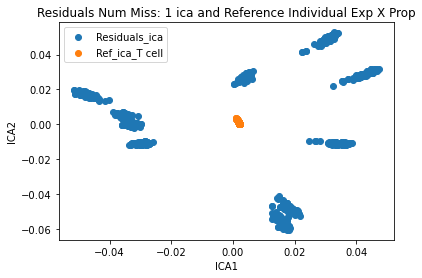

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


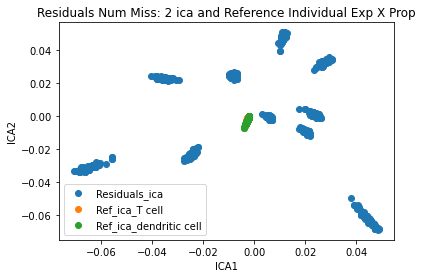

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


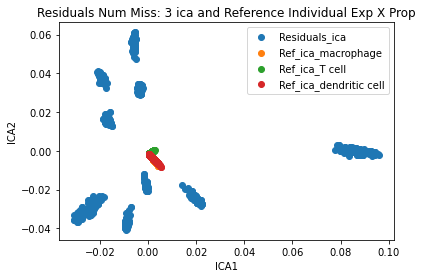

In [143]:
#ICA with individual missing cell used expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    ica = FastICA(n_components = 4)
    pseudos_ica = ica.fit_transform(residuals[num])
    plt.scatter(pseudos_ica[:,0], pseudos_ica[:,1], label = "Residuals_ica" )
    for cell in cells_dict:
        ref_ica = ica.transform(cells_dict[cell])
        plt.scatter(ref_ica[:,0], ref_ica[:,1], label = f"Ref_ica_{cell}" )
    plt.title(f"Residuals Num Miss: {num} ica and Reference Individual Exp X Prop")
    plt.xlabel("ICA1")
    plt.ylabel("ICA2")
    plt.legend()
    plt.show()

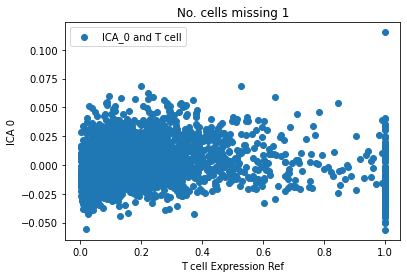

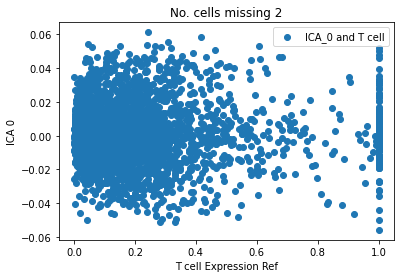

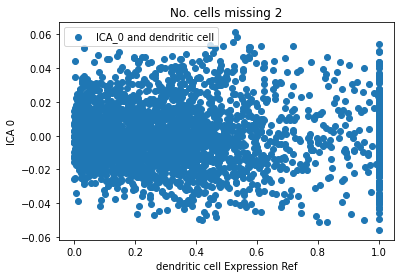

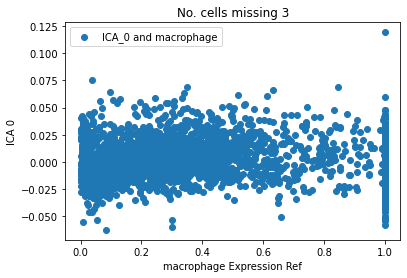

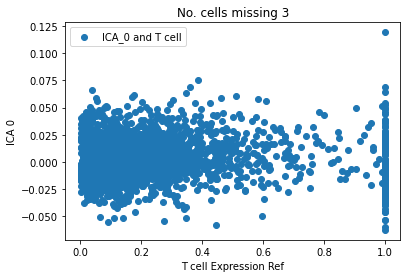

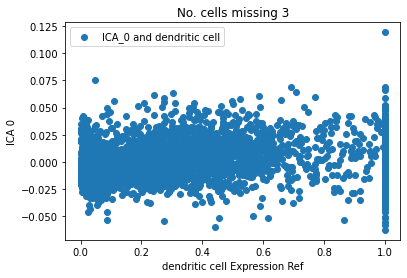

In [144]:
#each missing cell reference expression with just IC 0.
for num in num_missing_cells[1:]:
    res_ica_all = res_ica[num]
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        y = res_ica_all[0]
        plt.scatter(x,y, label = f"ICA_0 and {cell}")
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{cell} Expression Ref')
        plt.ylabel(f"ICA 0")
        plt.legend()
        plt.show()

Residual_diffbase

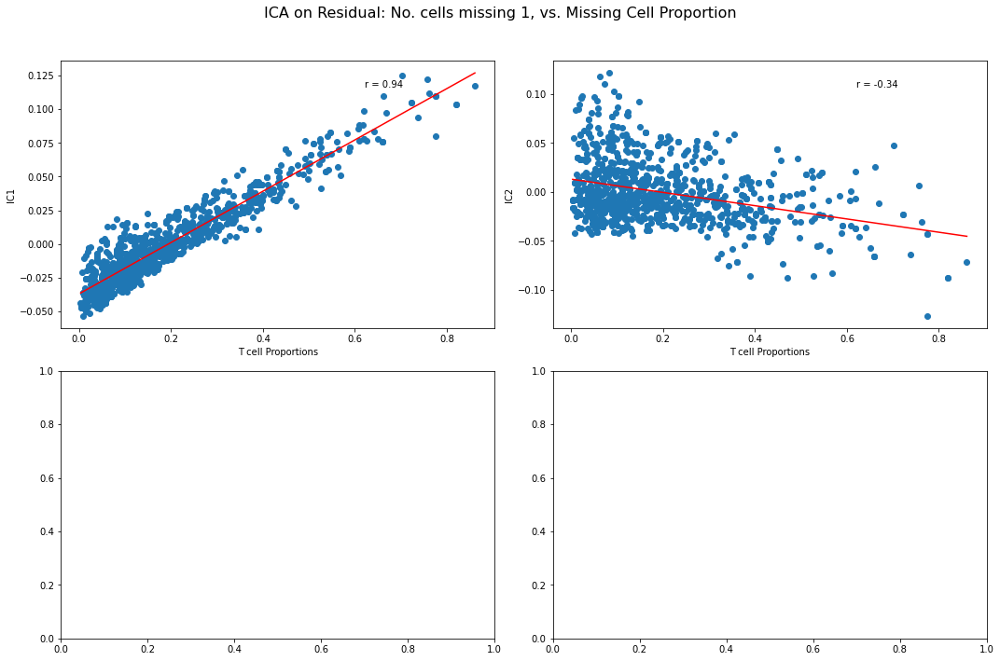

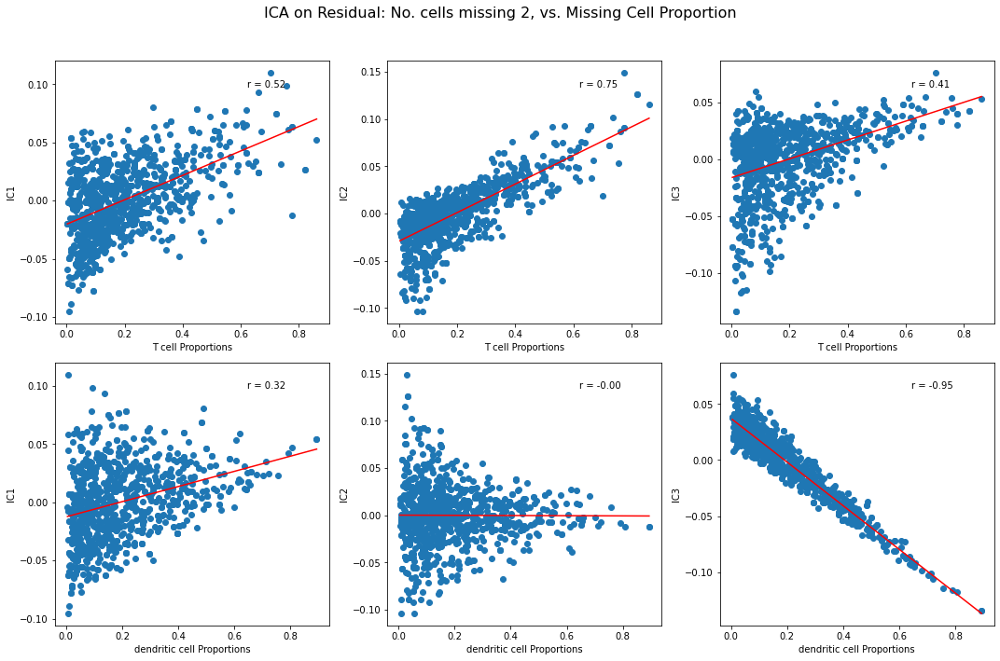

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


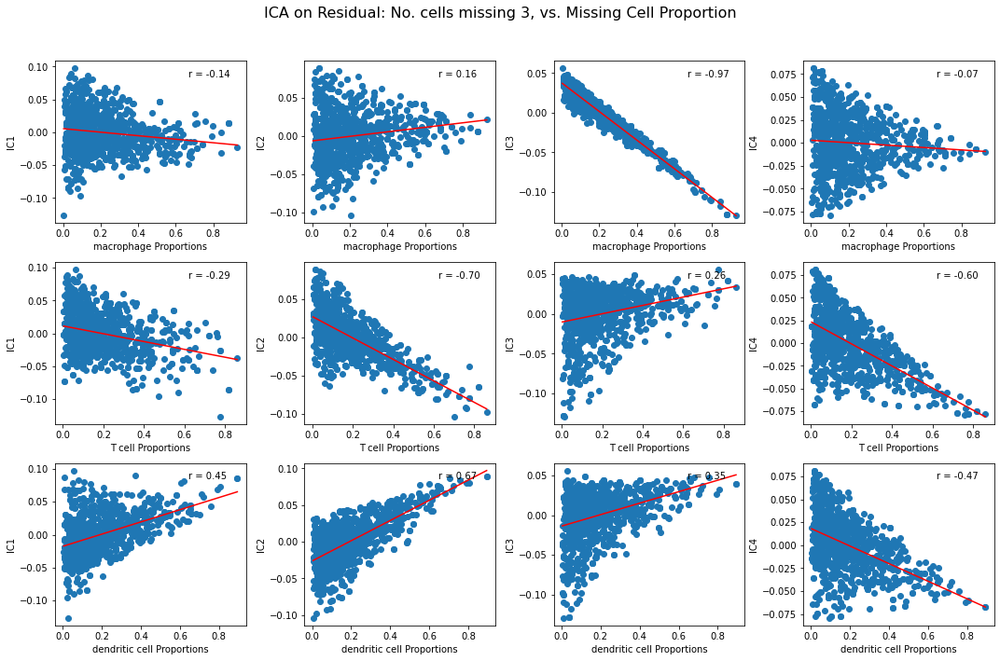

In [145]:
#ICA on residual, Starting with ICA by sample, not by gene, 
# compared to the proportions of missing cell types.
for num in num_cells_missing[1:]:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals_diffbase[num])
    res_ica_df = pd.DataFrame(res_ica_df)#each missing cell type expression with each factor
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_prop[num].columns) 
    num_cols = num_ica
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'ICA on Residual: No. cells missing {num}, vs. Missing Cell Proportion', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_prop[num].columns):
        for j in range(num_ica):
            x = list(missing_cell_prop[num][cell_type])
            y = list(res_ica_df[j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Proportions')
            ax.set_ylabel(f'IC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If ICA works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

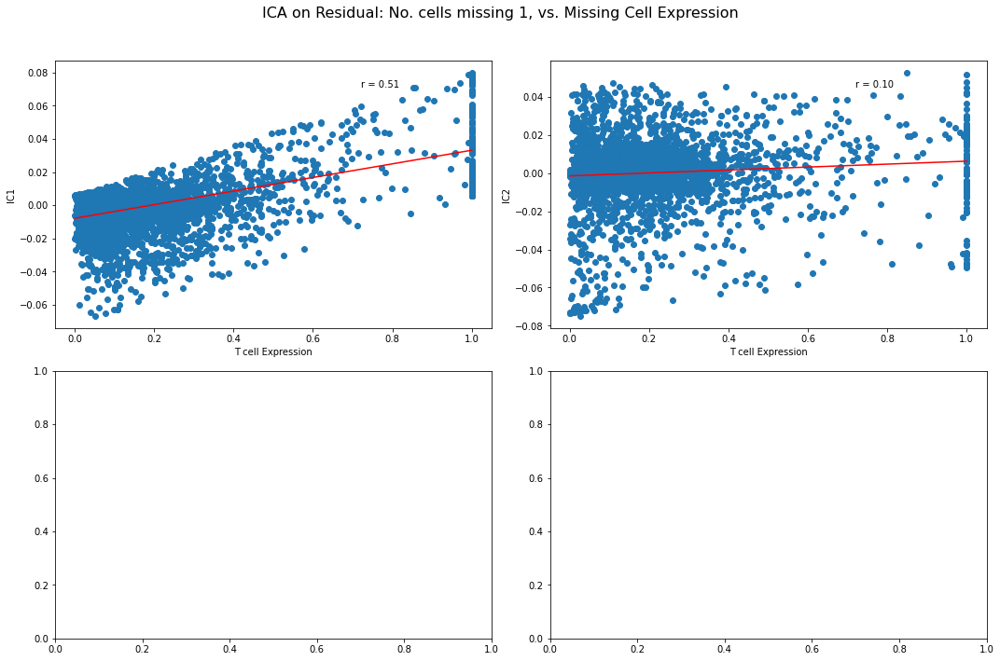

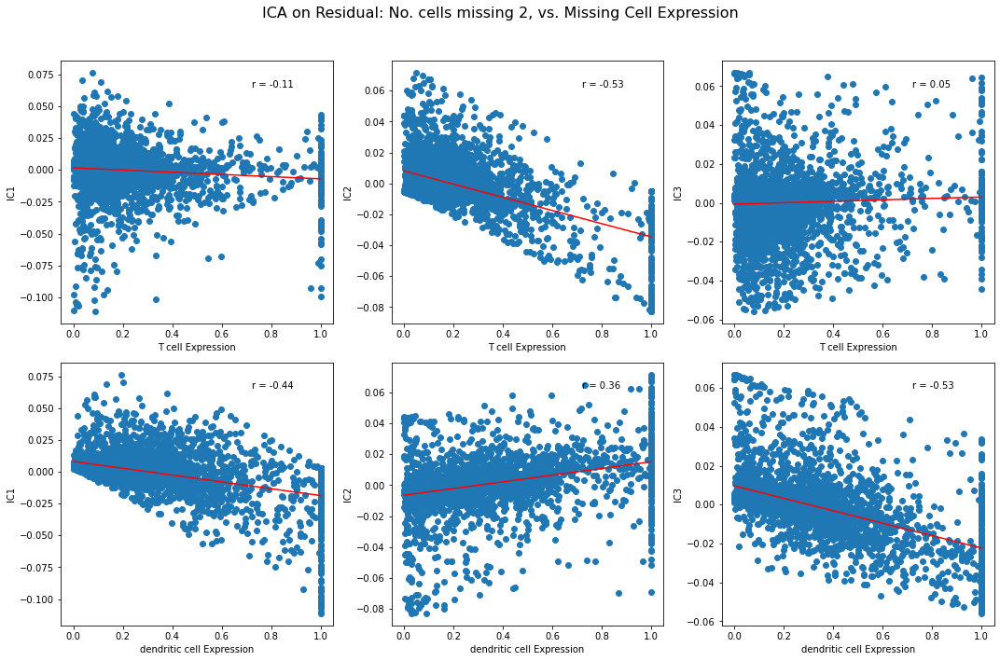

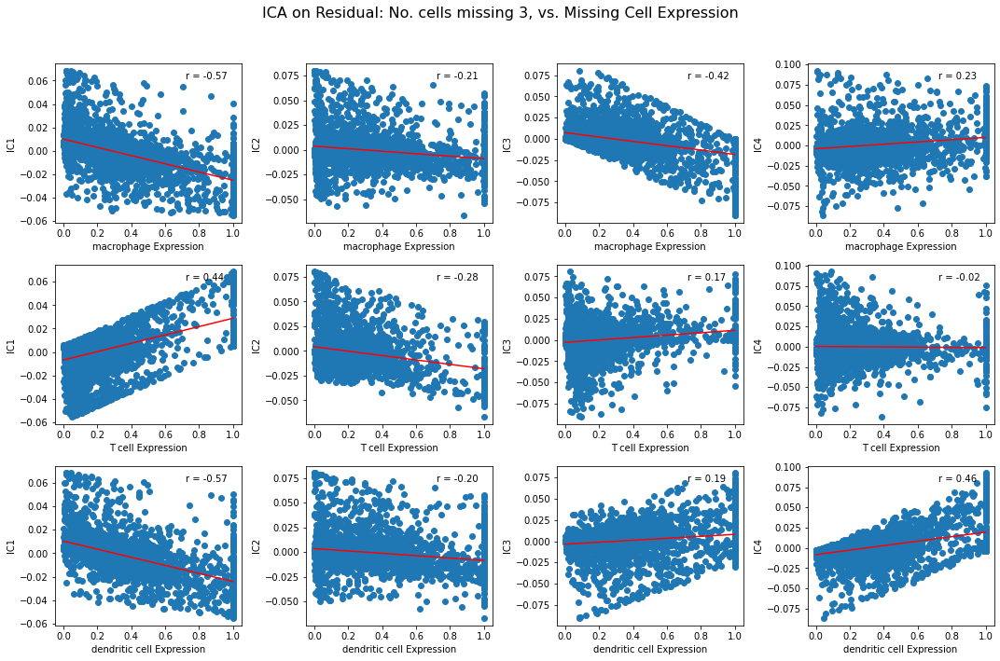

In [146]:
#ICA on residual, ICA by gene, not by sample.
# compared to the reference expression of missing cell types.
for num in num_cells_missing[1:]:
    num_ica = num + 1
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_exp_usedref[num].columns) 
    num_cols = num_ica
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'ICA on Residual: No. cells missing {num}, vs. Missing Cell Expression', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_exp_usedref[num].columns):
        for j in range(num_ica):
            x = list(missing_cell_exp_usedref[num][cell_type])
            y = list(res_ica_diffbase[num][j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Expression')
            ax.set_ylabel(f'IC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')
    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If ICA works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

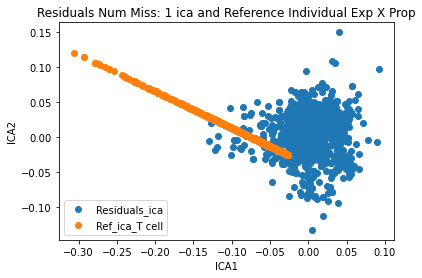

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


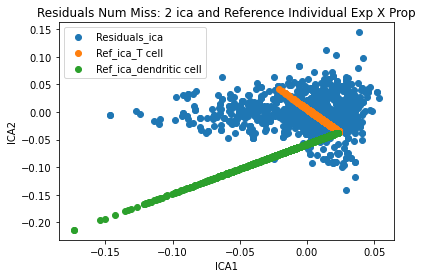

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


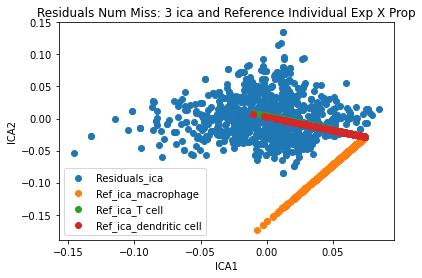

In [147]:
#ICA with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    ica = FastICA(n_components = 4)
    pseudos_ica = ica.fit_transform(residuals_diffbase[num])
    plt.scatter(pseudos_ica[:,0], pseudos_ica[:,1], label = "Residuals_ica" )
    for cell in cells_dict:
        ref_ica = ica.transform(cells_dict[cell])
        plt.scatter(ref_ica[:,0], ref_ica[:,1], label = f"Ref_ica_{cell}" )
    plt.title(f"Residuals Num Miss: {num} ica and Reference Individual Exp X Prop")
    plt.xlabel("ICA1")
    plt.ylabel("ICA2")
    plt.legend()
    plt.show()

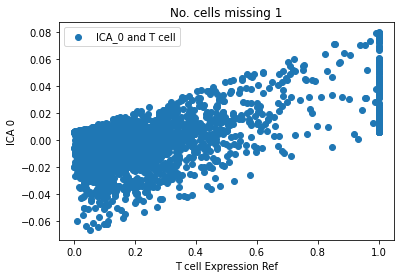

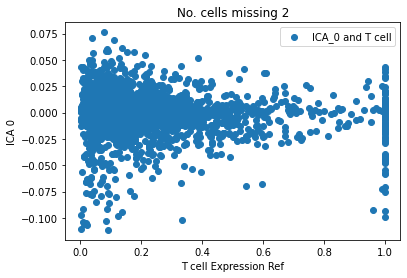

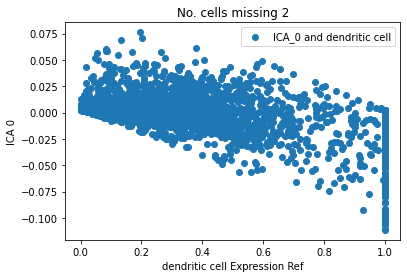

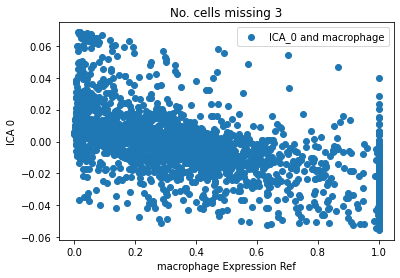

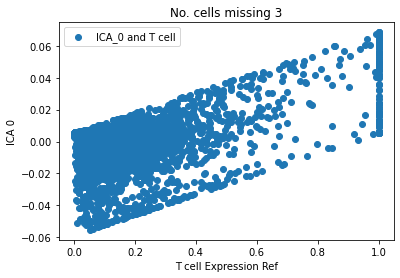

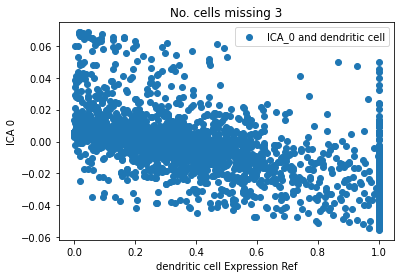

In [148]:
#each missing cell reference expression with just IC 0.
for num in num_missing_cells[1:]:
    res_ica_all = res_ica_diffbase[num]
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        y = res_ica_all[0]
        plt.scatter(x,y, label = f"ICA_0 and {cell}")
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{cell} Expression Ref')
        plt.ylabel(f"ICA 0")
        plt.legend()
        plt.show()

Residual_realref

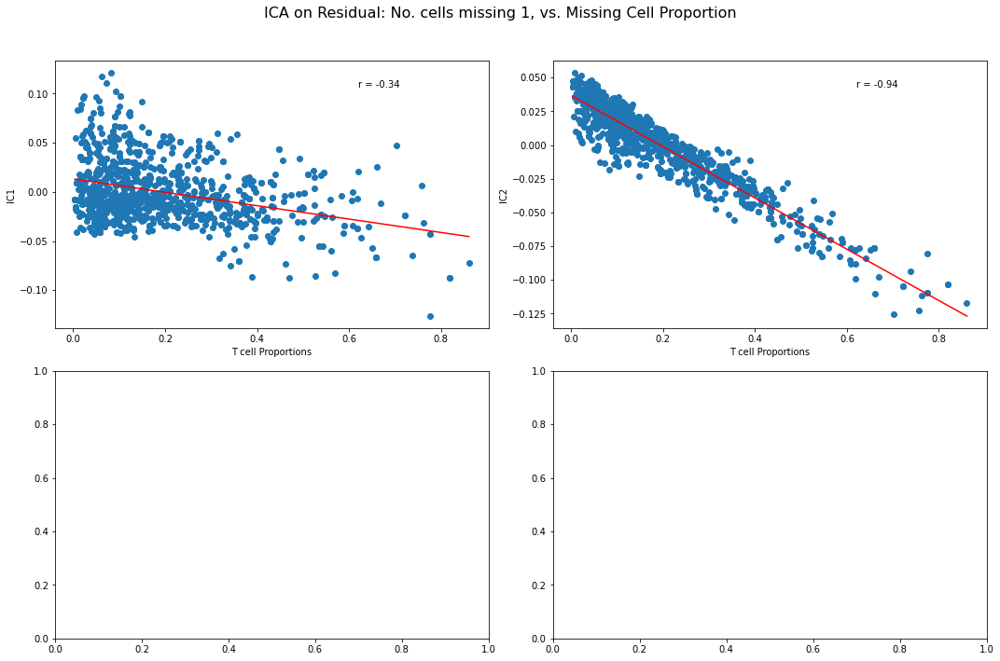

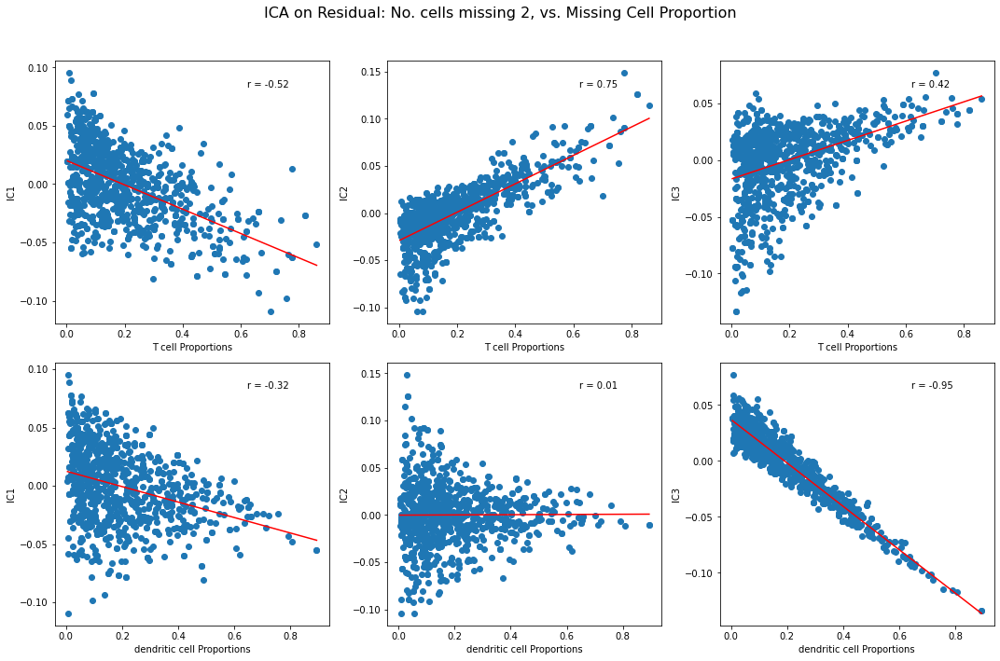

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


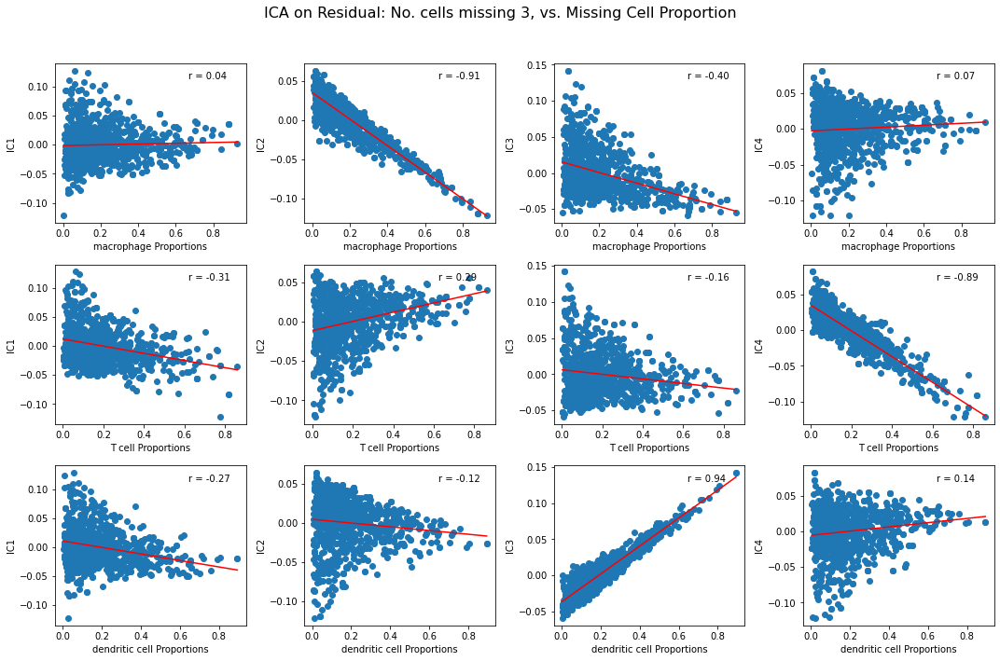

In [149]:
#ICA on residual, Starting with ICA by sample, not by gene, 
# compared to the proportions of missing cell types.
for num in num_cells_missing[1:]:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals_realref[num])
    res_ica_df = pd.DataFrame(res_ica_df)#each missing cell type expression with each factor
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_prop[num].columns) 
    num_cols = num_ica
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'ICA on Residual: No. cells missing {num}, vs. Missing Cell Proportion', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_prop[num].columns):
        for j in range(num_ica):
            x = list(missing_cell_prop[num][cell_type])
            y = list(res_ica_df[j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Proportions')
            ax.set_ylabel(f'IC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If ICA works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

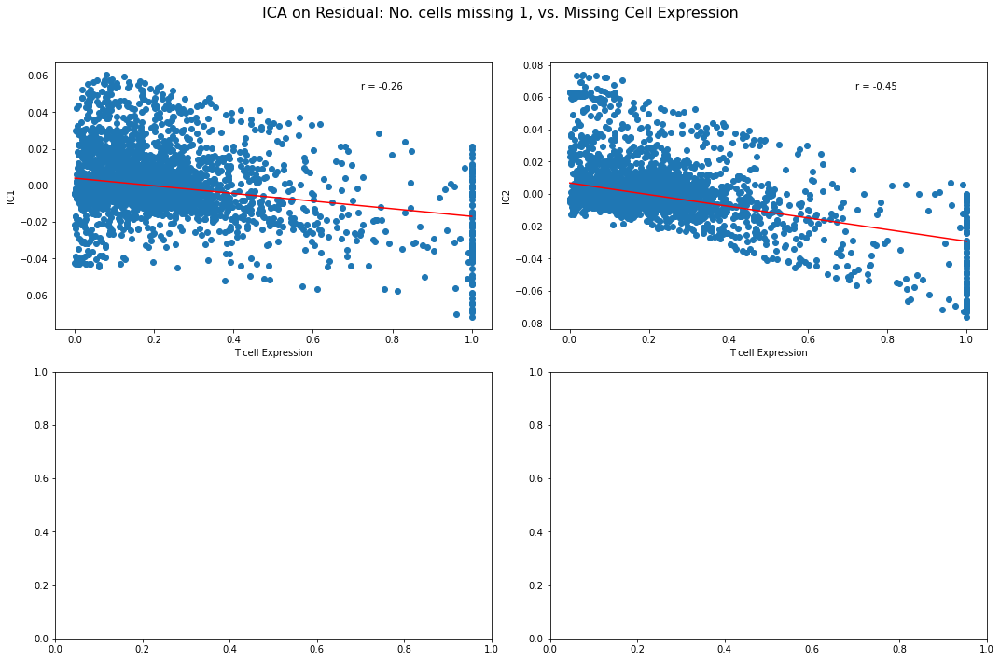

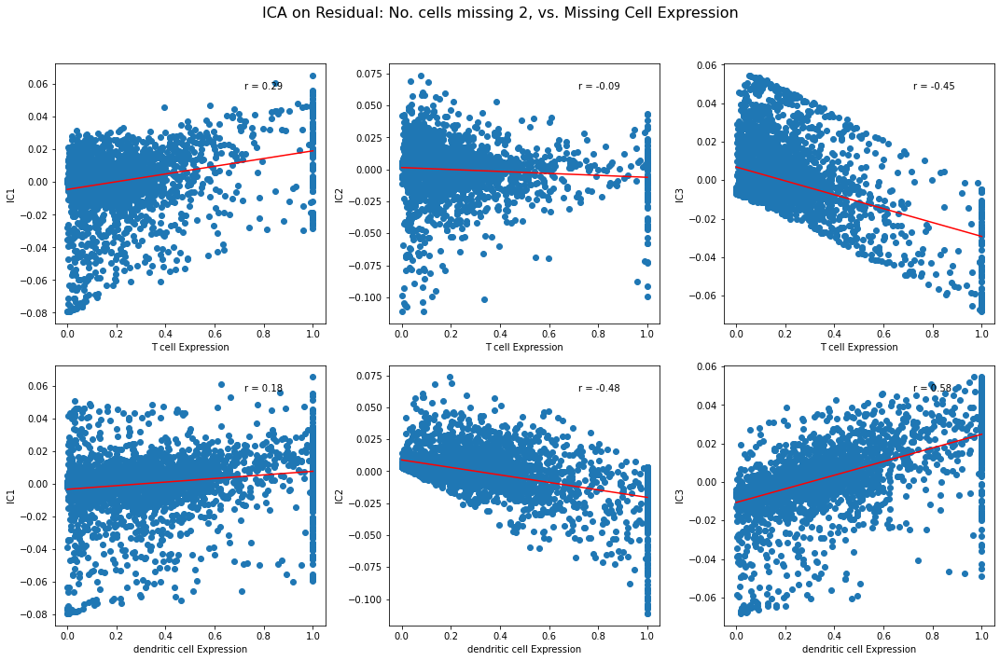

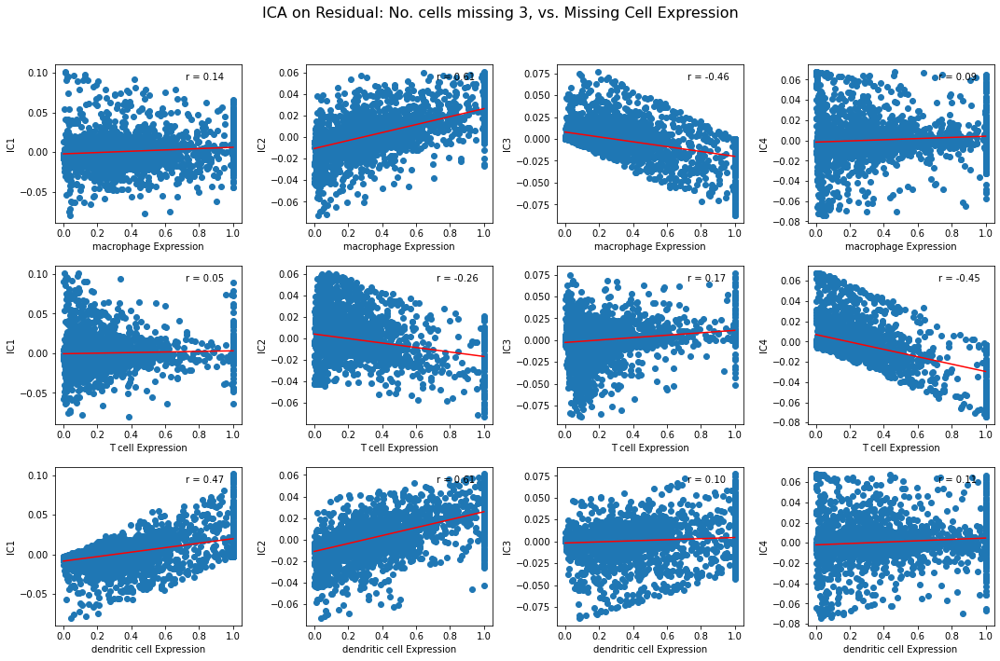

In [150]:
#ICA on residual, ICA by gene, not by sample.
# compared to the reference expression of missing cell types.
for num in num_cells_missing[1:]:
    num_ica = num + 1
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:
        num_rows = len(missing_cell_exp_usedref[num].columns) 
    num_cols = num_ica
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'ICA on Residual: No. cells missing {num}, vs. Missing Cell Expression', fontsize=16)
    # iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_exp_usedref[num].columns):
        for j in range(num_ica):
            x = list(missing_cell_exp_usedref[num][cell_type])
            y = list(res_ica_realref[num][j])
            # use the current subplot for plotting
            ax = axes[i, j]
            # scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Expression')
            ax.set_ylabel(f'IC{j + 1}')
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')
    # adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#If ICA works in seprating missing cell types, we expect one row (cell type) to only be post. correlated to on column (factor)   

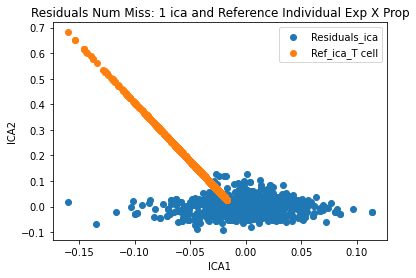

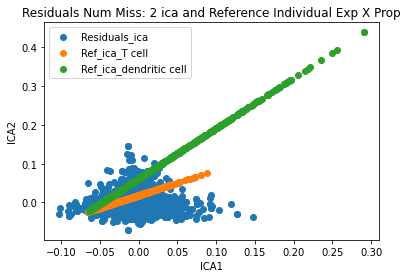

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


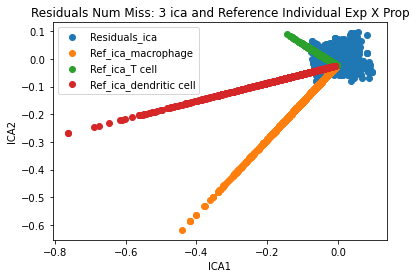

In [151]:
#ICA with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    ica = FastICA(n_components = 4)
    pseudos_ica = ica.fit_transform(residuals_realref[num])
    plt.scatter(pseudos_ica[:,0], pseudos_ica[:,1], label = "Residuals_ica" )
    for cell in cells_dict:
        ref_ica = ica.transform(cells_dict[cell])
        plt.scatter(ref_ica[:,0], ref_ica[:,1], label = f"Ref_ica_{cell}" )
    plt.title(f"Residuals Num Miss: {num} ica and Reference Individual Exp X Prop")
    plt.xlabel("ICA1")
    plt.ylabel("ICA2")
    plt.legend()
    plt.show()

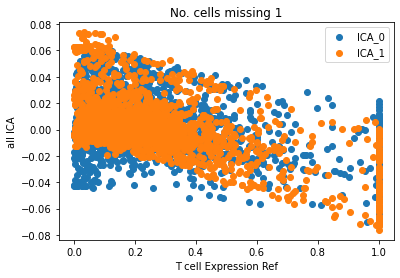

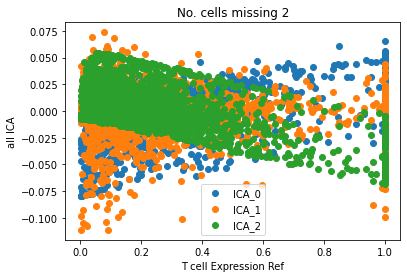

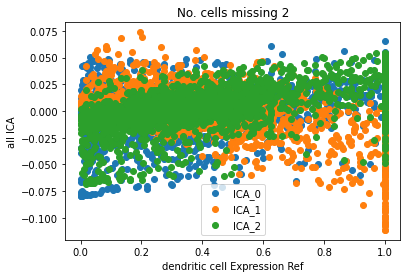

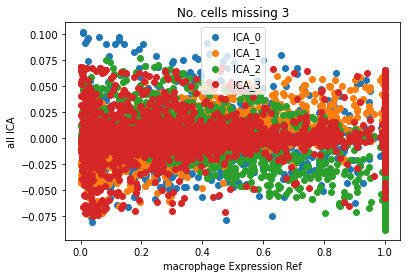

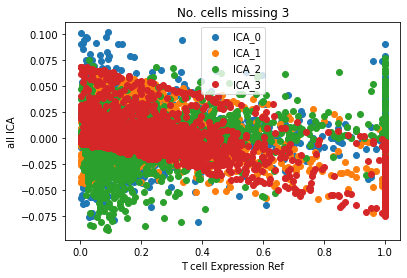

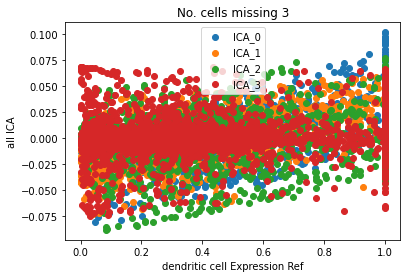

In [152]:
#all ICs with missing cells expression reference.
for num in num_missing_cells[1:]:
    res_ica_all = res_ica_realref[num]
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell] #each celll
        for pc in res_ica_all.columns: #with each component.
            y = res_ica_all[pc]
            plt.scatter(x,y, label = f"ICA_{pc}")
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{cell} Expression Ref')
        plt.ylabel(f"all ICA")
        plt.legend()
        plt.show()

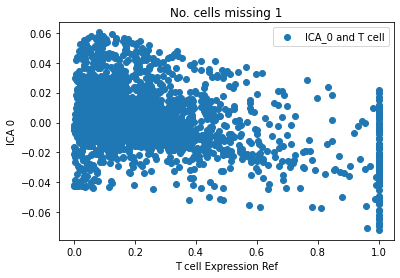

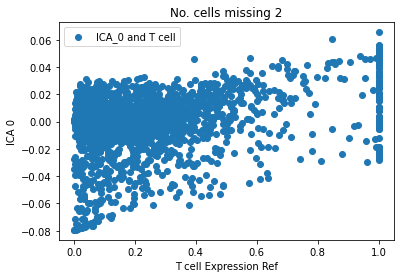

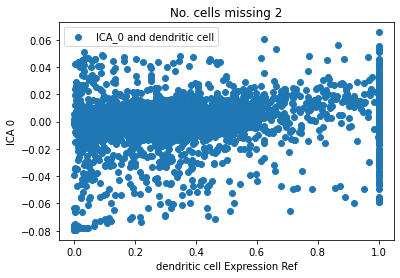

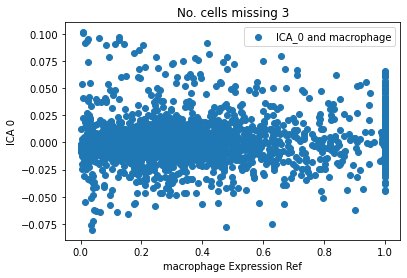

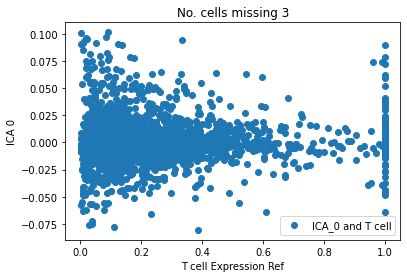

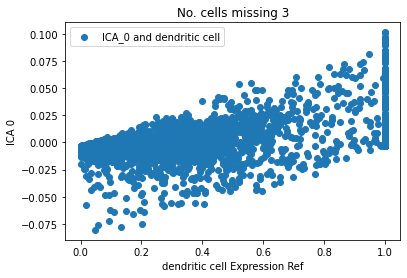

In [153]:
#each missing cell reference expression with just IC 0.
for num in num_missing_cells[1:]:
    res_ica_all = res_ica_realref[num]
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        y = res_ica_all[0]
        plt.scatter(x,y, label = f"ICA_0 and {cell}")
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{cell} Expression Ref')
        plt.ylabel(f"ICA 0")
        plt.legend()
        plt.show()

## NMF

Analyzing how close to negative the dstributions of each residual are:

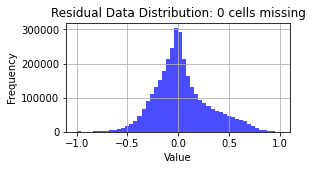

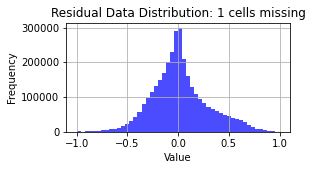

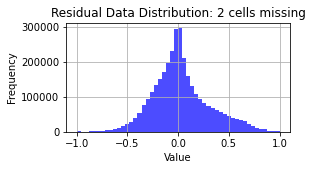

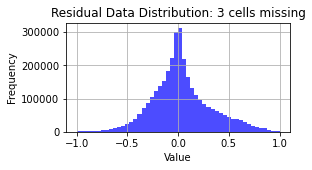

In [154]:
#distribution of residuals
for num in num_missing_cells:
    data = residuals[num].values
    plt.figure(figsize=(4, 2)) 
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual Data Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

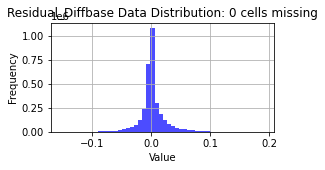

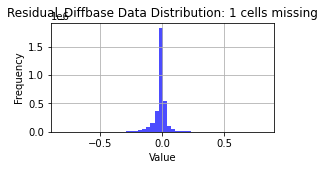

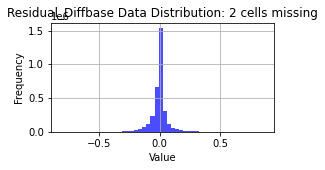

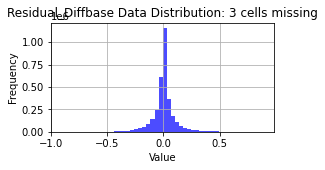

In [155]:
#distribution of residuals
for num in num_missing_cells:
    data = residuals_diffbase[num].values
    plt.figure(figsize=(4, 2)) 
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual_Diffbase Data Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

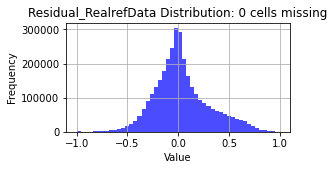

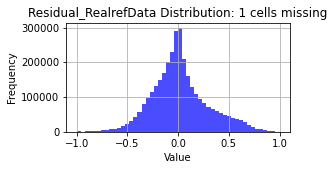

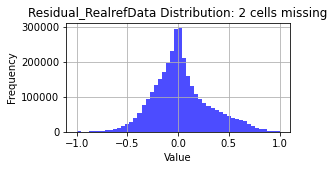

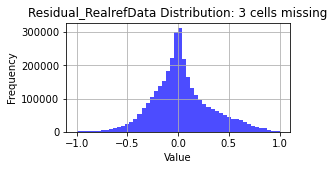

In [156]:
#distribution of residuals
for num in num_missing_cells:
    data = residuals[num].values
    plt.figure(figsize=(4, 2)) 
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual_RealrefData Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

Shifting distributions according to above plots, and calculating NMF:

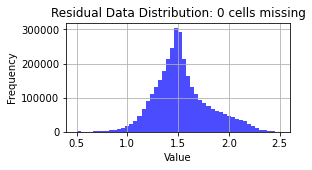

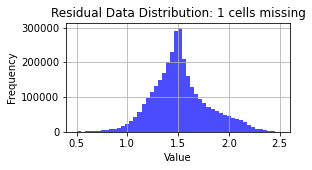

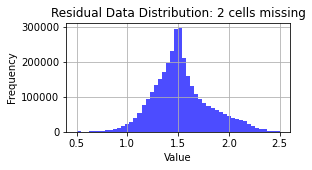

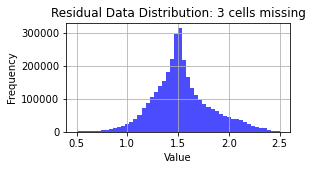

In [157]:
#shifting distribution of residuals to do NMF
residuals_shift = dict()
for num in num_missing_cells:
    residuals_shift[num] = residuals[num] + 1.5
    data = residuals_shift[num].values
    plt.figure(figsize=(4, 2)) 
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual Data Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

In [158]:
#nmf on residual 1
res_nmf = dict()
for num in num_missing_cells:
    num_nmf = num +1
    nmf = NMF(n_components = num_nmf)
    res_nmf_df = nmf.fit_transform(residuals_shift[num])
    res_nmf_df = pd.DataFrame(res_nmf_df)
    res_nmf[num] = res_nmf_df

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve 

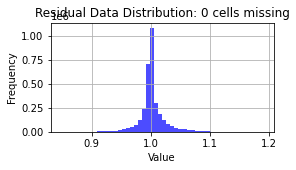

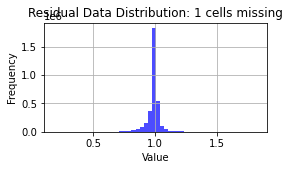

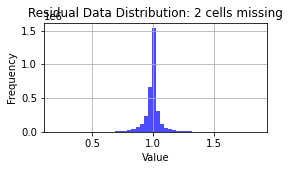

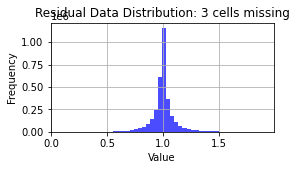

In [159]:
#shifting distribution of residuals to do NMF
residuals_shift_diffbase = dict()
for num in num_missing_cells:
    residuals_shift_diffbase[num] = residuals_diffbase[num] + 1
    data = residuals_shift_diffbase[num].values
    plt.figure(figsize=(4, 2)) 
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual Data Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

In [160]:
#nmf on residual diffbase
res_nmf_diffbase = dict()
for num in num_missing_cells:
    num_nmf = num +1
    nmf = NMF(n_components = num_nmf)
    res_nmf_df = nmf.fit_transform(residuals_shift_diffbase[num])
    res_nmf_df = pd.DataFrame(res_nmf_df)
    res_nmf_diffbase[num] = res_nmf_df

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samp

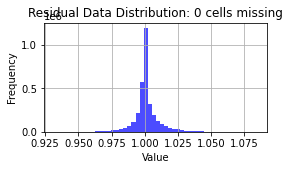

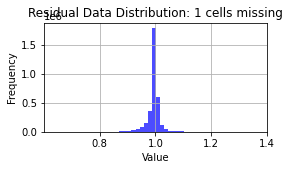

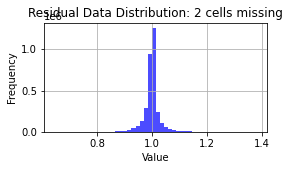

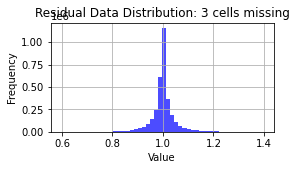

In [161]:
#shifting distribution of residuals to do NMF
residuals_shift_realref = dict()
for num in num_missing_cells:
    residuals_shift_realref[num] = residuals_realref[num] + 1
    data = residuals_shift_realref[num].values
    plt.figure(figsize=(4, 2)) 
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual Data Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

In [162]:
#nmf on residual realref
res_nmf_realref = dict()
for num in num_missing_cells:
    num_nmf = num +1
    nmf = NMF(n_components = num_nmf)
    res_nmf_df = nmf.fit_transform(residuals_shift_realref[num])
    res_nmf_df = pd.DataFrame(res_nmf_df)
    res_nmf_realref[num] = res_nmf_df

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samp

Analyzing NMF Results:

Residual

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


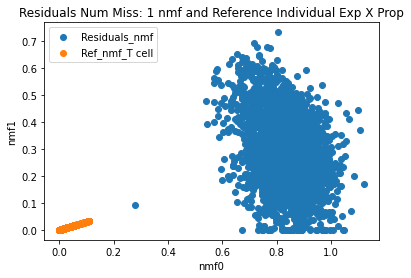

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


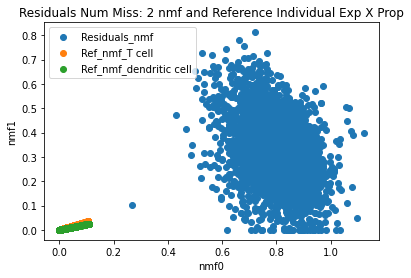

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


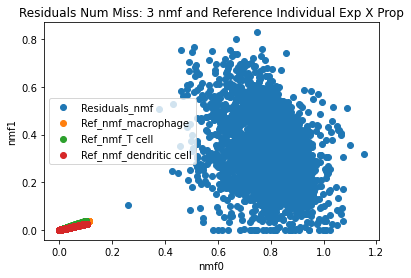

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


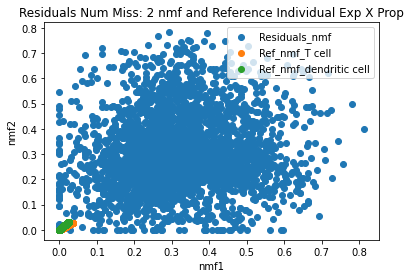

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


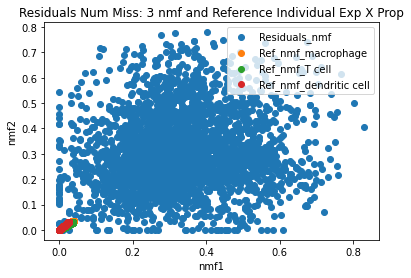

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


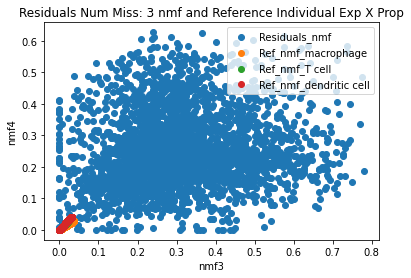

In [163]:
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num +1)
    pseudos_nmf = nmf.fit_transform(residuals_shift[num].T)
    plt.scatter(pseudos_nmf[:,0], pseudos_nmf[:,1], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,0], ref_nmf[:,1], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf0")
    plt.ylabel("nmf1")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[2:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift[num].T)
    plt.scatter(pseudos_nmf[:,1], pseudos_nmf[:,2], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,1], ref_nmf[:,2], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf1")
    plt.ylabel("nmf2")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[3:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift[num].T)
    plt.scatter(pseudos_nmf[:,2], pseudos_nmf[:,3], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,2], ref_nmf[:,3], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf3")
    plt.ylabel("nmf4")
    plt.legend()
    plt.show()    

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


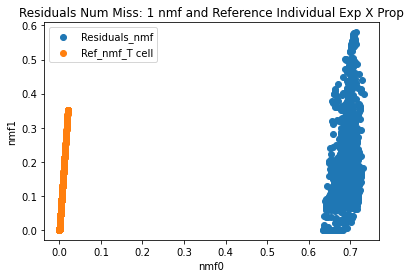

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


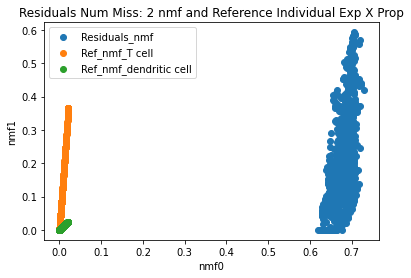

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


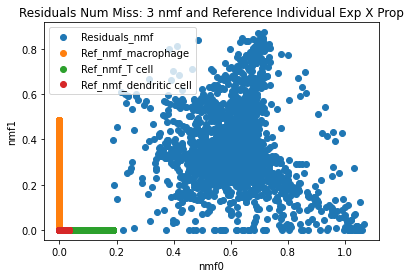

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


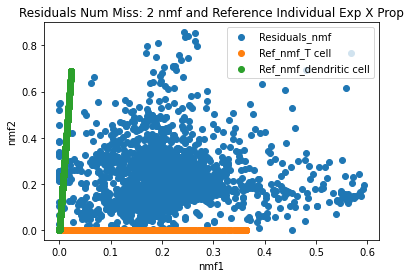

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


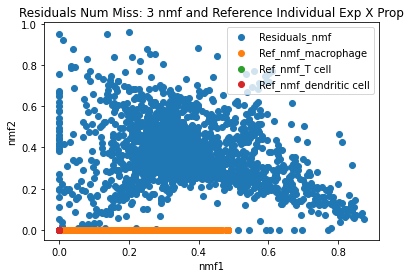

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


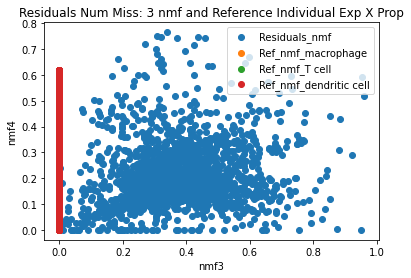

In [164]:
#nmf of residual diffbase with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num +1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,0], pseudos_nmf[:,1], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,0], ref_nmf[:,1], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf0")
    plt.ylabel("nmf1")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[2:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,1], pseudos_nmf[:,2], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,1], ref_nmf[:,2], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf1")
    plt.ylabel("nmf2")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[3:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,2], pseudos_nmf[:,3], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,2], ref_nmf[:,3], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf3")
    plt.ylabel("nmf4")
    plt.legend()
    plt.show()    

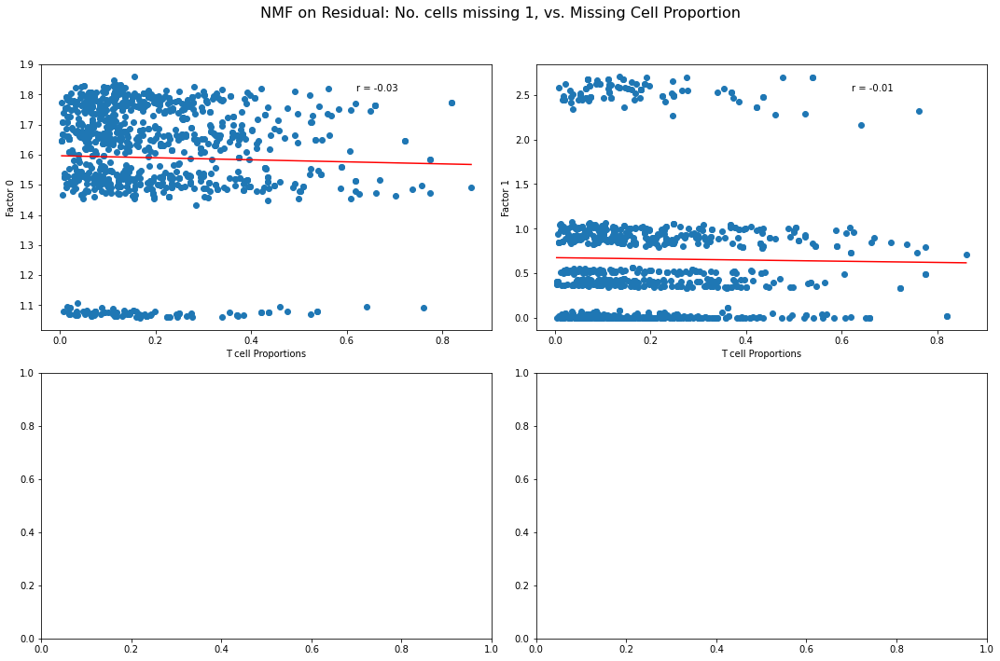

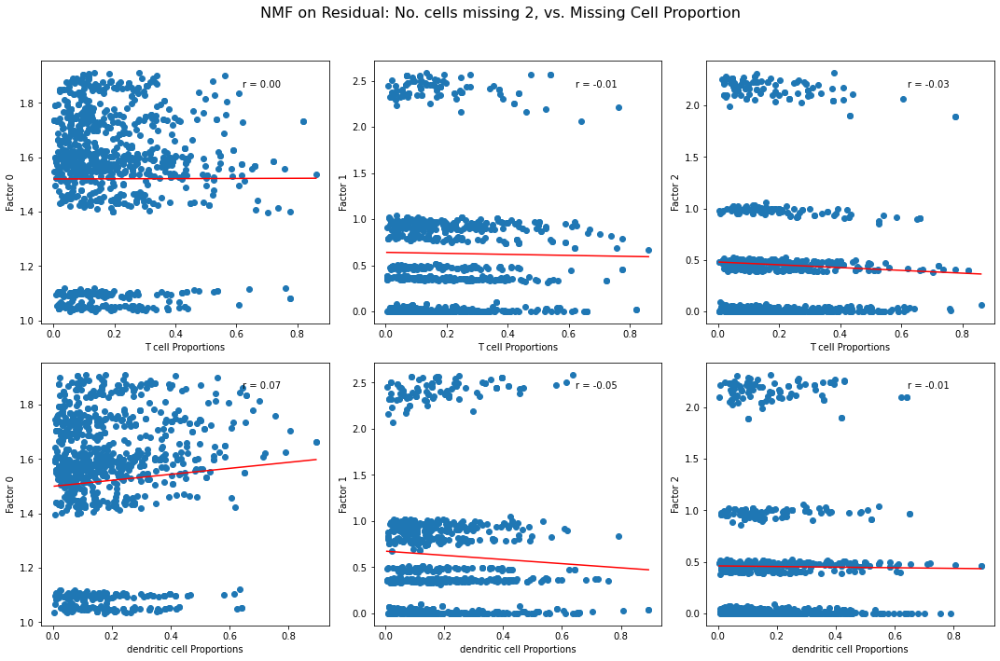

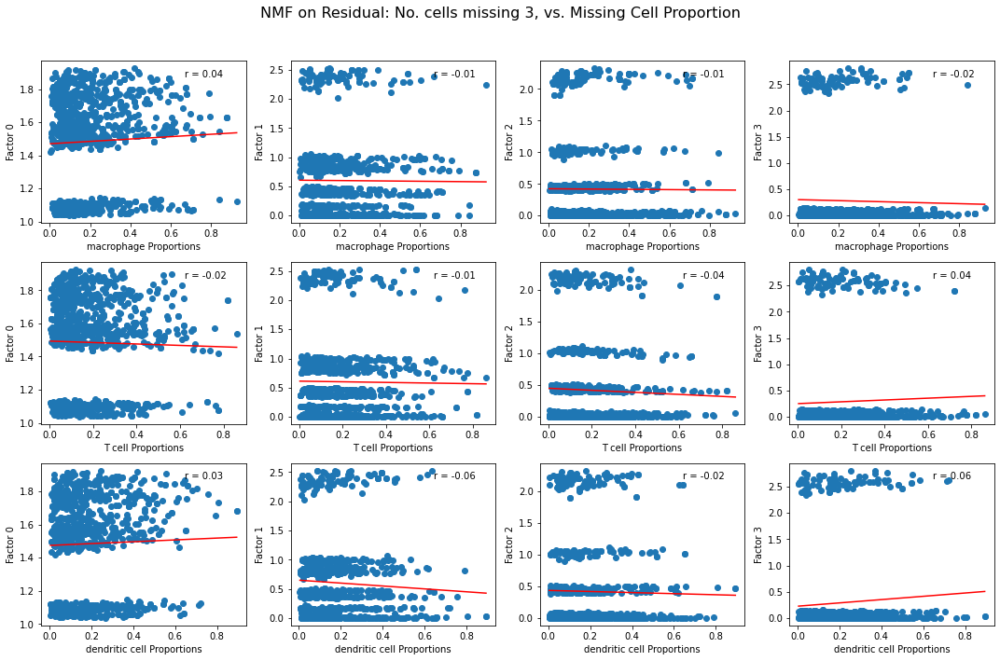

In [165]:
for num in num_missing_cells[1:]:
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:    
        num_rows = len(missing_cell_prop[num].columns) 
    num_cols = len(res_nmf[num].columns)
    # create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'NMF on Residual: No. cells missing {num}, vs. Missing Cell Proportion', fontsize=16)

    # Iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_prop[num].columns):
        for j, factor in enumerate(res_nmf[num].columns):
            x = list(missing_cell_prop[num][cell_type])
            y = list(res_nmf[num][factor])
            #use the current subplot for plotting
            ax = axes[i, j]
            #scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Proportions')
            ax.set_ylabel(f'Factor {factor}')
            
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    #adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#It is expected that only one column (factor) for each cell type (row) will be post. correlated.    

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


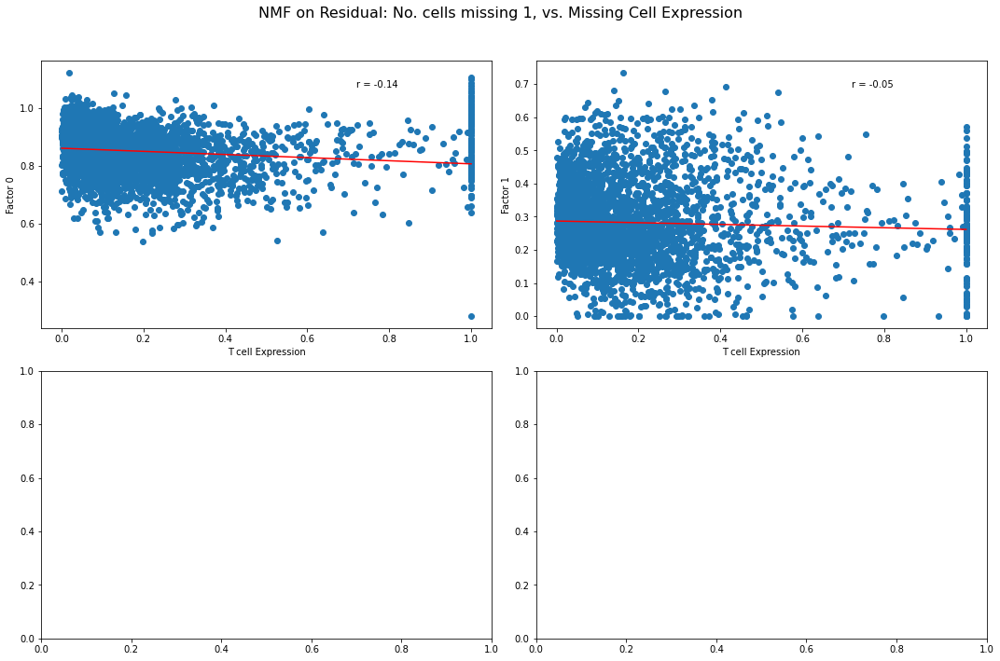

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


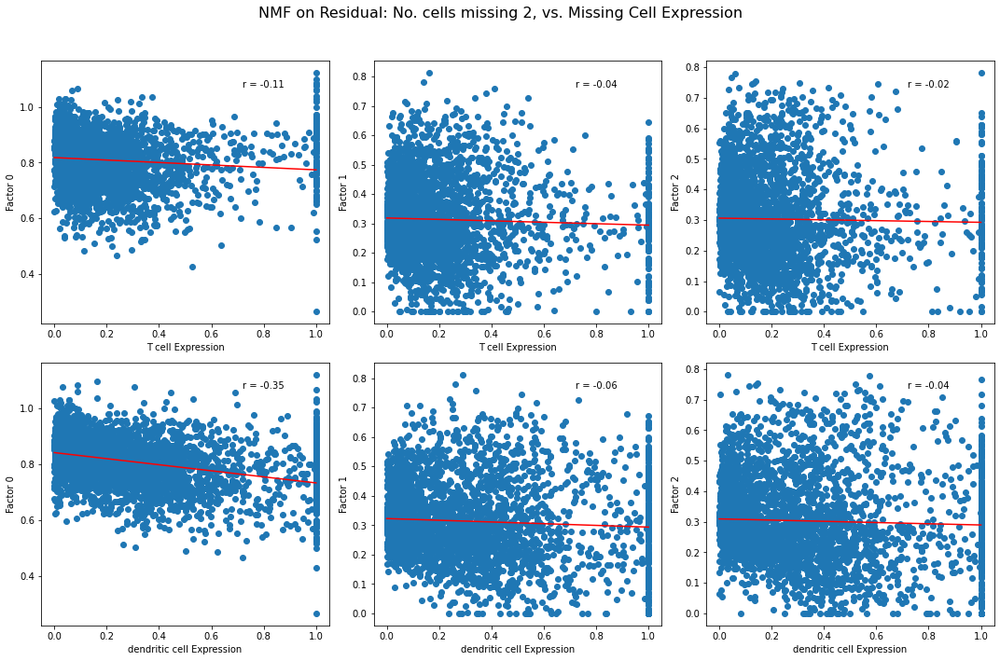

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


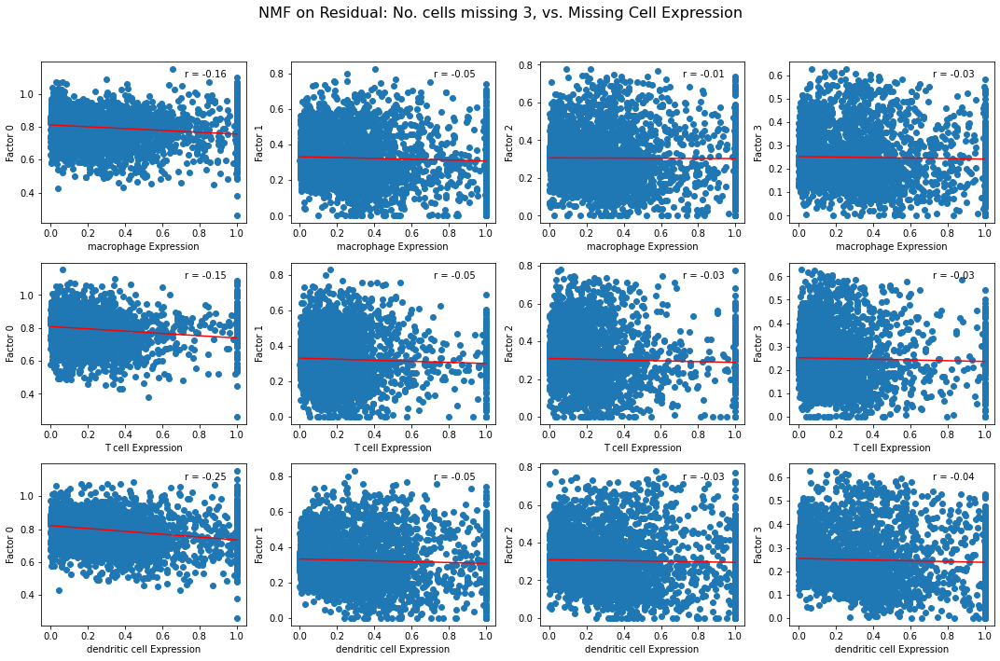

In [166]:
#now NMF with genes, compared to the reference exp. used.
for num in num_missing_cells[1:]:
    num_nmf = num +1
    nmf = NMF(n_components = num_nmf)
    res_nmf_df = nmf.fit_transform(residuals_shift[num].T)
    res_nmf_df = pd.DataFrame(res_nmf_df)
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:    
        num_rows = len(missing_cell_exp_usedref[num].columns) 
    num_cols = len(res_nmf[num].columns)
    # create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'NMF on Residual: No. cells missing {num}, vs. Missing Cell Expression', fontsize=16)

    # Iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_exp_usedref[num].columns):
        for j, factor in enumerate(res_nmf[num].columns):
            x = list(missing_cell_exp_usedref[num][cell_type])
            y = list(res_nmf_df[factor])
            #use the current subplot for plotting
            ax = axes[i, j]
            #scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Expression')
            ax.set_ylabel(f'Factor {factor}')
            
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    #adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#It is expected that only one column (factor) for each cell type (row) will be post. correlated.    

Residual_diffbase

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


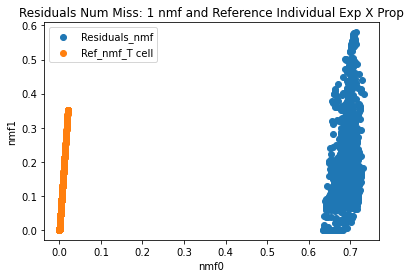

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


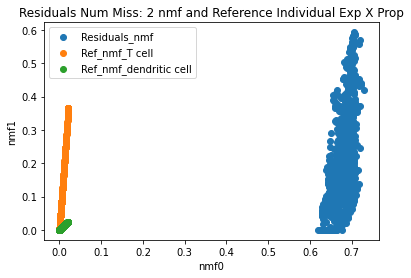

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


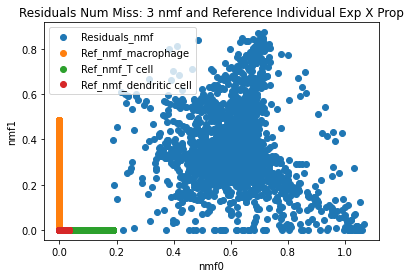

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


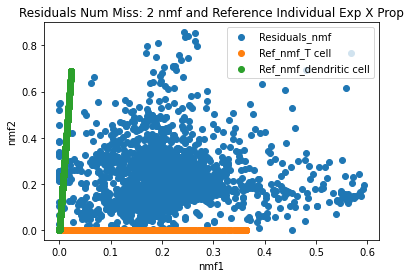

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


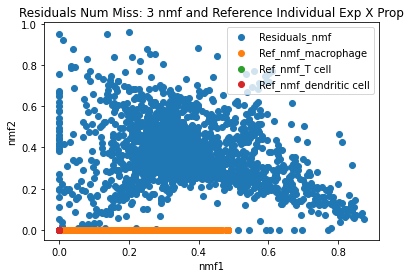

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


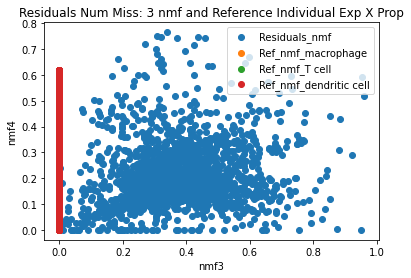

In [167]:
#nmf of residual diffbase with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num +1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,0], pseudos_nmf[:,1], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,0], ref_nmf[:,1], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf0")
    plt.ylabel("nmf1")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[2:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,1], pseudos_nmf[:,2], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,1], ref_nmf[:,2], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf1")
    plt.ylabel("nmf2")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[3:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,2], pseudos_nmf[:,3], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,2], ref_nmf[:,3], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf3")
    plt.ylabel("nmf4")
    plt.legend()
    plt.show()    

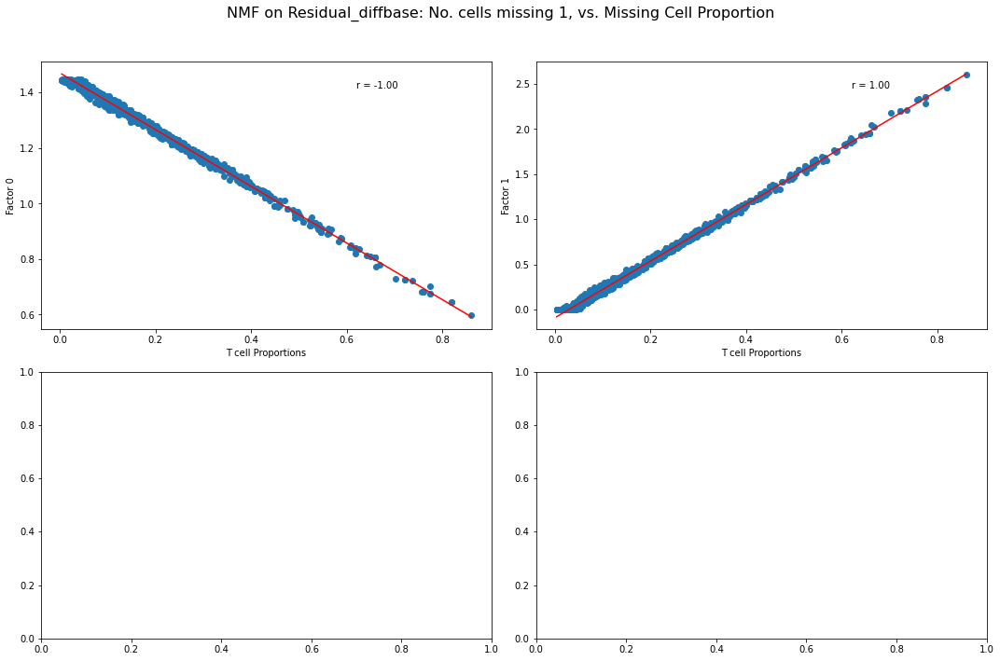

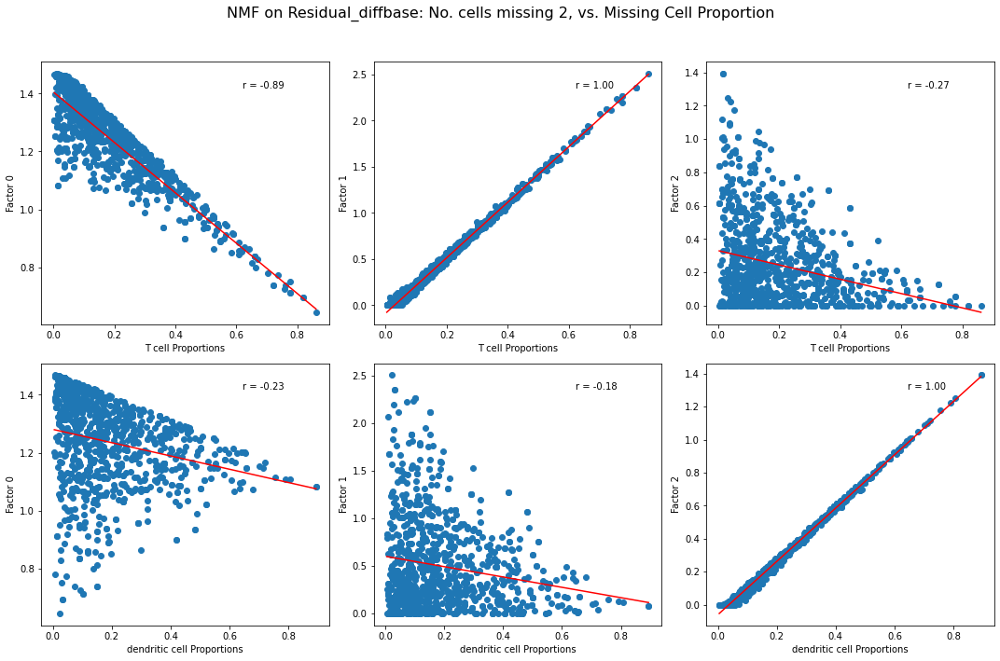

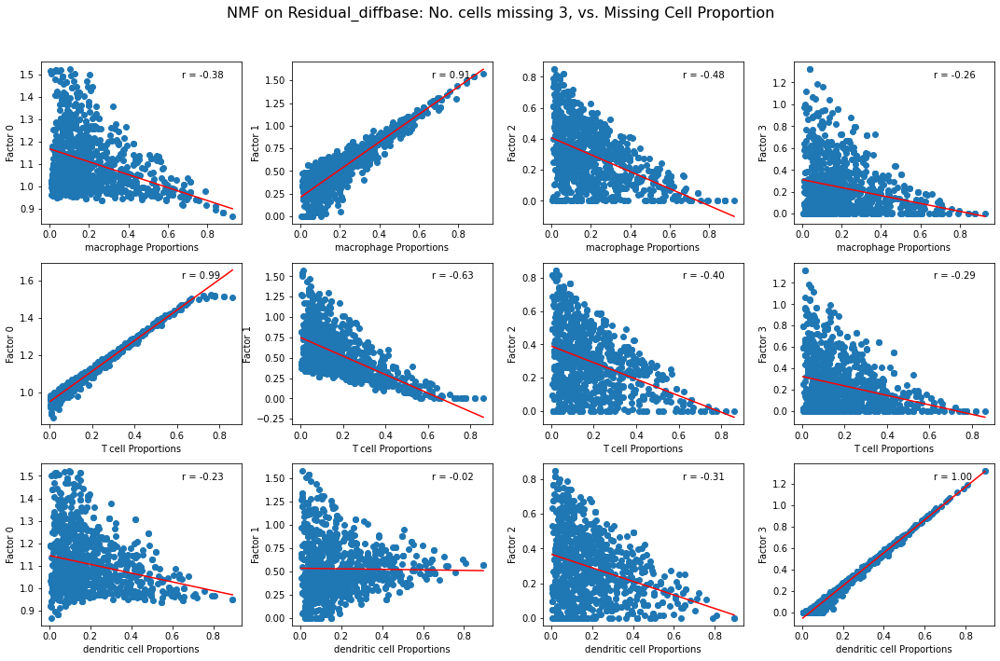

In [168]:
for num in num_missing_cells[1:]:
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:    
        num_rows = len(missing_cell_prop[num].columns) 
    num_cols = len(res_nmf_diffbase[num].columns)
    # create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'NMF on Residual_diffbase: No. cells missing {num}, vs. Missing Cell Proportion', fontsize=16)

    # Iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_prop[num].columns):
        for j, factor in enumerate(res_nmf_diffbase[num].columns):
            x = list(missing_cell_prop[num][cell_type])
            y = list(res_nmf_diffbase[num][factor])
            #use the current subplot for plotting
            ax = axes[i, j]
            #scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Proportions')
            ax.set_ylabel(f'Factor {factor}')
            
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    #adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#It is expected that only one column (factor) for each cell type (row) will be post. correlated.        

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


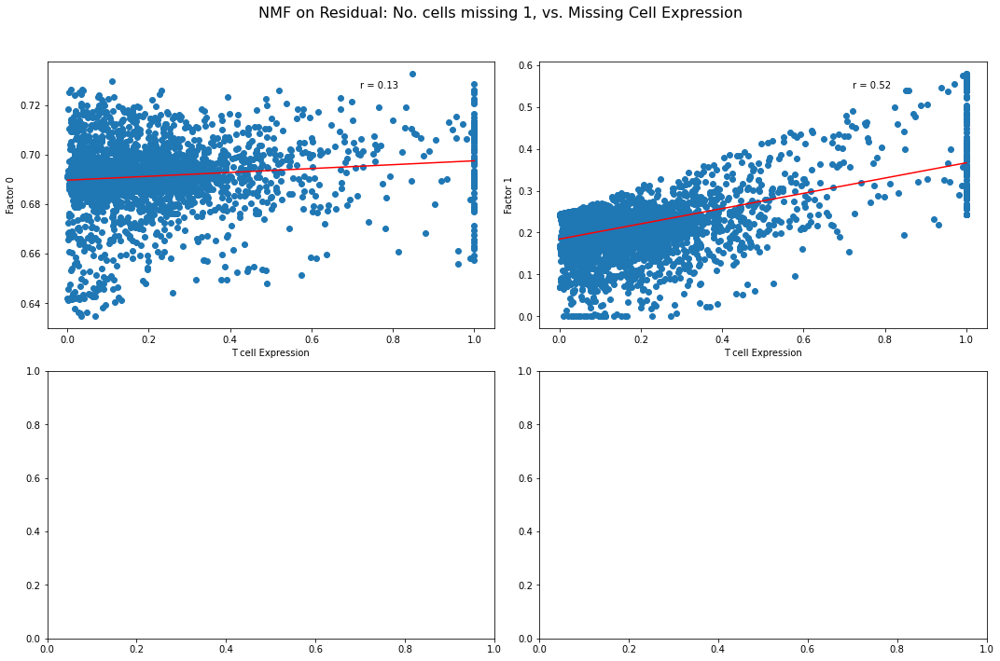

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


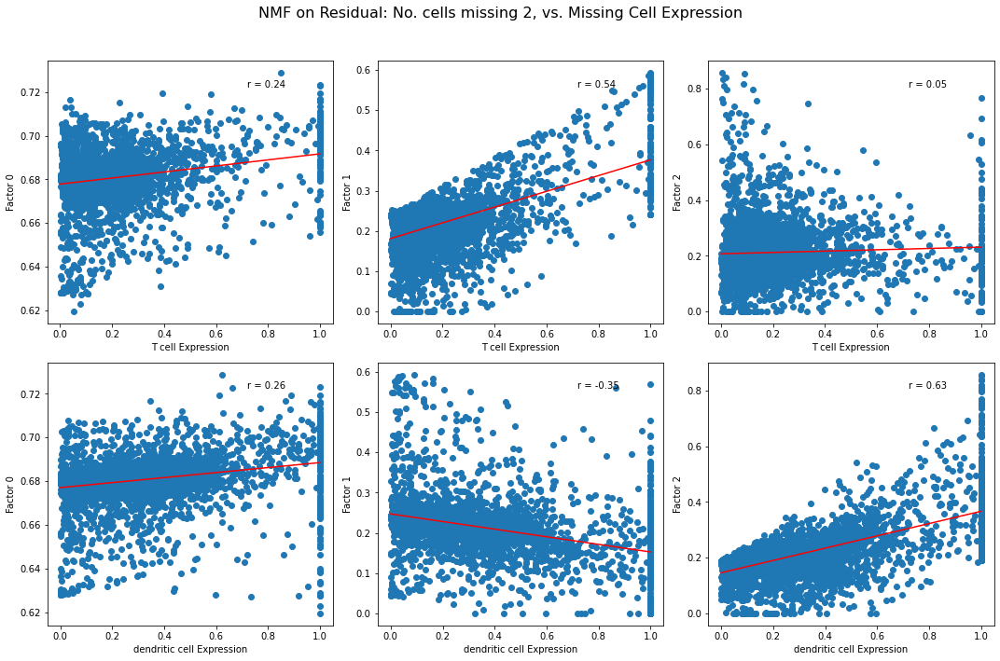

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


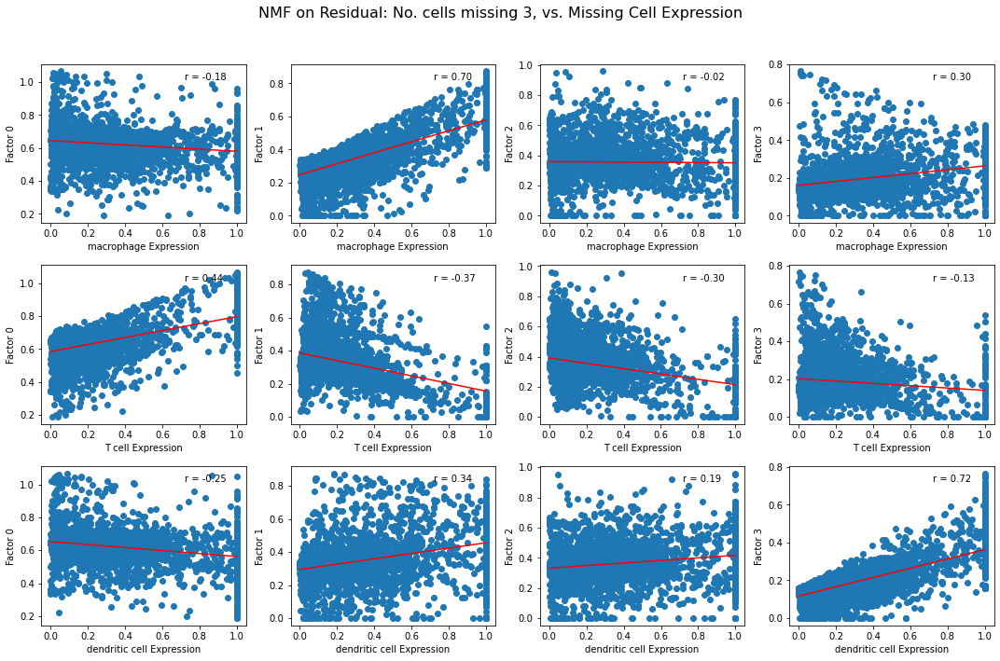

In [169]:
#now NMF with genes, compared to the reference exp. used.
for num in num_missing_cells[1:]:
    num_nmf = num +1
    nmf = NMF(n_components = num_nmf)
    res_nmf_df = nmf.fit_transform(residuals_shift_diffbase[num].T)
    res_nmf_df = pd.DataFrame(res_nmf_df)
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:    
        num_rows = len(missing_cell_exp_usedref[num].columns) 
    num_cols = len(res_nmf[num].columns)
    # create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'NMF on Residual: No. cells missing {num}, vs. Missing Cell Expression', fontsize=16)

    # Iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_exp_usedref[num].columns):
        for j, factor in enumerate(res_nmf[num].columns):
            x = list(missing_cell_exp_usedref[num][cell_type])
            y = list(res_nmf_df[factor])
            #use the current subplot for plotting
            ax = axes[i, j]
            #scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Expression')
            ax.set_ylabel(f'Factor {factor}')
            
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    #adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#It is expected that only one column (factor) for each cell type (row) will be post. correlated.    

Residual_realref

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


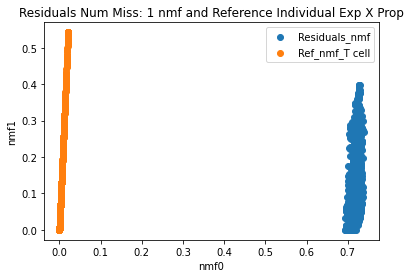

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


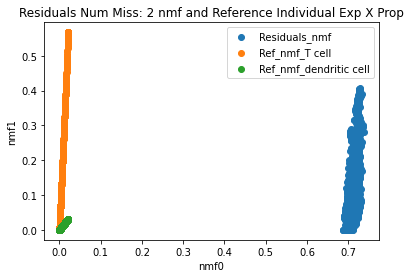

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


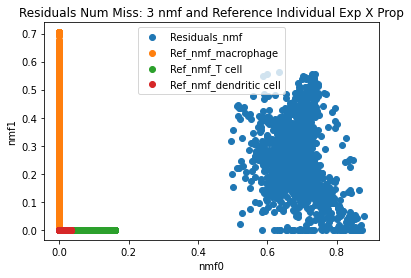

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


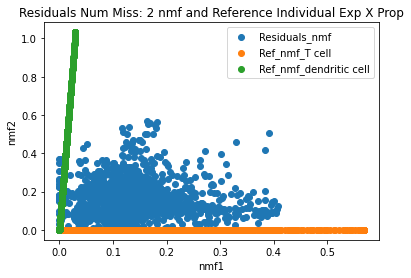

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


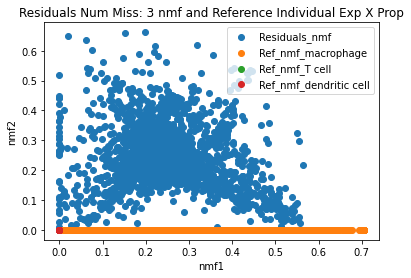

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


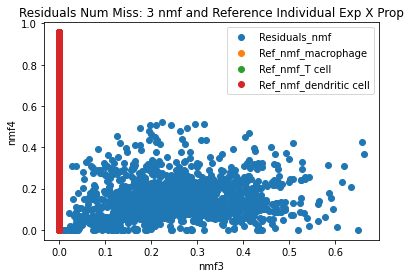

In [170]:
#nmf of residual realref with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num +1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_realref[num].T)
    plt.scatter(pseudos_nmf[:,0], pseudos_nmf[:,1], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,0], ref_nmf[:,1], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf0")
    plt.ylabel("nmf1")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[2:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_realref[num].T)
    plt.scatter(pseudos_nmf[:,1], pseudos_nmf[:,2], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,1], ref_nmf[:,2], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf1")
    plt.ylabel("nmf2")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[3:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_realref[num].T)
    plt.scatter(pseudos_nmf[:,2], pseudos_nmf[:,3], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,2], ref_nmf[:,3], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf3")
    plt.ylabel("nmf4")
    plt.legend()
    plt.show()    

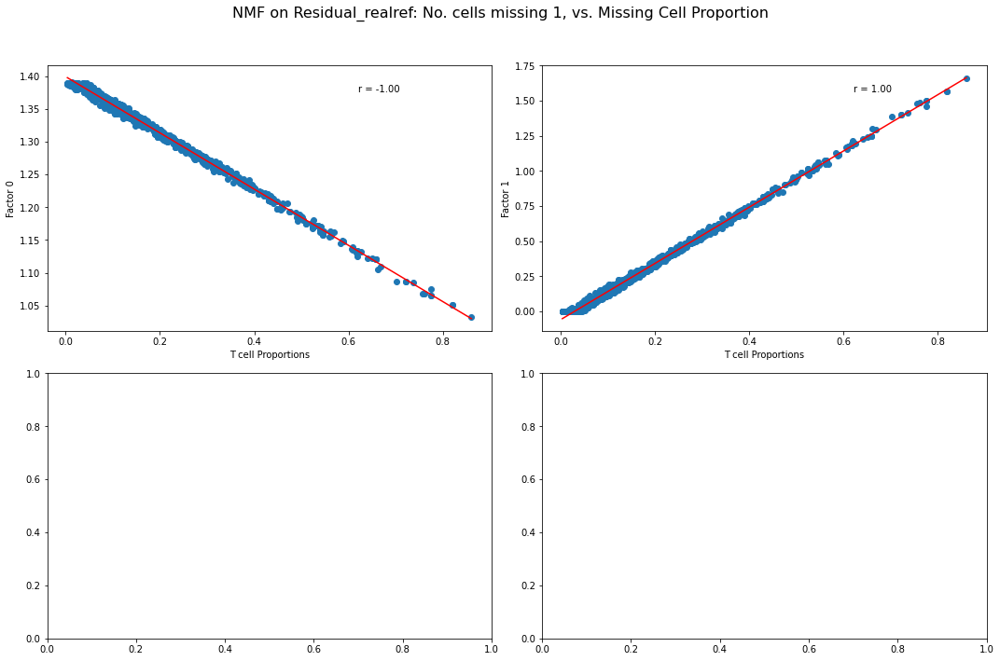

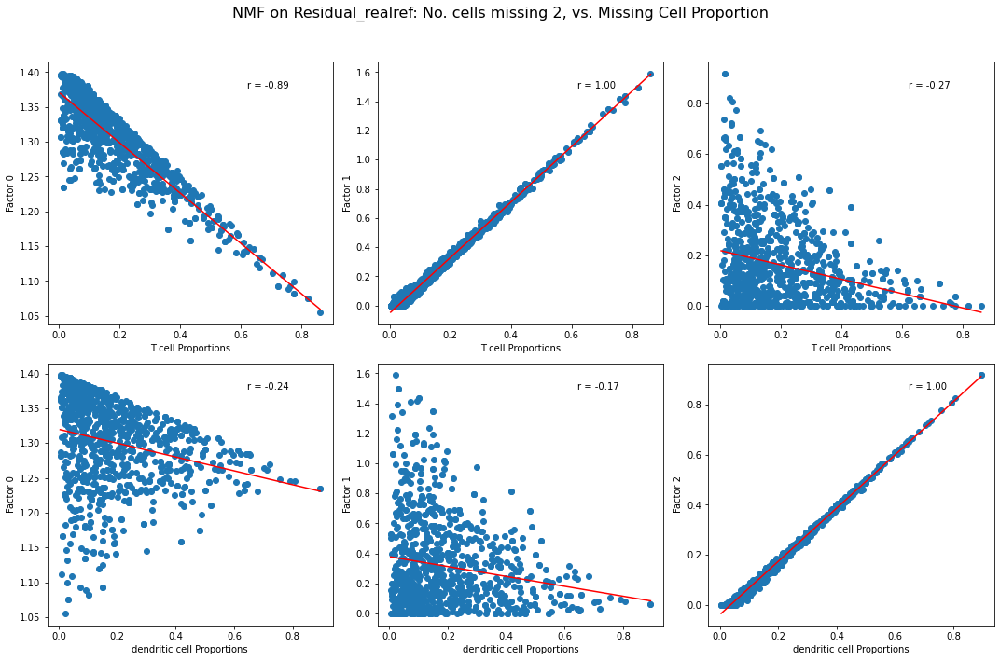

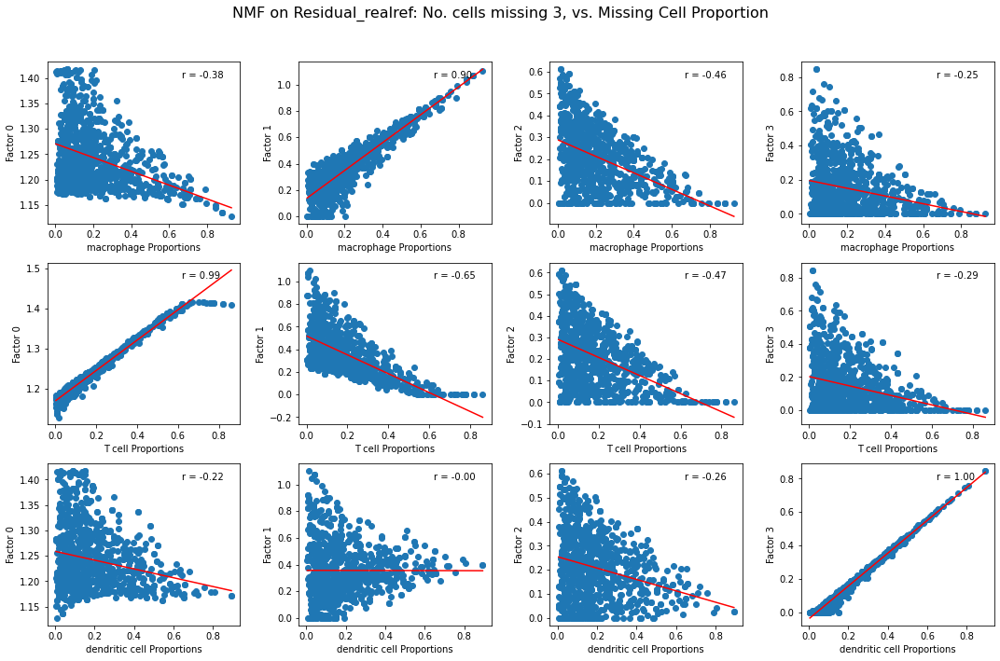

In [171]:
for num in num_missing_cells[1:]:
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:    
        num_rows = len(missing_cell_prop[num].columns) 
    num_cols = len(res_nmf_realref[num].columns)
    # create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'NMF on Residual_realref: No. cells missing {num}, vs. Missing Cell Proportion', fontsize=16)

    # Iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_prop[num].columns):
        for j, factor in enumerate(res_nmf_realref[num].columns):
            x = list(missing_cell_prop[num][cell_type])
            y = list(res_nmf_realref[num][factor])
            #use the current subplot for plotting
            ax = axes[i, j]
            #scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Proportions')
            ax.set_ylabel(f'Factor {factor}')
            
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    #adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#It is expected that only one column (factor) for each cell type (row) will be post. correlated.        

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


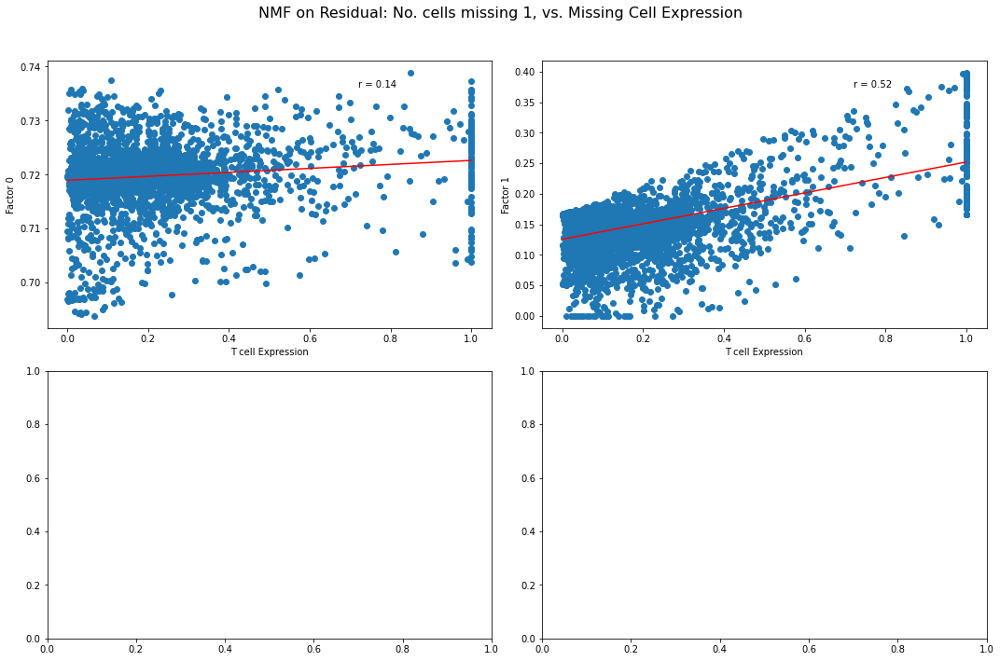

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


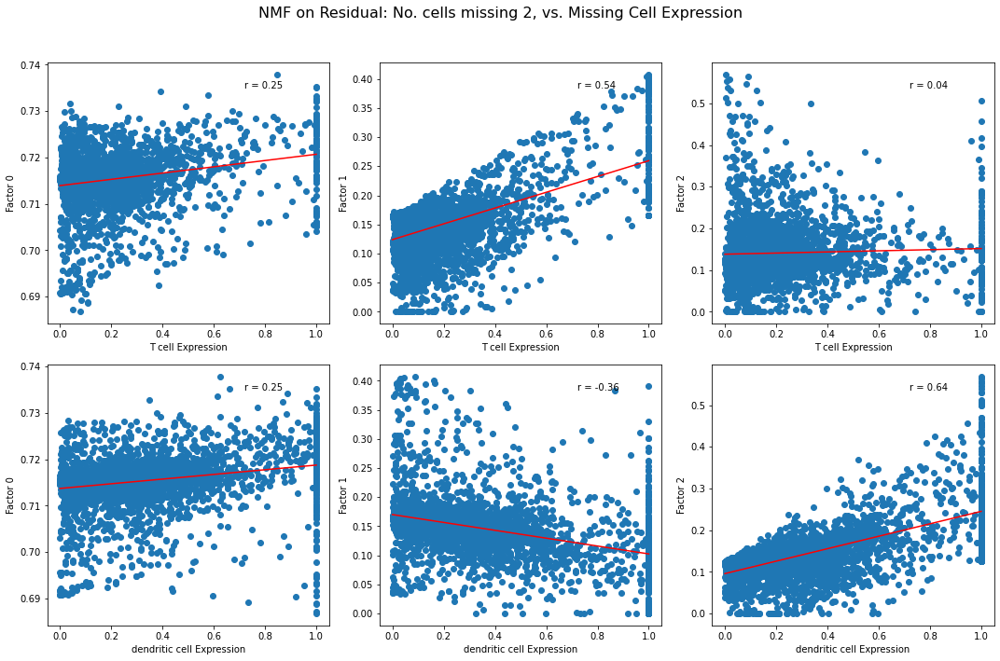

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


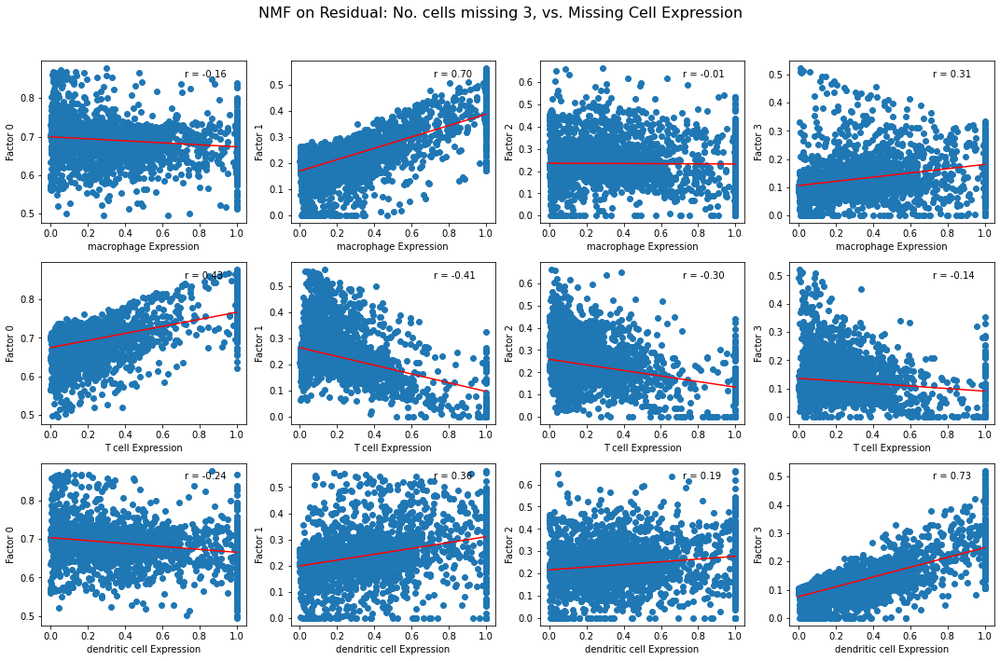

In [172]:
#now NMF with genes, compared to the reference exp. used.
for num in num_missing_cells[1:]:
    num_nmf = num +1
    nmf = NMF(n_components = num_nmf)
    res_nmf_df = nmf.fit_transform(residuals_shift_realref[num].T)
    res_nmf_df = pd.DataFrame(res_nmf_df)
    # define the number of rows and columns for the grid layout
    if num == 1:
        num_rows = 2
    else:    
        num_rows = len(missing_cell_exp_usedref[num].columns) 
    num_cols = len(res_nmf[num].columns)
    # create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))
    fig.suptitle(f'NMF on Residual: No. cells missing {num}, vs. Missing Cell Expression', fontsize=16)

    # Iterate over cell types and factors
    for i, cell_type in enumerate(missing_cell_exp_usedref[num].columns):
        for j, factor in enumerate(res_nmf[num].columns):
            x = list(missing_cell_exp_usedref[num][cell_type])
            y = list(res_nmf_df[factor])
            #use the current subplot for plotting
            ax = axes[i, j]
            #scatter plot
            ax.scatter(x, y)
            ax.set_xlabel(f'{cell_type} Expression')
            ax.set_ylabel(f'Factor {factor}')
            
            #calculate and display Pearson's correlation coefficient
            r, p = stats.pearsonr(x, y)
            ax.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            #add a regression line
            ax.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color='red')

    #adjust spacing between subplots
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
#It is expected that only one column (factor) for each cell type (row) will be post. correlated.    